# Libraries, data and installs

In [1]:
import tensorflow as tf
tf.config.list_physical_devices("GPU")


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [1]:
#!pip3 install visualkeras
!pip3 install -U numpy==1.18.5


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 10.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for numpy (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for numpy
Failed to build numpy
ERROR: Could not build wheels for numpy, which is required to install pyproject.toml-based projects


In [12]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from keras.layers import Input, Dense, Dropout
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Add, Multiply
from keras.layers import ELU, PReLU, LeakyReLU
from keras.models import Model
from keras.utils.vis_utils import plot_model
from tensorflow.keras import optimizers
from keras.optimizers import SGD
from keras.optimizers import Adagrad
from keras import metrics
from sklearn.metrics import r2_score
from keras.callbacks import EarlyStopping
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers.experimental.preprocessing import Normalization
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.densenet import DenseNet121

from tensorflow.keras.layers import GlobalAveragePooling2D


from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import math as m
import numpy as np
import seaborn as sns
sns.set_style("darkgrid")
edgecolors=None



In [1]:
'''
Nomenclature:

<DATASET-INITIALS><FRUIT-INITIAL><TEST-INITIAL>.csv|.pkl

DATASET-INITIALS:
CG = Classic Geometry
F = Form
C = Color
A = All
CI = Cropped Images

FRUIT-INITIAL:
B = Blueberry
R = Raspberry
S = Strawberry

TEST-INITIAL:
R = Raw
Y = YOLO
D = Detectron2

---------------------

EXAMPLES

CLASSIC GEOMETRY of RASPBERRIES from RAW test
CGRR.csv

CROPPED IMAGES of BLUEBERRIES from YOLO test
CIBY.pkl

---------------------

Cropped images are the only datasets that are saved in a pickle file


'''

#-----------------Blueberries------------------
###############################################
#Blueberries - RAW
#ClassicGeometry
!wget -O CGBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
#Form
!wget -O FBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
#Color
!wget -O CBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsBlueberriesRaw.csv
#All
!wget -O ABR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesBlueberriesRaw.csv
#Images
!wget -O CIBR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesRaw.pkl
###############################################
#Blueberries - YOLO
#ClassicGeometry
!wget -O CGBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLOBlue.csv
#Form
!wget -O FBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLOBlue.csv
#Color
!wget -O CBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLOBlue.csv
#All
!wget -O ABY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLOBlue.csv
#Images
!wget -O CIBY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesYOLO.pkl
###############################################
#Blueberries - Detectron2
#ClassicGeometry
!wget -O CGBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2blue.csv
#Form
!wget -O FBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2blue.csv
#Color
!wget -O CBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2blue.csv
#All
!wget -O ABD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2blue.csv
#Images
!wget -O CIBD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Raspberries------------------
###############################################
#Raspberries - RAW
#ClassicGeometry
!wget -O CGRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryRaspberriesRaw.csv
#Form
!wget -O FRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsRaspberriesRaw.csv
#Color
!wget -O CRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsRaspberriesRaw.csv
#All
!wget -O ARR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesRaspberriesRaw.csv
#Images
!wget -O CIRR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesRaw.pkl
###############################################
#Raspberries - YOLO
#ClassicGeometry
!wget -O CGRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLORasp.csv
#Form
!wget -O FRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLORasp.csv
#Color
!wget -O CRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLORasp.csv
#All
!wget -O ARY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLORasp.csv
#Images
!wget -O CIRY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesYOLO.pkl
###############################################
#Raspberries - Detectron2
#ClassicGeometry
!wget -O CGRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2rasp.csv
#Form
!wget -O FRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2rasp.csv
#Color
!wget -O CRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2rasp.csv
#All
!wget -O ARD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2rasp.csv
#Images
!wget -O CIRD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Strawberries------------------
###############################################
#Strawberries - RAW
#ClassicGeometry
!wget -O CGSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesRaw.csv
#Form
!wget -O FSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesRaw.csv
#Color
!wget -O CSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesRaw.csv
#All
!wget -O ASR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesRaw.csv
#Images
!wget -O CISR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesRaw.pkl
###############################################
#Strawberries - YOLO
#ClassicGeometry
!wget -O CGSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesYOLO.csv
#Form
!wget -O FSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesYOLO.csv
#Color
!wget -O CSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesYOLO.csv
#All
!wget -O ASY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesYOLO.csv
#Images
!wget -O CISY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesYOLO.pkl
###############################################
#Strawberries - Detectron2
#ClassicGeometry
!wget -O CGSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2straw.csv
#Form
!wget -O FSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2straw.csv
#Color
!wget -O CSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2straw.csv
#All
!wget -O ASD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2straw.csv
#Images
!wget -O CISD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================

%mkdir figures


--2023-05-02 00:20:06--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8002::154, 2606:50c0:8003::154, 2606:50c0:8000::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8002::154|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3559 (3.5K) [text/plain]
Saving to: ‘CGBR.csv’

CGBR.csv            100%[===================>]   3.48K  --.-KB/s    in 0.001s  

2023-05-02 00:20:06 (2.84 MB/s) - ‘CGBR.csv’ saved [3559/3559]

--2023-05-02 00:20:06--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8003::154, 2606:50c0:8000::154, 2606:50c0:8001::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8003::154|:443... connected.
HTTP request sent, awaiting re

# Data analysis

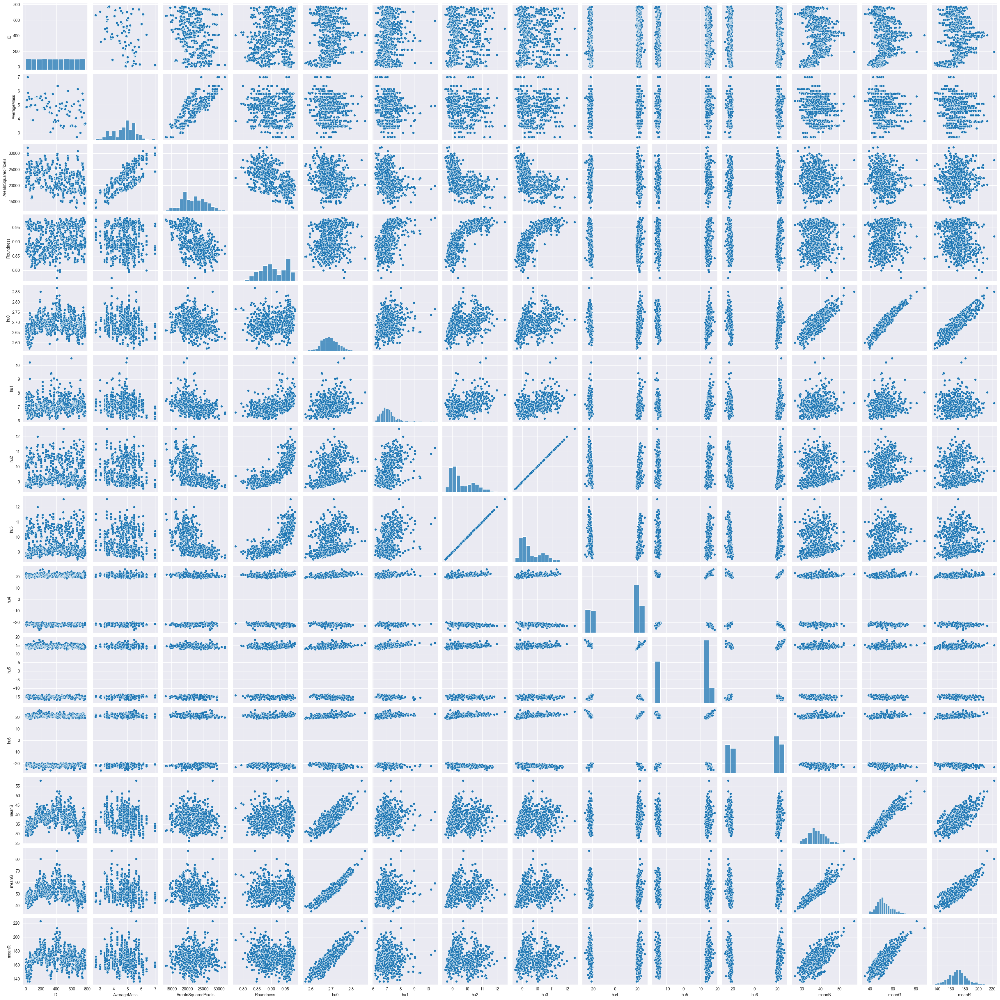

In [5]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")

sns.pairplot(testdf)


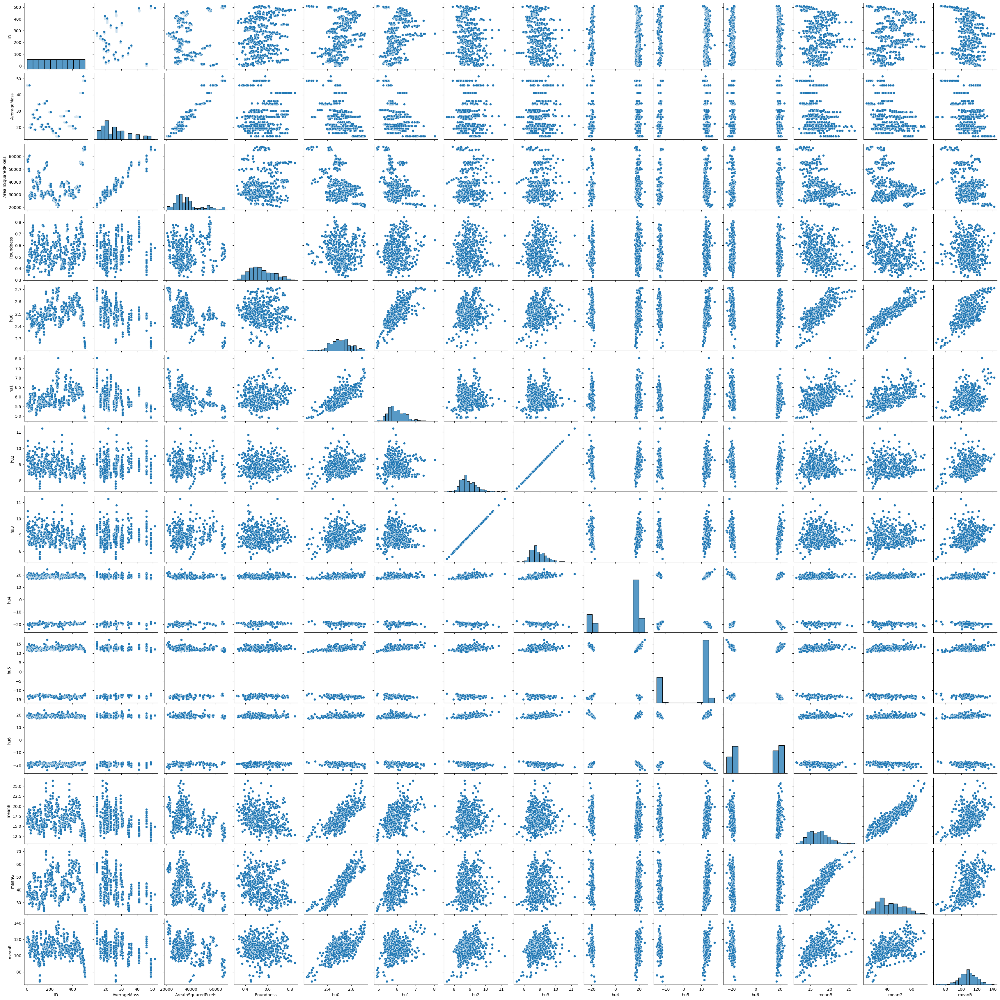

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

sns.pairplot(testdf)


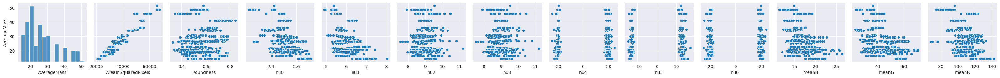

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

testdf = testdf.drop(['ID'], axis=1)

pp = sns.pairplot(data=testdf,
                  y_vars=['AverageMass'])

plt.savefig("./figures/StrawberriesPairplotAverageMass", dpi=300)




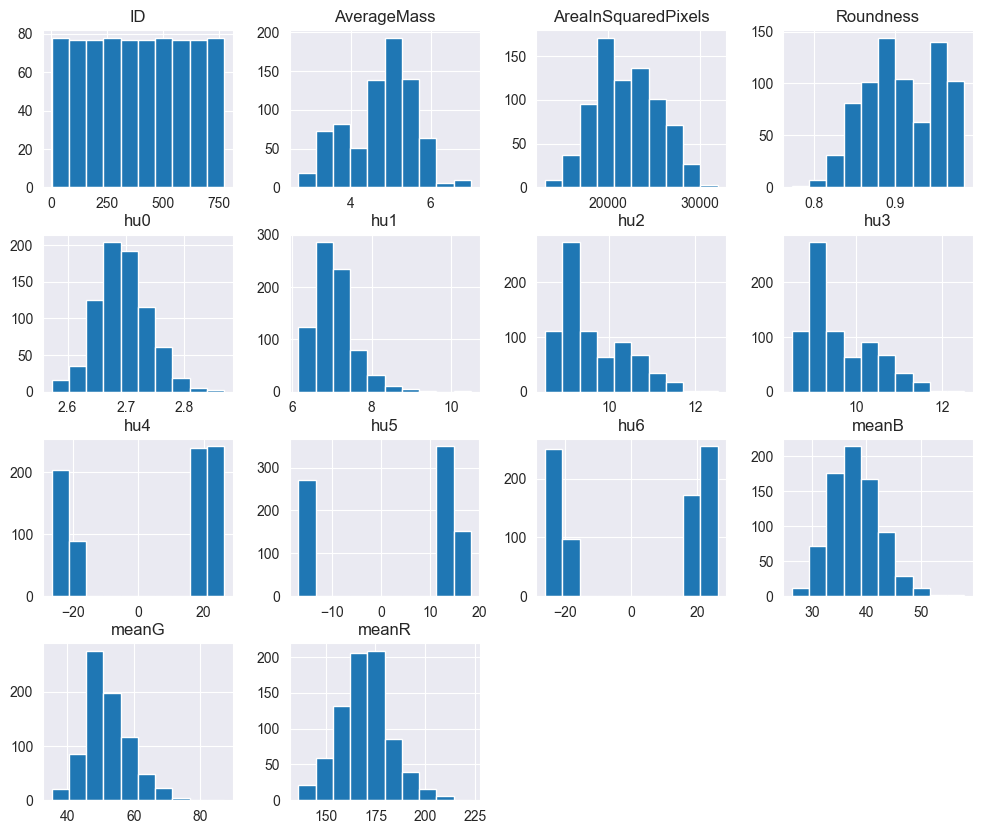

In [6]:
testdf.hist(figsize = (12,10))
plt.show()

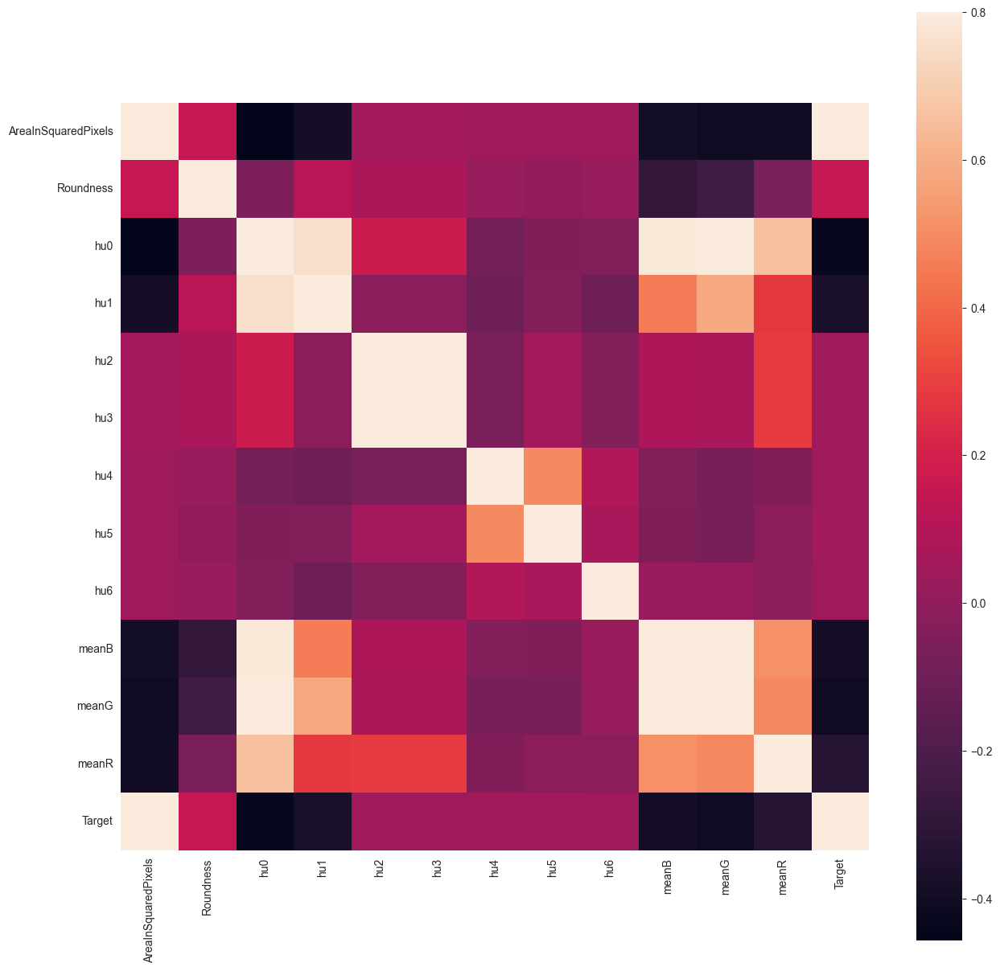

In [7]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)

testdf['Target'] = testdf['AverageMass']
testdf = testdf.drop(["AverageMass"], axis = 1)
C_mat = testdf.corr()
fig = plt.figure(figsize = (15,15))

sns.heatmap(C_mat, vmax = .8, square = True)
plt.show()

<AxesSubplot: >

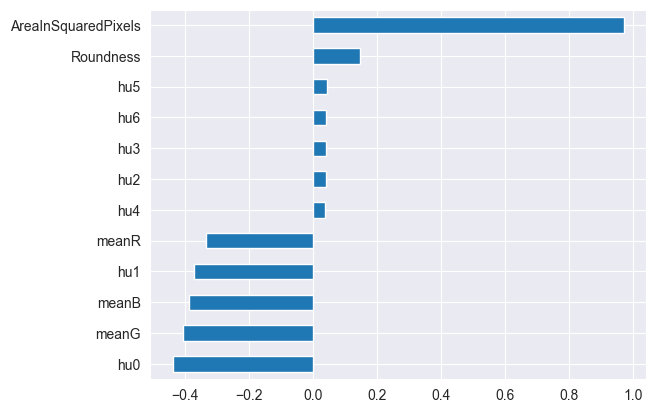

In [8]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

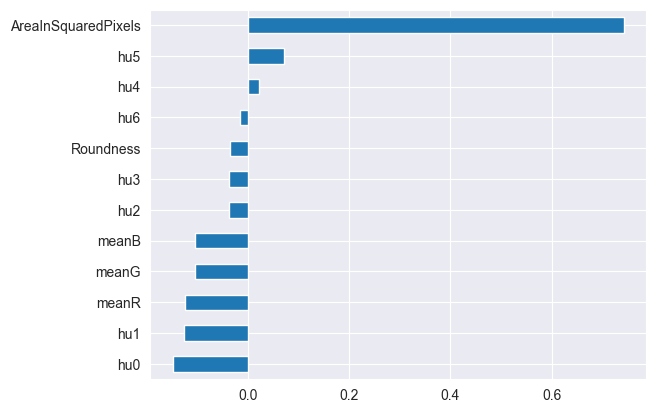

In [9]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

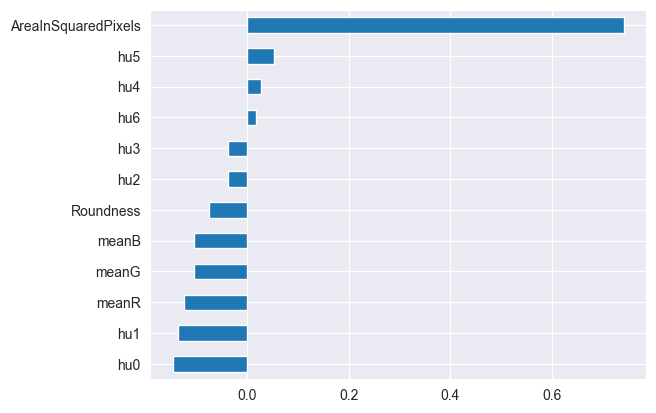

In [10]:
testdf = pd.read_csv("allfeaturesYOLORasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

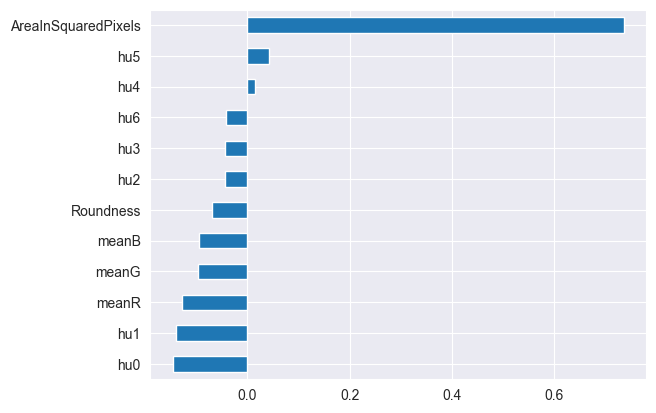

In [11]:
testdf = pd.read_csv("allfeaturesDetectron2rasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()



<AxesSubplot: >

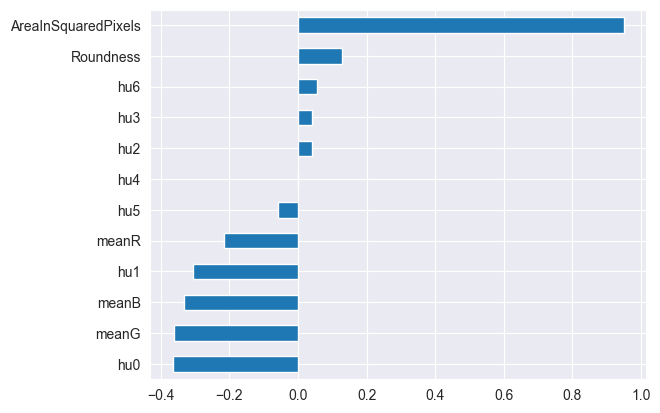

In [12]:
#checando correlacion no lineal con spearman
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr(method= 'spearman')["AverageMass"].sort_values()[:-1].plot.barh()


In [13]:
testdf.corr().style.background_gradient(cmap='coolwarm')


,AverageMass,AreaInSquaredPixels,Roundness,hu0,hu1,hu2,hu3,hu4,hu5,hu6,meanB,meanG,meanR
AverageMass,1.000000,0.971616,0.147975,-0.436478,-0.372183,0.041011,0.041011,0.037208,0.045287,0.041830,-0.386290,-0.404366,-0.333780
AreaInSquaredPixels,0.971616,1.000000,0.148809,-0.456898,-0.384775,0.054358,0.054358,0.037499,0.042792,0.035218,-0.389722,-0.406470,-0.399383
Roundness,0.147975,0.148809,1.000000,-0.055411,0.117716,0.070617,0.070617,0.016065,0.003740,0.016817,-0.289358,-0.244875,-0.065841
hu0,-0.436478,-0.456898,-0.055411,1.000000,0.756037,0.172867,0.172867,-0.085603,-0.049323,-0.041409,0.788042,0.893985,0.654910
hu1,-0.372183,-0.384775,0.117716,0.756037,1.000000,-0.019207,-0.019207,-0.102314,-0.034972,-0.104948,0.460615,0.580435,0.276126
hu2,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu3,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu4,0.037208,0.037499,0.016065,-0.085603,-0.102314,-0.067787,-0.067787,1.000000,0.493780,0.096488,-0.040366,-0.072974,-0.049212
hu5,0.045287,0.042792,0.003740,-0.049323,-0.034972,0.052346,0.052346,0.493780,1.000000,0.064254,-0.045144,-0.072504,-0.015929
hu6,0.041830,0.035218,0.016817,-0.041409,-0.104948,-0.043903,-0.043903,0.096488,0.064254,1.000000,0.027822,0.018287,-0.019152


<AxesSubplot: >

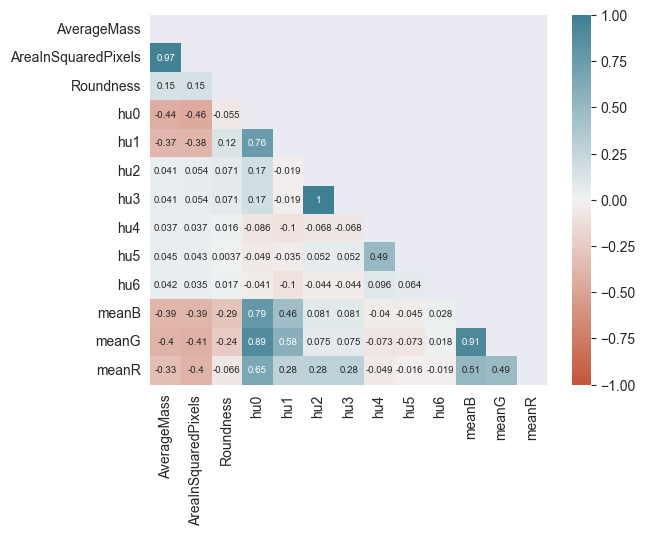

In [14]:

corrmat = testdf.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

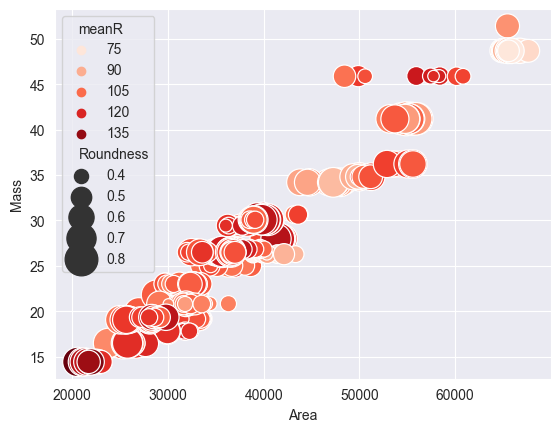

In [15]:
sns.scatterplot(data = testdf, x=testdf['AreaInSquaredPixels'], y=testdf['AverageMass'],
               size=testdf['Roundness'], hue=testdf['meanR'],
               sizes=(20,600),
               palette='Reds')

plt.xlabel('Area')
plt.ylabel('Mass')
plt.savefig("./figures/StrawberriesRawAreaVsMassAndRoundnessAndMeanRed", dpi=300)


# Deep learning

In [3]:
print(tf.__version__)
!pip3 install tensorflow_addons


2.9.0
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [4]:
!pip3 install tensorflow-addons==0.16.1


Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [5]:
#%reload_ext tensorboard

#%rm -rf "logs/fit"

import tensorflow_addons as tfa
from tensorflow_addons.metrics import RSquare


/Users/pablo/Library/Python/3.9/lib/python/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [6]:
!pip3 install pydot

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


# MASTER CLASS

In [18]:
class AutomaticLearning:



  def __init__(self , dataframe, title, model_name):

    print(dataframe.head(2))

    self.df = dataframe
    self.model_name = model_name
    self.input_shape = None
    self.num_classes = None
    self.epochs = None
    self.model = None
    self.X = None
    self.y = None
    self.X_train = None
    self.X_test = None
    self.y_train = None
    self.y_test = None
    self.run_name = "run"
    self.history = None
    self.r2 = None
    self.loss = None
    self.mse = None
    self.mae = None
    self.rmse = None
    self.library = None
    self.title = title
    return


  def plotA(self):
    pd.DataFrame(self.history.history).plot(figsize=(8,5))
    plt.show()
    return

  def plotLinear(self):
    # plot the data and the predictions

    #print(self.X_test)
    predictions = self.model.predict(self.X_test)

    plt.xlabel('Area (pixels^2)')
    plt.ylabel('Mass (g)')

    plt.scatter(self.X_test, self.y_test)
    if(self.model_name == "SVR"):
      plt.scatter(self.X_test, predictions, color='red', marker="x")
    else:
      plt.plot(self.X_test, predictions, color='red')

    plt.show()
    print(f'R-squared value: {self.r2:.4f}')


    plt.scatter(self.y_test, predictions)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.show()
    return

  def plotLoss(self):
    fig, ax = plt.subplots()
    ax.set(title='Loss')
    ax.plot(self.history.history['loss'], label='Loss')
    ax.plot(self.history.history['val_loss'], label='Val loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='MSE')
    ax.plot(self.history.history['mse'], label='MSE')
    ax.plot(self.history.history['val_mse'], label='Val MSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
    

  def plotMAE(self):
    fig, ax = plt.subplots()
    ax.set(title='MAE')
    ax.plot(self.history.history['mae'], label='MAE')
    ax.plot(self.history.history['val_mae'], label='Val MAE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotRMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='RMSE')
    ax.plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax.plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
  
  def plotPredictions(self):
    predictions = self.model(self.X_test)
    self.r2 = r2_score(self.y_test, predictions)
    print(f'R-squared value: {self.r2:.4f}')
    plt.scatter(self.y_test, predictions)
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

  def plotAll(self):

    fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))
   
    fig.suptitle(self.title, size = 35)   

    ax[0][0].set(title='Loss')
    ax[0][0].plot(self.history.history['loss'], label='Loss')
    ax[0][0].plot(self.history.history['val_loss'], label='Val loss')
    ax[0][0].set_xlabel('Epoch')
    ax[0][0].set_ylabel('Values')
    ax[0][0].legend()


    ax[0][1].set(title='MSE')
    ax[0][1].plot(self.history.history['mse'], label='MSE')
    ax[0][1].plot(self.history.history['val_mse'], label='Val MSE')
    ax[0][1].set_xlabel('Epoch')
    ax[0][1].set_ylabel('Values')
    ax[0][1].legend()

   

    ax[1][0].set(title='MAE')
    ax[1][0].plot(self.history.history['mae'], label='MAE')
    ax[1][0].plot(self.history.history['val_mae'], label='Val MAE')
    ax[1][0].set_xlabel('Epoch')
    ax[1][0].set_ylabel('Values')
    ax[1][0].legend()

    ax[1][1].set(title='RMSE')
    ax[1][1].plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax[1][1].plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax[1][1].set_xlabel('Epoch')
    ax[1][1].set_ylabel('Values')
    ax[1][1].legend()

    
    plt.show()

  def plotNonLinear(self):

    self.plotAll()
    self.plotPredictions()
    #self.plotLoss()
    #self.plotMAE()
    #self.plotMSE()
    #self.plotRMSE()
    return

  def plot(self):
    if(self.library == "Tensorflow"):
      self.plotNonLinear()
    elif(self.library == "scikit"):
      print("plotting linear")
      self.plotLinear()


  def train(self, epochs = 2):

    self.epochs = epochs


    if(self.library == "Tensorflow"):
      opt = optimizers.Adam(learning_rate=0.01)
      sgd = optimizers.SGD(learning_rate=0.01, momentum=0.9, nesterov=True)

      
      self.model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer = opt, metrics=['mse', 'mae', tf.keras.metrics.RootMeanSquaredError()])
      early_stop = EarlyStopping(monitor='val_loss', patience=250, verbose=1)

      self.history = self.model.fit(self.X_train, self.y_train, batch_size=32, epochs = self.epochs, validation_split=0.2, shuffle = True,callbacks=[early_stop], verbose = 1)
      #['loss', 'mse', 'mae', 'root_mean_squared_error']
      results = self.model.evaluate(self.X_test, self.y_test)
      self.loss = results[0]
      self.mse = results[1]
      self.mae = results[2]
      self.rmse = results[3]
      print("Test loss:", results)
      print(self.model.metrics_names)

    elif(self.library == "scikit"):


      self.model.fit(self.X_train, self.y_train)
      self.y_pred = self.model.predict(self.X_test)


      self.predictions = self.model.predict(self.X_test)

      self.r2 = r2_score(self.y_test, self.y_pred)

      #self.r2 = self.model.score(self.X, self.y)
      self.mse = mean_squared_error(self.y_test, self.y_pred)
      self.mae = mean_absolute_error(self.y_test, self.y_pred)
      self.rmse = np.sqrt(self.mse)
      
    return
  def buildData(self):

    normalizer = Normalization()


    if(self.model_name == 'CNN' or self.model_name == 'ResNet' or self.model_name == 'MobileNet'):
      print("entrando")
      self.X = np.array(self.df['img'].tolist())
      self.y = np.array(self.df['AverageMass'].tolist())
      self.X = self.X / 255.0

    else:
      self.X = self.df.drop(columns=['AverageMass', 'ID'])
      self.y = self.df['AverageMass']

      if(self.library == "scikit"):
        self.X = self.df["AreaInSquaredPixels"]
      
    if(self.library == "Tensorflow" and self.model_name != 'CNN'):
      #self.X = scaler.fit_transform(self.X)
      normalizer.adapt(self.X)
      self.X = normalizer(self.X)

    #print(self.X.head(10))
  
    self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=0.2)


    if(self.model_name != 'CNN' or self.model_name != 'ResNet' or self.model_name != 'MobileNet'):
      self.X_train = np.array(self.X_train)
      self.y_train = np.array(self.y_train)
      self.X_test = np.array(self.X_test)
      self.y_test = np.array(self.y_test)

    # Define the input shape and number of classes
    self.input_shape = (self.X_train.shape[1],)
    #print(self.input_shape)
    num_classes = 1
    return

  def buildModel(self):

    if(self.model_name == "FCNN"): 
      # FCNN
      self.library = "Tensorflow"
      self.model = keras.Sequential(
          [
          tf.keras.layers.Dense(64, activation='relu', input_shape = self.input_shape),
          tf.keras.layers.Dense(32, activation='relu'),
          tf.keras.layers.Dense(16, activation='linear'),
          tf.keras.layers.Dense(1)
          ]
      )
    elif(self.model_name == "DeepSVM"):

      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Dense(128, activation='linear', input_shape=self.input_shape, kernel_regularizer=tf.keras.regularizers.l2(0.01)),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "CNN"):
      # Autoencoder
      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(140, 140, 3)),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(64, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(128, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Flatten(),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "ResNet"):
      self.library = "Tensorflow"
      base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False


    elif(self.model_name == "DenseNet"):
      self.library = "Tensorflow"

      base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "MobileNet"):
      self.library = "Tensorflow"

      base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "linear"):
      self.library = "scikit"
      self.model = LinearRegression()

    elif(self.model_name == "SVR"):
      self.library = "scikit"
      # Create an SVR object and fit the training data
      self.model = SVR(kernel='rbf', C=100, epsilon=0.01)

    elif(self.model_name == "MLP"):
      # MLP
      self.library = "Tensorflow"
      self.model = Sequential([
          Dense(64, activation='relu', input_shape=self.input_shape),
          Dropout(0.2),
          Dense(32, activation='relu'),
          Dropout(0.2),
          Dense(1, activation='linear')
      ])


    if(self.library == "Tensorflow"):
      print(self.model.summary())
      plot_model(self.model, to_file= self.model_name + "-" + self.run_name + "-" + self.title + '.png', show_shapes=True, show_layer_names=False)
      #plot_model(self.model, show_shapes=True, show_layer_names=False)

      img = mpimg.imread(self.model_name + "-" + self.run_name + "-" + self.title + '.png')
      imgplot = plt.imshow(img)
      #imgplot = plt.imshow(img2)
      plt.show()
    return




In [19]:

RawExperiments = {
    "Blueberries": {
        "Tests" : {
                "DeepLearning": {
                        "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                        "Extention" : ".csv",
                        "Models" : ["MLP", "FCNN", "DeepSVM"],
                        "Epochs" : [100, 400, 1000, 2000]
                },
                "MachineLearning": {
                        "Datasets" : ["CGBR"],
                        "Extention" : ".csv",
                        "Models" : ["Linear", "SVR"],
                        "Epochs" : [1]
                },
                "Images" : {
                        "Datasets" : ["CIBR"],
                        "Extention" : ".pkl",
                        "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                        "Epochs" : [50, 200, 1000, 4000]
                }
        }
    }
}

RawExperiments = {
    "Blueberries": {
        "Tests" : {
                "DeepLearning": {
                        "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                        "Extention" : ".csv",
                        "Models" : ["MLP", "FCNN", "DeepSVM"],
                        "Epochs" : [1, 4, 10, 20]
                },
                "MachineLearning": {
                        "Datasets" : ["CGBR"],
                        "Extention" : ".csv",
                        "Models" : ["Linear", "SVR"],
                        "Epochs" : [1]
                },
                "Images" : {
                        "Datasets" : ["CIBR"],
                        "Extention" : ".pkl",
                        "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                        "Epochs" : [2, 2, 1, 4]
                }
        }
    }
}


YOLOExperiments = {}
DetectronExperiments = {}


Running experiments for Blueberries...
Running DeepLearning tests...
Running tests on CGBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 64)                192       
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_4 (Dense)             (None, 32)                2080      
                                                                 
 dropout_3 (Dropout)         (None, 32)                0         
                                                                 
 

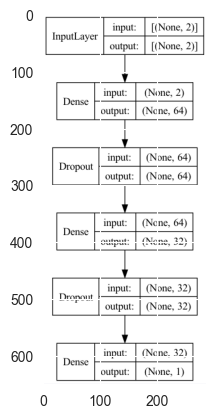

2023-05-02 01:45:20.596730: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-02 01:45:20.893222: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 42ms/step - loss: 7243.1147 - mse: 7243.1147 - mae: 81.2268 - root_mean_squared_error: 85.1065


2023-05-02 01:45:21.509724: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [7243.11474609375, 7243.11474609375, 81.2268295288086, 85.10649108886719]
['loss', 'mse', 'mae', 'root_mean_squared_error']


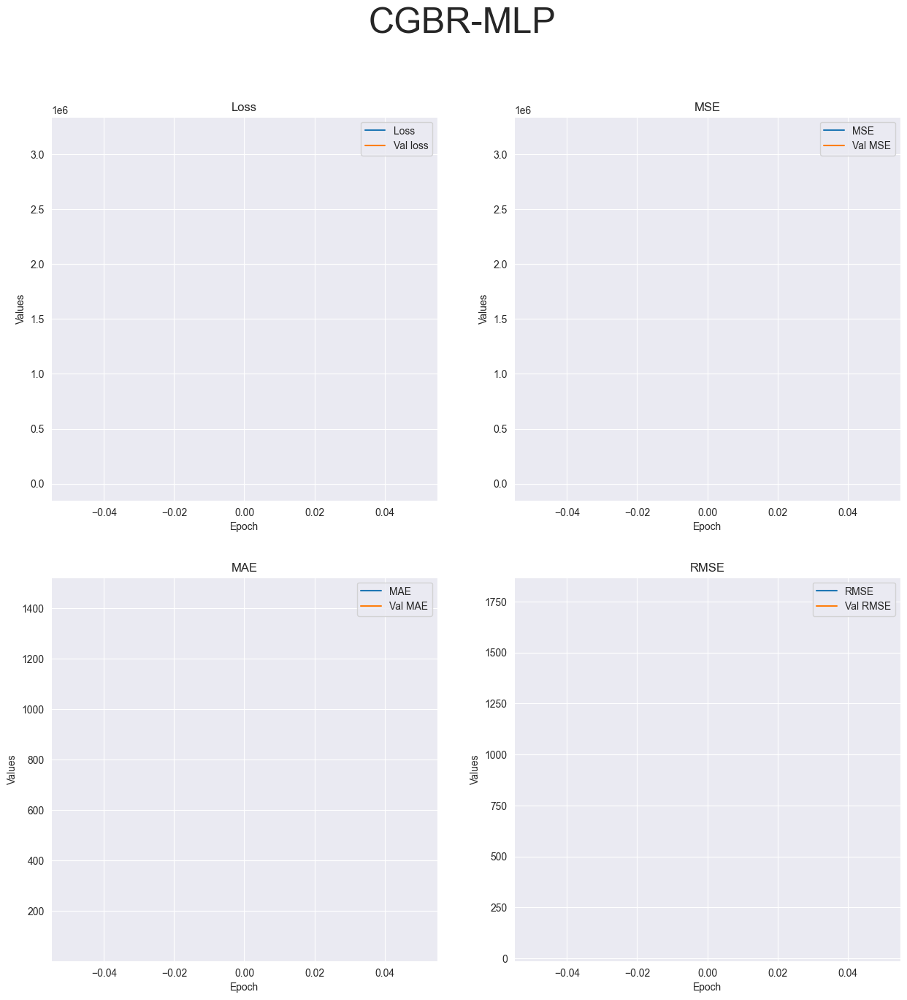

R-squared value: -14547.5113


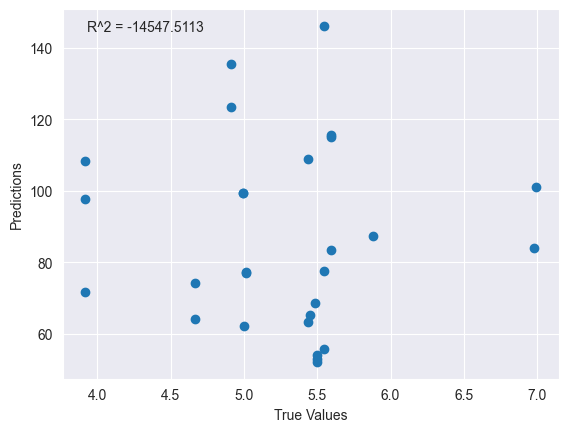

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 64)                192       
                                                                 
 dropout_4 (Dropout)         (None, 64)                0         
                                                                 
 dense_7 (Dense)             (None, 32)                2080      
                                                                 
 dropout_5 (Dropout)         (None, 32)                0         
                                                                 
 dense_8 (Dense)             (None, 1)                 33        
                                                                 
To

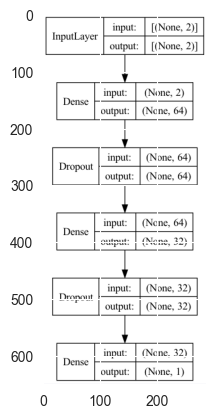

Epoch 1/4
1/3 [=========>....................] - ETA: 0s - loss: 1134104.7500 - mse: 1134104.7500 - mae: 848.7476 - root_mean_squared_error: 1064.9436

2023-05-02 01:45:22.817107: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 115ms/step - loss: 1634191.8750 - mse: 1634191.8750 - mae: 971.2031 - root_mean_squared_error: 1278.3551 - val_loss: 261303.1250 - val_mse: 261303.1250 - val_mae: 497.6034 - val_root_mean_squared_error: 511.1782
Epoch 2/4
3/3 [==============================] - 0s 19ms/step - loss: 466388.6250 - mse: 466388.6250 - mae: 516.8132 - root_mean_squared_error: 682.9265 - val_loss: 5047.4985 - val_mse: 5047.4985 - val_mae: 69.3745 - val_root_mean_squared_error: 71.0457
Epoch 3/4
3/3 [==============================] - 0s 18ms/step - loss: 134117.4062 - mse: 134117.4062 - mae: 265.4664 - root_mean_squared_error: 366.2204 - val_loss: 60749.9766 - val_mse: 60749.9766 - val_mae: 239.5310 - val_root_mean_squared_error: 246.4751
Epoch 4/4
1/3 [=========>....................] - ETA: 0s - loss: 79658.6172 - mse: 79658.6172 - mae: 242.1284 - root_mean_squared_error: 282.2386

2023-05-02 01:45:23.152208: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 37ms/step - loss: 42988.3789 - mse: 42988.3789 - mae: 199.6541 - root_mean_squared_error: 207.3364
Test loss: [42988.37890625, 42988.37890625, 199.654052734375, 207.33639526367188]
['loss', 'mse', 'mae', 'root_mean_squared_error']


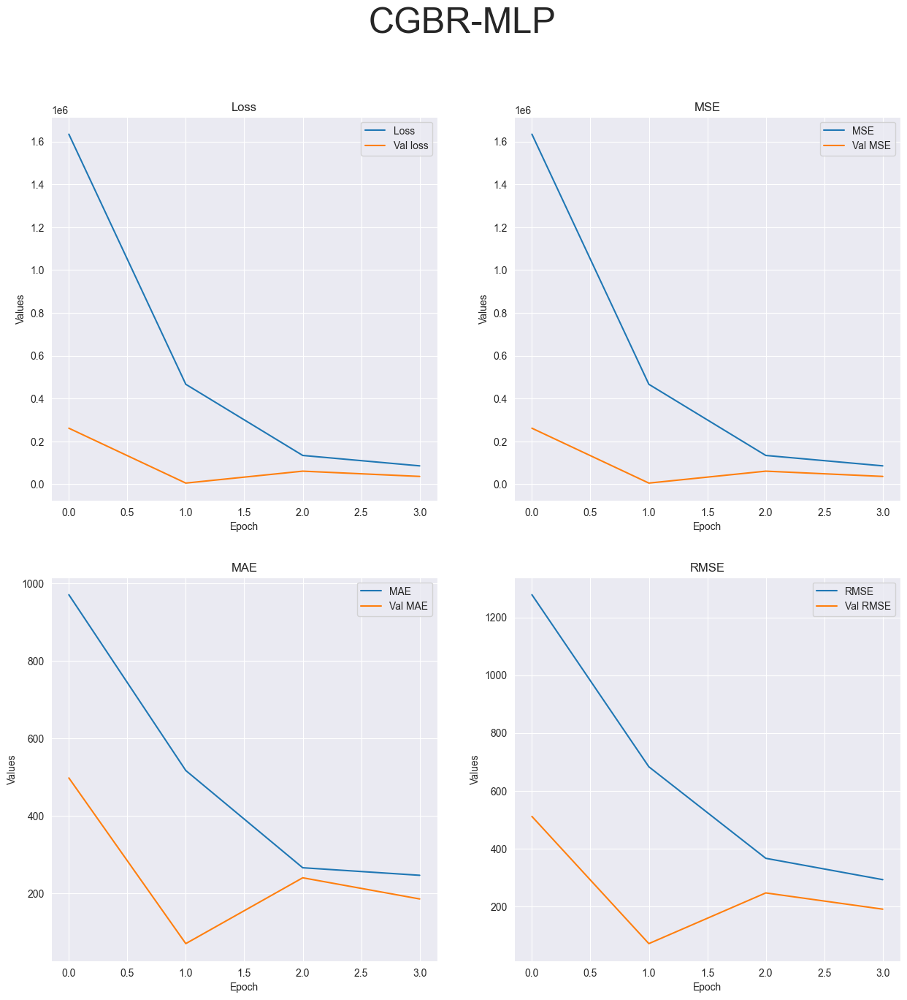

R-squared value: -117195.2036


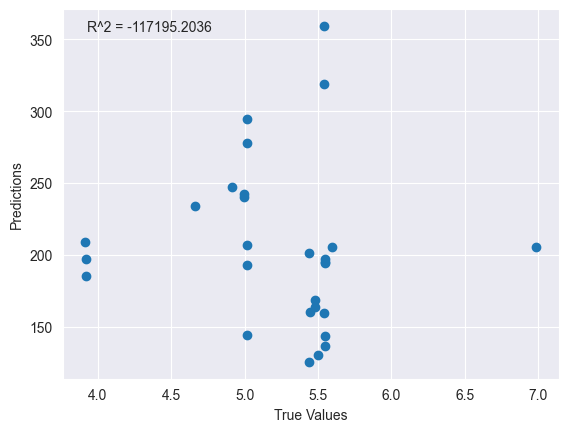

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 64)                192       
                                                                 
 dropout_6 (Dropout)         (None, 64)                0         
                                                                 
 dense_10 (Dense)            (None, 32)                2080      
                                                                 
 dropout_7 (Dropout)         (None, 32)                0         
                                                                 
 dense_11 (Dense)            (None, 1)                 33        
                                                                 
T

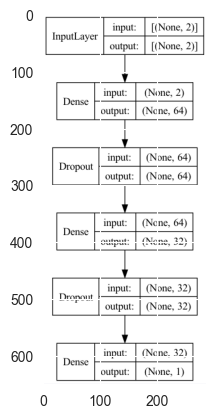

Epoch 1/10
1/3 [=========>....................] - ETA: 0s - loss: 1446783.7500 - mse: 1446783.7500 - mae: 940.1350 - root_mean_squared_error: 1202.8232

2023-05-02 01:45:24.581065: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 244ms/step - loss: 2317280.2500 - mse: 2317280.2500 - mae: 1173.5444 - root_mean_squared_error: 1522.2616 - val_loss: 200145.8281 - val_mse: 200145.8281 - val_mae: 438.5646 - val_root_mean_squared_error: 447.3766
Epoch 2/10
3/3 [==============================] - 0s 18ms/step - loss: 916618.6250 - mse: 916618.6250 - mae: 774.2823 - root_mean_squared_error: 957.4020 - val_loss: 122350.6719 - val_mse: 122350.6719 - val_mae: 342.9465 - val_root_mean_squared_error: 349.7866
Epoch 3/10
3/3 [==============================] - 0s 18ms/step - loss: 269285.1562 - mse: 269285.1562 - mae: 405.5951 - root_mean_squared_error: 518.9269 - val_loss: 26318.6094 - val_mse: 26318.6094 - val_mae: 158.7146 - val_root_mean_squared_error: 162.2301
Epoch 4/10
1/3 [=========>....................] - ETA: 0s - loss: 126648.1094 - mse: 126648.1094 - mae: 276.5787 - root_mean_squared_error: 355.8765

2023-05-02 01:45:25.172421: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 18ms/step - loss: 111984.3281 - mse: 111984.3281 - mae: 268.3279 - root_mean_squared_error: 334.6406 - val_loss: 34017.7383 - val_mse: 34017.7383 - val_mae: 180.4753 - val_root_mean_squared_error: 184.4390
Epoch 5/10
3/3 [==============================] - 0s 18ms/step - loss: 99554.6953 - mse: 99554.6953 - mae: 249.6750 - root_mean_squared_error: 315.5229 - val_loss: 27224.2148 - val_mse: 27224.2148 - val_mae: 161.4265 - val_root_mean_squared_error: 164.9976
Epoch 6/10
3/3 [==============================] - 0s 17ms/step - loss: 58921.2656 - mse: 58921.2656 - mae: 194.2729 - root_mean_squared_error: 242.7370 - val_loss: 16172.6348 - val_mse: 16172.6348 - val_mae: 124.3637 - val_root_mean_squared_error: 127.1717
Epoch 7/10
3/3 [==============================] - 0s 18ms/step - loss: 25289.5332 - mse: 25289.5332 - mae: 127.6168 - root_mean_squared_error: 159.0268 - val_loss: 7910.1929 - val_mse: 7910.1929 - val_mae: 86.9014 - val_root_mean_squared_

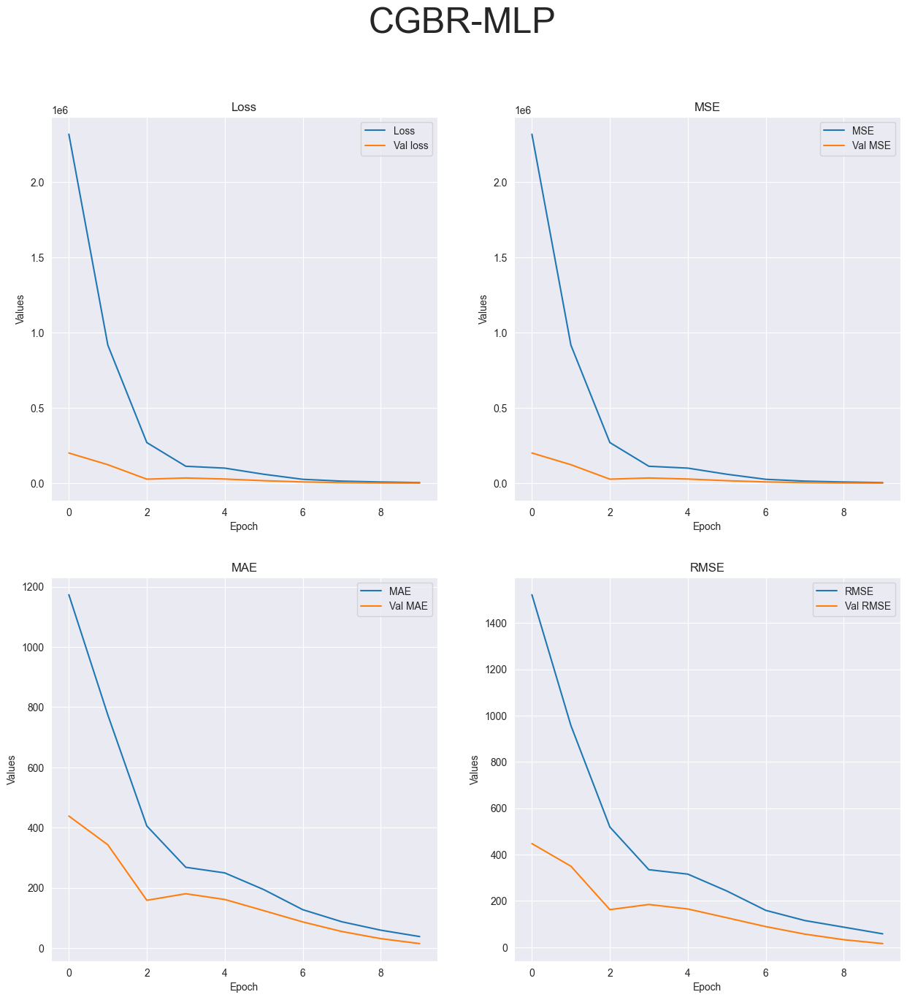

R-squared value: -1263.9265


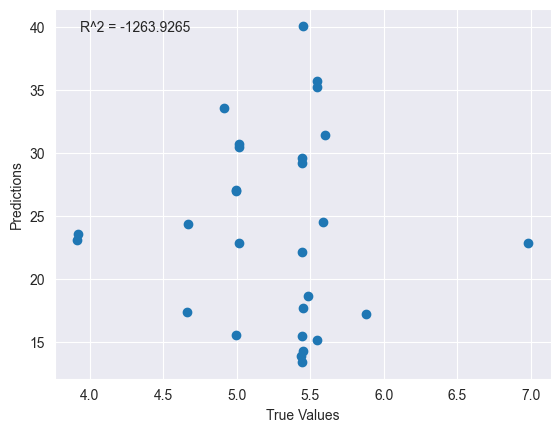

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 64)                192       
                                                                 
 dropout_8 (Dropout)         (None, 64)                0         
                                                                 
 dense_13 (Dense)            (None, 32)                2080      
                                                                 
 dropout_9 (Dropout)         (None, 32)                0         
                                                                 
 dense_14 (Dense)            (None, 1)                 33        
                                                                 
T

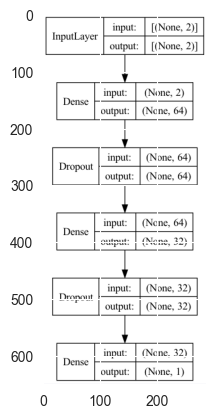

Epoch 1/20
1/3 [=========>....................] - ETA: 0s - loss: 1587951.3750 - mse: 1587951.3750 - mae: 964.9838 - root_mean_squared_error: 1260.1394

2023-05-02 01:45:26.829318: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 126ms/step - loss: 2234396.2500 - mse: 2234396.2500 - mae: 1152.6998 - root_mean_squared_error: 1494.7897 - val_loss: 437993.0312 - val_mse: 437993.0312 - val_mae: 636.1215 - val_root_mean_squared_error: 661.8104
Epoch 2/20
3/3 [==============================] - 0s 19ms/step - loss: 699229.1250 - mse: 699229.1250 - mae: 623.7477 - root_mean_squared_error: 836.1992 - val_loss: 295773.9375 - val_mse: 295773.9375 - val_mae: 522.8152 - val_root_mean_squared_error: 543.8510
Epoch 3/20
3/3 [==============================] - 0s 19ms/step - loss: 240489.1250 - mse: 240489.1250 - mae: 364.2808 - root_mean_squared_error: 490.3969 - val_loss: 38576.0156 - val_mse: 38576.0156 - val_mae: 188.2423 - val_root_mean_squared_error: 196.4078
Epoch 4/20
1/3 [=========>....................] - ETA: 0s - loss: 144884.3125 - mse: 144884.3125 - mae: 268.8032 - root_mean_squared_error: 380.6367

2023-05-02 01:45:27.183819: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 20ms/step - loss: 135120.3750 - mse: 135120.3750 - mae: 280.7769 - root_mean_squared_error: 367.5872 - val_loss: 60166.3906 - val_mse: 60166.3906 - val_mae: 235.1958 - val_root_mean_squared_error: 245.2884
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 101952.2734 - mse: 101952.2734 - mae: 265.0687 - root_mean_squared_error: 319.2997 - val_loss: 31520.9297 - val_mse: 31520.9297 - val_mae: 170.1183 - val_root_mean_squared_error: 177.5414
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 54972.5273 - mse: 54972.5273 - mae: 181.6373 - root_mean_squared_error: 234.4622 - val_loss: 14755.6846 - val_mse: 14755.6846 - val_mae: 116.2568 - val_root_mean_squared_error: 121.4730
Epoch 7/20
3/3 [==============================] - 0s 20ms/step - loss: 34391.6836 - mse: 34391.6836 - mae: 138.8100 - root_mean_squared_error: 185.4500 - val_loss: 6311.0586 - val_mse: 6311.0586 - val_mae: 75.8775 - val_root_mean_square

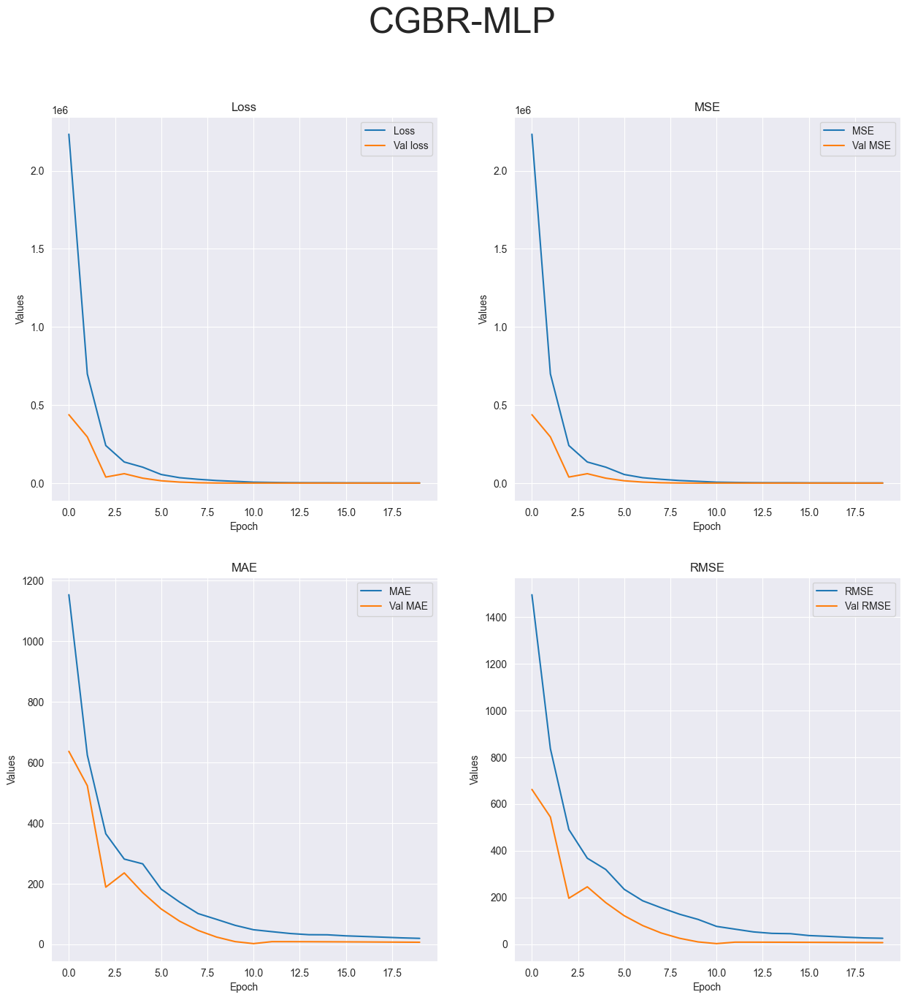

R-squared value: -91.0073


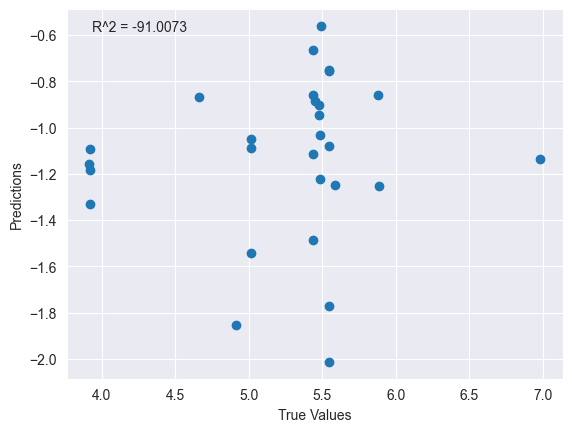

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_15 (Dense)            (None, 64)                192       
                                                                 
 dense_16 (Dense)            (None, 32)                2080      
                                                                 
 dense_17 (Dense)            (None, 16)                528       
                                                                 
 dense_18 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
______________________________________

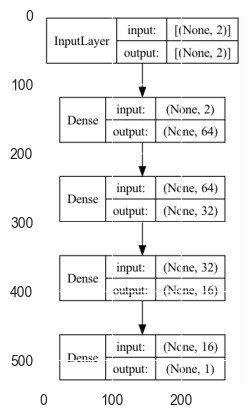

1/3 [=========>....................] - ETA: 0s - loss: 81536.3047 - mse: 81536.3047 - mae: 274.6278 - root_mean_squared_error: 285.5456

2023-05-02 01:45:29.524632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 45ms/step - loss: 188072.6094 - mse: 188072.6094 - mae: 417.0734 - root_mean_squared_error: 433.6734


2023-05-02 01:45:29.865888: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [188072.609375, 188072.609375, 417.0733947753906, 433.67340087890625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


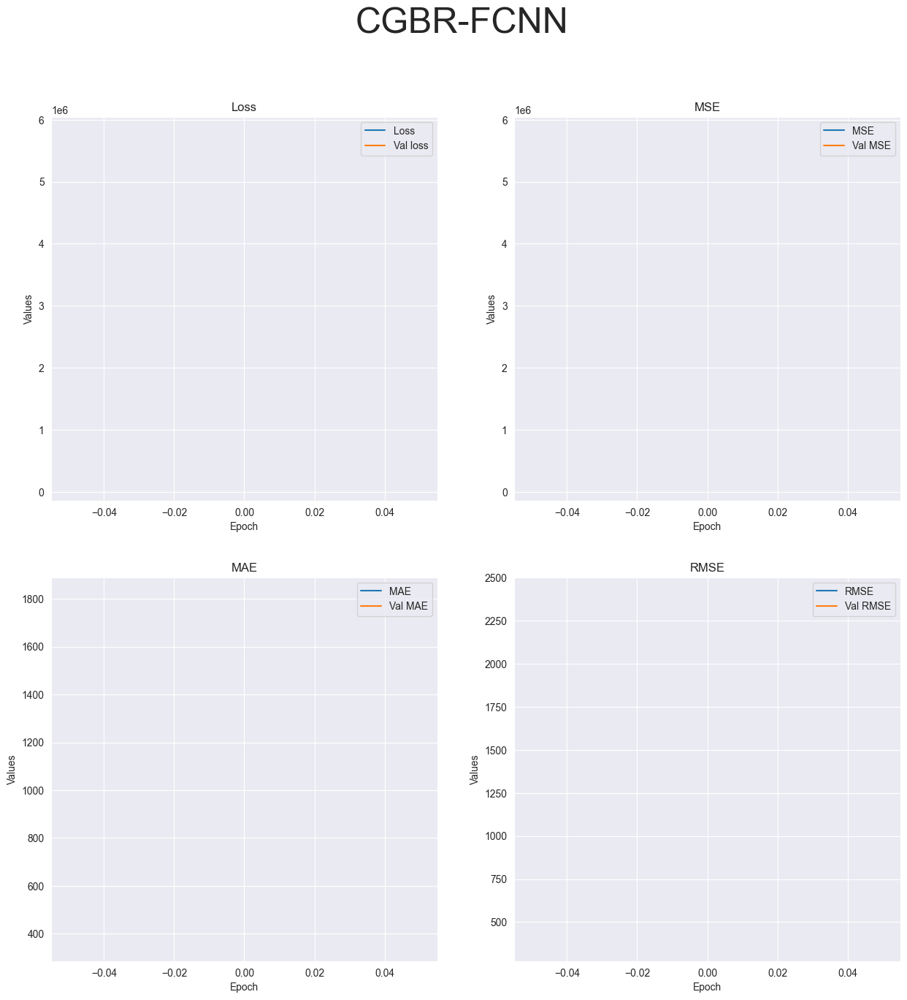

R-squared value: -321654.6153


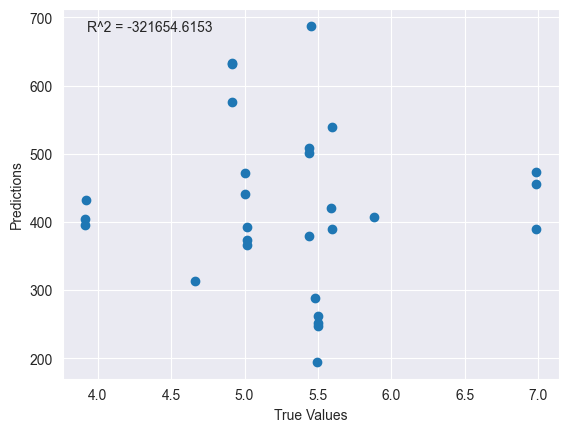

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_19 (Dense)            (None, 64)                192       
                                                                 
 dense_20 (Dense)            (None, 32)                2080      
                                                                 
 dense_21 (Dense)            (None, 16)                528       
                                                                 
 dense_22 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________


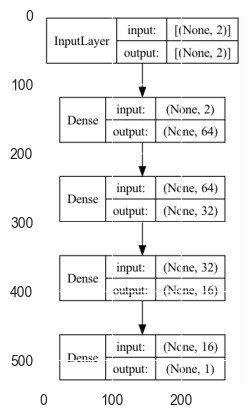

Epoch 1/4
1/3 [=========>....................] - ETA: 0s - loss: 64526.2578 - mse: 64526.2578 - mae: 242.1227 - root_mean_squared_error: 254.0202

2023-05-02 01:45:31.075424: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 136ms/step - loss: 6738591.0000 - mse: 6738591.0000 - mae: 1924.9135 - root_mean_squared_error: 2595.8796 - val_loss: 194868.9375 - val_mse: 194868.9375 - val_mae: 422.1781 - val_root_mean_squared_error: 441.4396
Epoch 2/4
3/3 [==============================] - 0s 22ms/step - loss: 1500447.0000 - mse: 1500447.0000 - mae: 1079.6918 - root_mean_squared_error: 1224.9274 - val_loss: 2645798.0000 - val_mse: 2645798.0000 - val_mae: 1556.8838 - val_root_mean_squared_error: 1626.5909
Epoch 3/4
3/3 [==============================] - 0s 20ms/step - loss: 1766677.8750 - mse: 1766677.8750 - mae: 1251.0940 - root_mean_squared_error: 1329.1643 - val_loss: 284238.9688 - val_mse: 284238.9688 - val_mae: 509.9764 - val_root_mean_squared_error: 533.1407
Epoch 4/4


2023-05-02 01:45:31.434775: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 40ms/step - loss: 56352.8320 - mse: 56352.8320 - mae: 229.2851 - root_mean_squared_error: 237.3875
Test loss: [56352.83203125, 56352.83203125, 229.2850799560547, 237.38751220703125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


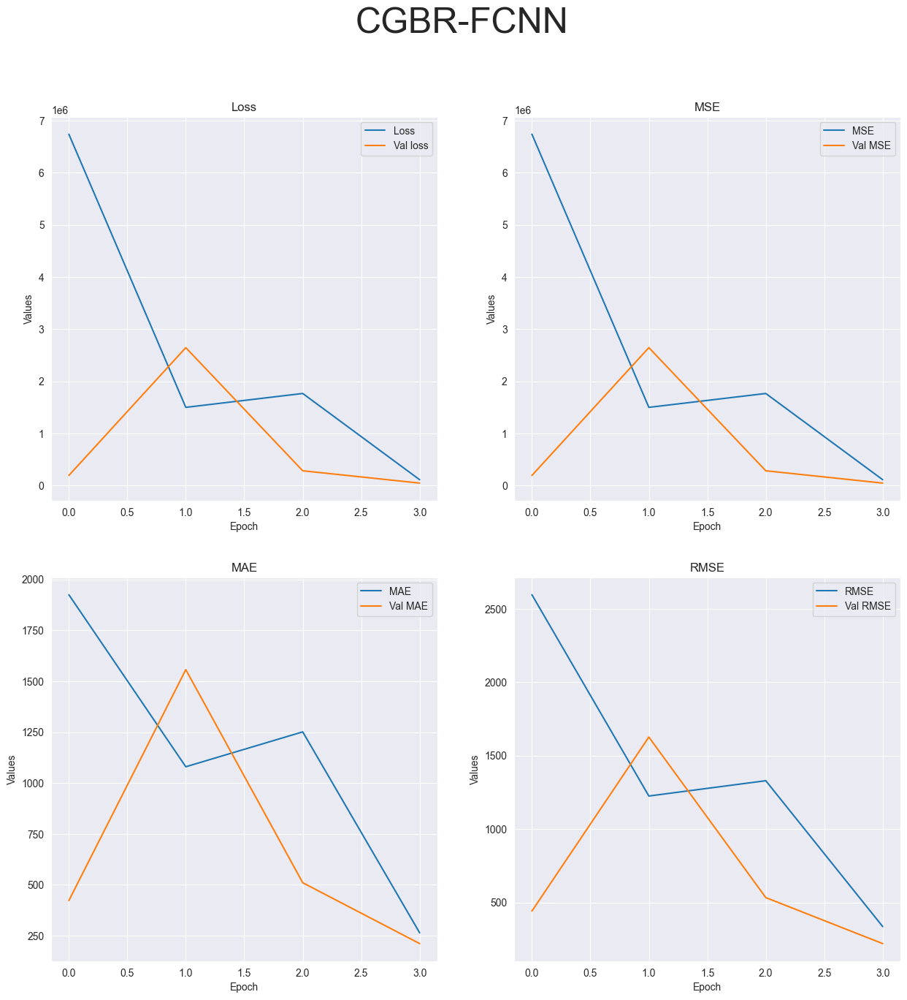

R-squared value: -108592.8872


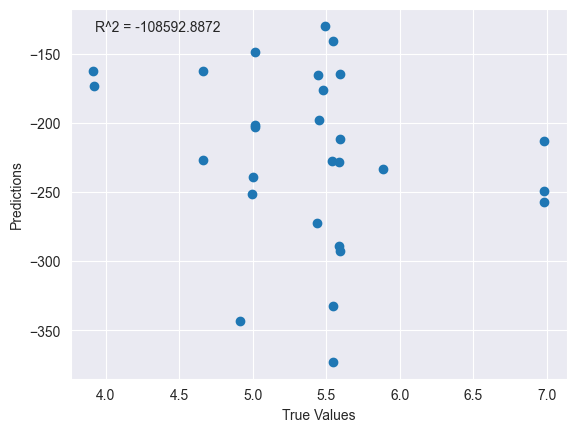

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_23 (Dense)            (None, 64)                192       
                                                                 
 dense_24 (Dense)            (None, 32)                2080      
                                                                 
 dense_25 (Dense)            (None, 16)                528       
                                                                 
 dense_26 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________

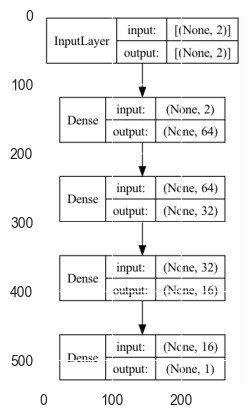

Epoch 1/10
1/3 [=========>....................] - ETA: 0s - loss: 63828.3750 - mse: 63828.3750 - mae: 244.6983 - root_mean_squared_error: 252.6428

2023-05-02 01:45:33.283642: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 113ms/step - loss: 6201461.0000 - mse: 6201461.0000 - mae: 1844.4972 - root_mean_squared_error: 2490.2732 - val_loss: 264039.3125 - val_mse: 264039.3125 - val_mae: 493.0386 - val_root_mean_squared_error: 513.8475
Epoch 2/10
3/3 [==============================] - 0s 18ms/step - loss: 1611753.7500 - mse: 1611753.7500 - mae: 1103.9943 - root_mean_squared_error: 1269.5486 - val_loss: 3048217.5000 - val_mse: 3048217.5000 - val_mae: 1676.1438 - val_root_mean_squared_error: 1745.9146
Epoch 3/10
3/3 [==============================] - 0s 18ms/step - loss: 1509008.0000 - mse: 1509008.0000 - mae: 1156.6392 - root_mean_squared_error: 1228.4169 - val_loss: 260878.7812 - val_mse: 260878.7812 - val_mae: 490.0769 - val_root_mean_squared_error: 510.7629
Epoch 4/10
1/3 [=========>....................] - ETA: 0s - loss: 236783.0000 - mse: 236783.0000 - mae: 463.3822 - root_mean_squared_error: 486.6035

2023-05-02 01:45:33.596853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 18ms/step - loss: 93899.3594 - mse: 93899.3594 - mae: 237.9778 - root_mean_squared_error: 306.4300 - val_loss: 93161.9531 - val_mse: 93161.9531 - val_mae: 293.4765 - val_root_mean_squared_error: 305.2244
Epoch 5/10
3/3 [==============================] - 0s 18ms/step - loss: 132383.6250 - mse: 132383.6250 - mae: 343.8992 - root_mean_squared_error: 363.8456 - val_loss: 293799.6875 - val_mse: 293799.6875 - val_mae: 520.8756 - val_root_mean_squared_error: 542.0329
Epoch 6/10
3/3 [==============================] - 0s 17ms/step - loss: 224167.9375 - mse: 224167.9375 - mae: 455.7683 - root_mean_squared_error: 473.4638 - val_loss: 234726.1094 - val_mse: 234726.1094 - val_mae: 465.6149 - val_root_mean_squared_error: 484.4854
Epoch 7/10
3/3 [==============================] - 0s 17ms/step - loss: 151127.2188 - mse: 151127.2188 - mae: 370.6766 - root_mean_squared_error: 388.7509 - val_loss: 106763.1953 - val_mse: 106763.1953 - val_mae: 314.1416 - val_root_

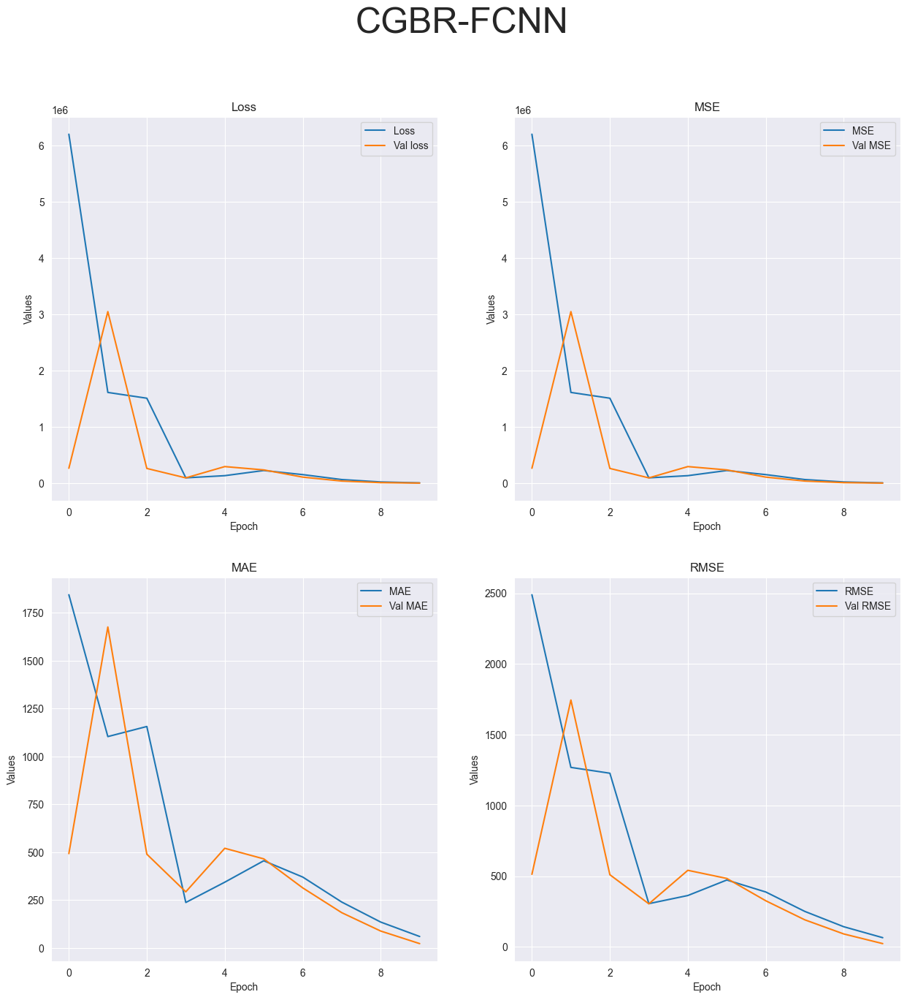

R-squared value: -607.6693


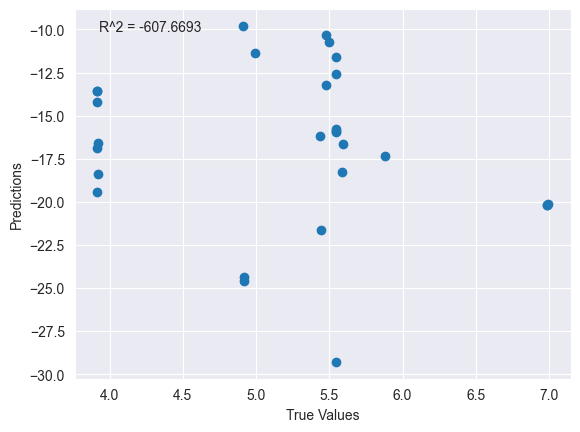

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_27 (Dense)            (None, 64)                192       
                                                                 
 dense_28 (Dense)            (None, 32)                2080      
                                                                 
 dense_29 (Dense)            (None, 16)                528       
                                                                 
 dense_30 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________

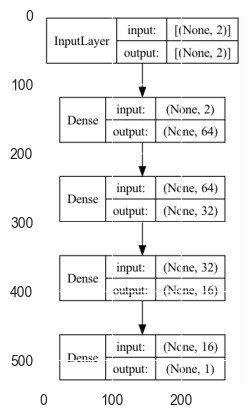

Epoch 1/20
1/3 [=========>....................] - ETA: 0s - loss: 74568.2266 - mse: 74568.2266 - mae: 262.5084 - root_mean_squared_error: 273.0718

2023-05-02 01:45:35.362713: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 113ms/step - loss: 7249159.0000 - mse: 7249159.0000 - mae: 1992.1622 - root_mean_squared_error: 2692.4263 - val_loss: 150432.5469 - val_mse: 150432.5469 - val_mae: 369.5796 - val_root_mean_squared_error: 387.8564
Epoch 2/20
3/3 [==============================] - 0s 22ms/step - loss: 1620626.3750 - mse: 1620626.3750 - mae: 1115.2373 - root_mean_squared_error: 1273.0382 - val_loss: 2159209.7500 - val_mse: 2159209.7500 - val_mae: 1401.5437 - val_root_mean_squared_error: 1469.4249
Epoch 3/20
3/3 [==============================] - 0s 22ms/step - loss: 1885655.5000 - mse: 1885655.5000 - mae: 1291.4576 - root_mean_squared_error: 1373.1918 - val_loss: 203556.3281 - val_mse: 203556.3281 - val_mae: 429.9920 - val_root_mean_squared_error: 451.1722


2023-05-02 01:45:35.677779: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 4/20
3/3 [==============================] - 0s 22ms/step - loss: 119196.3125 - mse: 119196.3125 - mae: 269.7951 - root_mean_squared_error: 345.2482 - val_loss: 55185.2383 - val_mse: 55185.2383 - val_mae: 224.6192 - val_root_mean_squared_error: 234.9154
Epoch 5/20
3/3 [==============================] - 0s 18ms/step - loss: 139345.8125 - mse: 139345.8125 - mae: 352.8128 - root_mean_squared_error: 373.2905 - val_loss: 193834.0156 - val_mse: 193834.0156 - val_mae: 420.5539 - val_root_mean_squared_error: 440.2658
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 250159.0938 - mse: 250159.0938 - mae: 482.8395 - root_mean_squared_error: 500.1591 - val_loss: 160821.5938 - val_mse: 160821.5938 - val_mae: 383.1133 - val_root_mean_squared_error: 401.0257
Epoch 7/20
3/3 [==============================] - 0s 19ms/step - loss: 174542.6875 - mse: 174542.6875 - mae: 399.7928 - root_mean_squared_error: 417.7831 - val_loss: 77876.5547 - val_mse: 77876.5547 - val_mae: 266.7418 

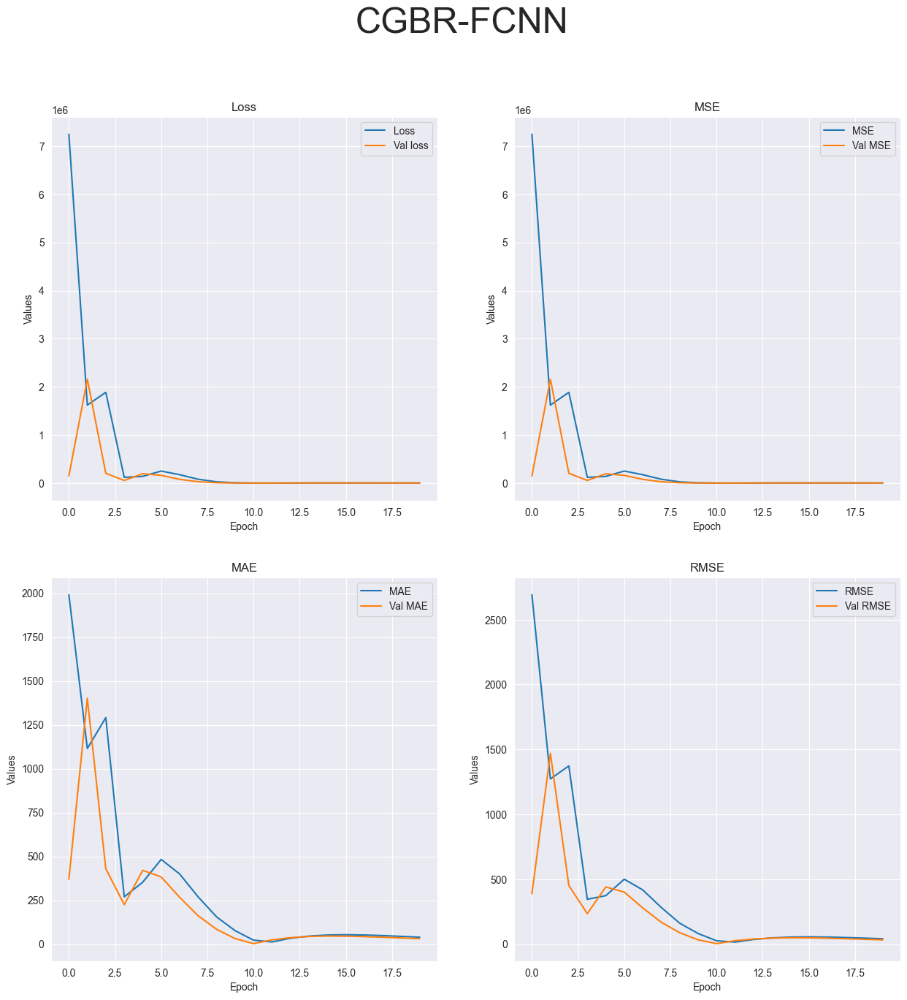

R-squared value: -3005.8343


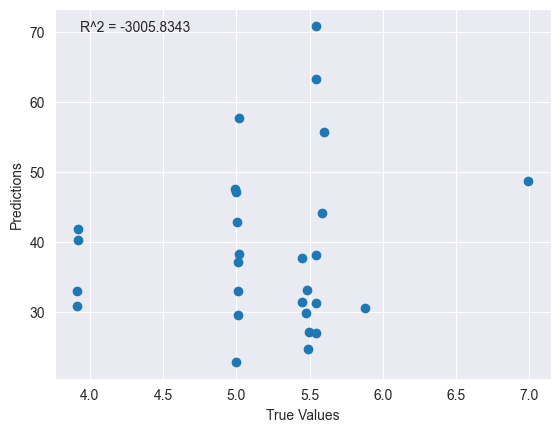

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_31 (Dense)            (None, 128)               384       
                                                                 
 dense_32 (Dense)            (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


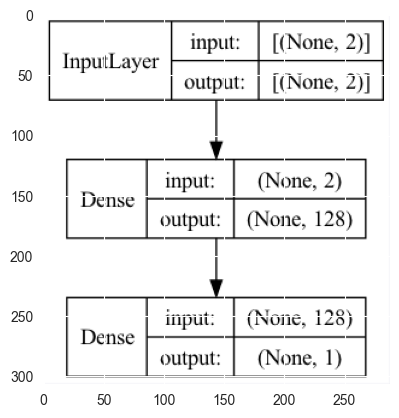

2023-05-02 01:45:37.937284: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 36ms/step - loss: 354886912.0000 - mse: 354886912.0000 - mae: 18016.1777 - root_mean_squared_error: 18838.4434


2023-05-02 01:45:38.333302: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [354886912.0, 354886912.0, 18016.177734375, 18838.443359375]
['loss', 'mse', 'mae', 'root_mean_squared_error']


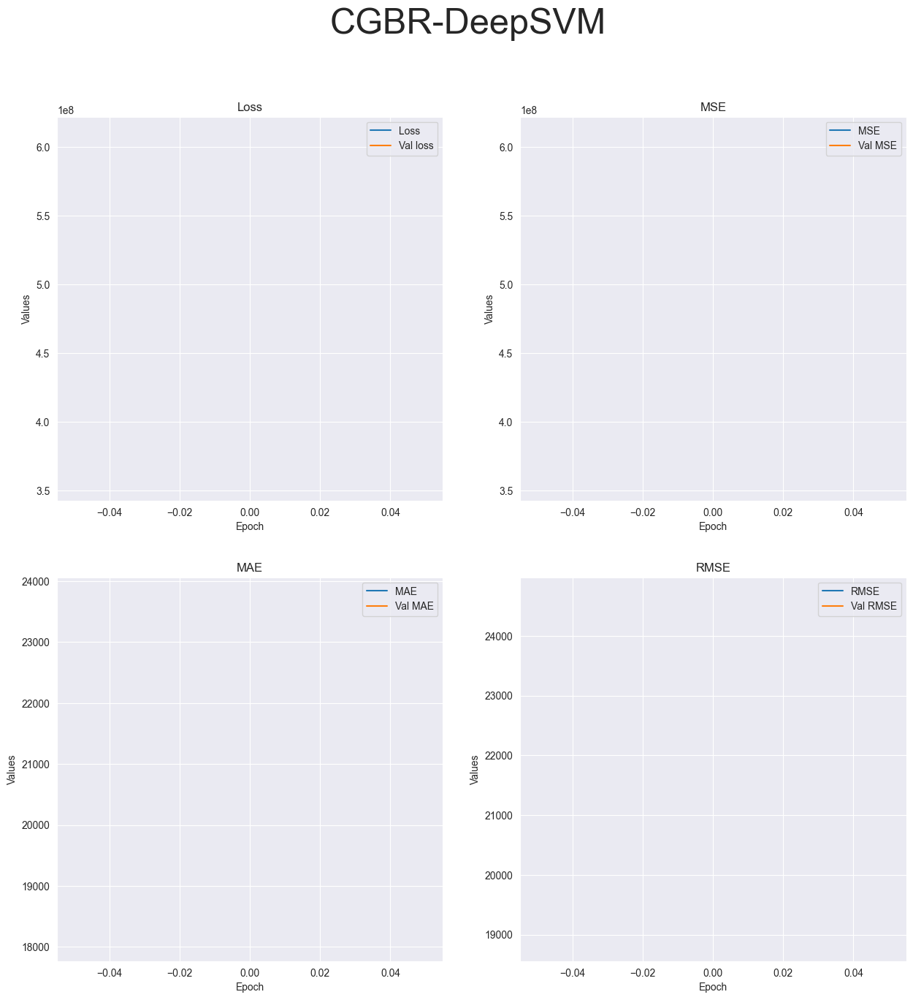

R-squared value: -1043514072.0389


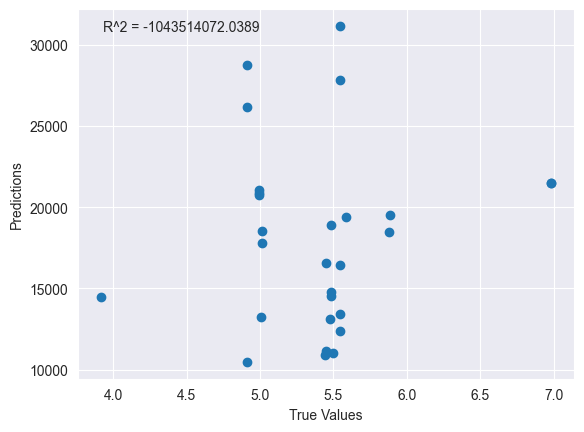

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_33 (Dense)            (None, 128)               384       
                                                                 
 dense_34 (Dense)            (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


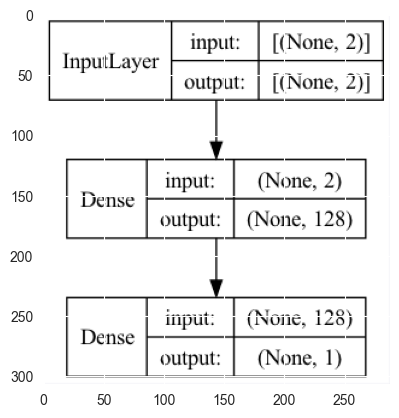

Epoch 1/4
3/3 [==============================] - ETA: 0s - loss: 596533824.0000 - mse: 596533824.0000 - mae: 23421.9941 - root_mean_squared_error: 24424.0410

2023-05-02 01:45:40.004819: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 108ms/step - loss: 596533824.0000 - mse: 596533824.0000 - mae: 23421.9941 - root_mean_squared_error: 24424.0410 - val_loss: 343871680.0000 - val_mse: 343871680.0000 - val_mae: 17755.6934 - val_root_mean_squared_error: 18543.7773
Epoch 2/4
3/3 [==============================] - 0s 19ms/step - loss: 235015712.0000 - mse: 235015712.0000 - mae: 14769.4414 - root_mean_squared_error: 15330.2227 - val_loss: 133592216.0000 - val_mse: 133592216.0000 - val_mae: 11066.8154 - val_root_mean_squared_error: 11558.2100
Epoch 3/4
3/3 [==============================] - 0s 19ms/step - loss: 93618480.0000 - mse: 93618480.0000 - mae: 9240.5508 - root_mean_squared_error: 9675.6641 - val_loss: 51437580.0000 - val_mse: 51437580.0000 - val_mae: 6866.9062 - val_root_mean_squared_error: 7171.9995
Epoch 4/4


2023-05-02 01:45:40.261802: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 31ms/step - loss: 25569886.0000 - mse: 25569886.0000 - mae: 4852.3110 - root_mean_squared_error: 5056.6675
Test loss: [25569886.0, 25569886.0, 4852.31103515625, 5056.66748046875]
['loss', 'mse', 'mae', 'root_mean_squared_error']


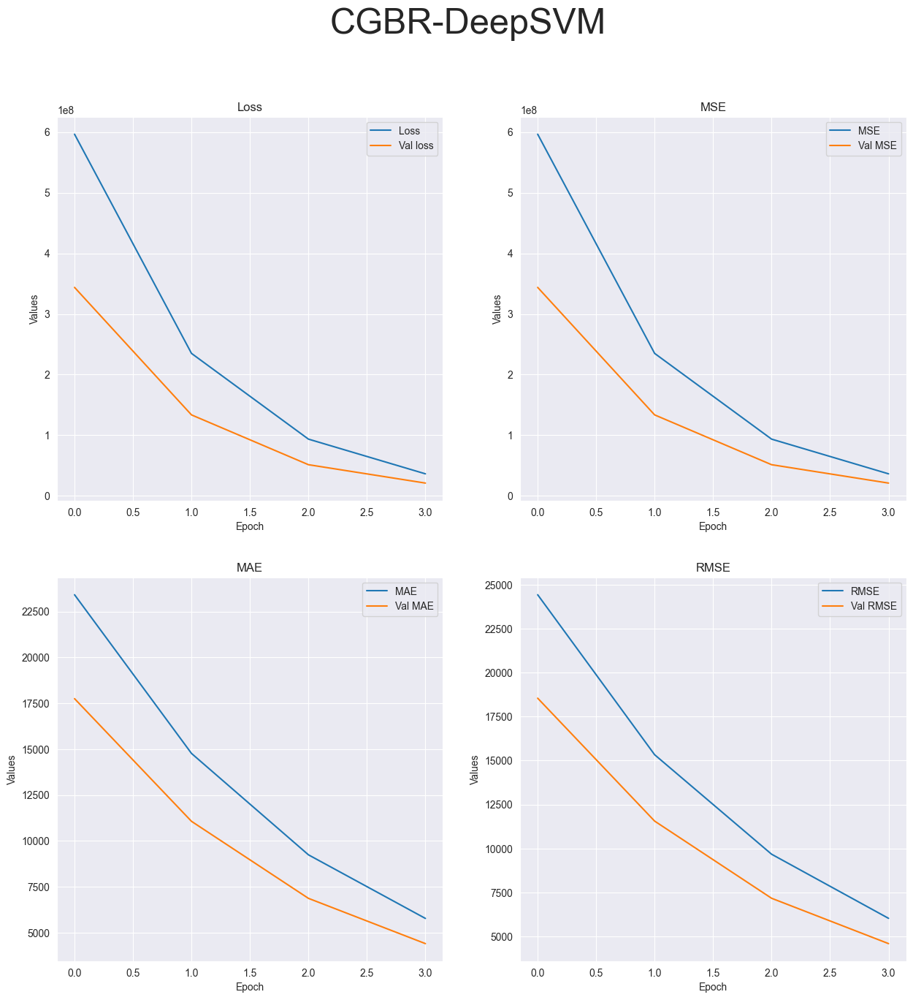

R-squared value: -81906702.5574


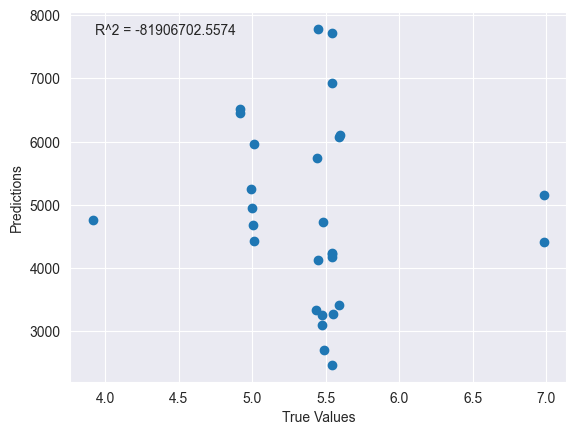

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_35 (Dense)            (None, 128)               384       
                                                                 
 dense_36 (Dense)            (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


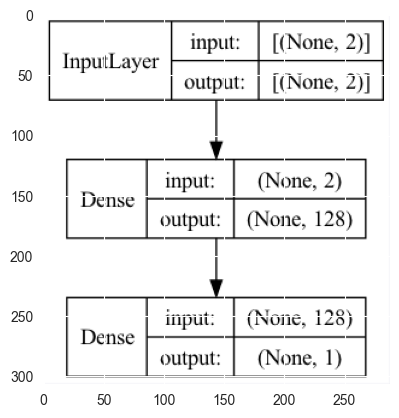

Epoch 1/10
3/3 [==============================] - ETA: 0s - loss: 681052352.0000 - mse: 681052352.0000 - mae: 24876.4355 - root_mean_squared_error: 26096.9805

2023-05-02 01:45:41.694595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 100ms/step - loss: 681052352.0000 - mse: 681052352.0000 - mae: 24876.4355 - root_mean_squared_error: 26096.9805 - val_loss: 312881088.0000 - val_mse: 312881088.0000 - val_mae: 17194.1758 - val_root_mean_squared_error: 17688.4453
Epoch 2/10
3/3 [==============================] - 0s 22ms/step - loss: 273639456.0000 - mse: 273639456.0000 - mae: 15748.6484 - root_mean_squared_error: 16542.0508 - val_loss: 121707728.0000 - val_mse: 121707728.0000 - val_mae: 10723.7197 - val_root_mean_squared_error: 11032.1221
Epoch 3/10
3/3 [==============================] - 0s 19ms/step - loss: 105455120.0000 - mse: 105455120.0000 - mae: 9802.2041 - root_mean_squared_error: 10269.1348 - val_loss: 47472564.0000 - val_mse: 47472564.0000 - val_mae: 6697.2988 - val_root_mean_squared_error: 6890.0337
Epoch 4/10
1/3 [=========>....................] - ETA: 0s - loss: 56955768.0000 - mse: 56955768.0000 - mae: 7229.3438 - root_mean_squared_error: 7546.9043

2023-05-02 01:45:41.962691: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 28ms/step - loss: 41817464.0000 - mse: 41817464.0000 - mae: 6162.5835 - root_mean_squared_error: 6466.6426 - val_loss: 19628048.0000 - val_mse: 19628048.0000 - val_mae: 4306.3120 - val_root_mean_squared_error: 4430.3555
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 17662390.0000 - mse: 17662390.0000 - mae: 4016.8516 - root_mean_squared_error: 4202.6646 - val_loss: 9068558.0000 - val_mse: 9068558.0000 - val_mae: 2926.9939 - val_root_mean_squared_error: 3011.4045
Epoch 6/10
3/3 [==============================] - 0s 16ms/step - loss: 8317845.5000 - mse: 8317845.5000 - mae: 2774.9292 - root_mean_squared_error: 2884.0676 - val_loss: 4861060.0000 - val_mse: 4861060.0000 - val_mae: 2142.9031 - val_root_mean_squared_error: 2204.7812
Epoch 7/10
3/3 [==============================] - 0s 18ms/step - loss: 4727912.0000 - mse: 4727912.0000 - mae: 2084.1399 - root_mean_squared_error: 2174.3762 - val_loss: 3014868.5000 - val_mse: 3014

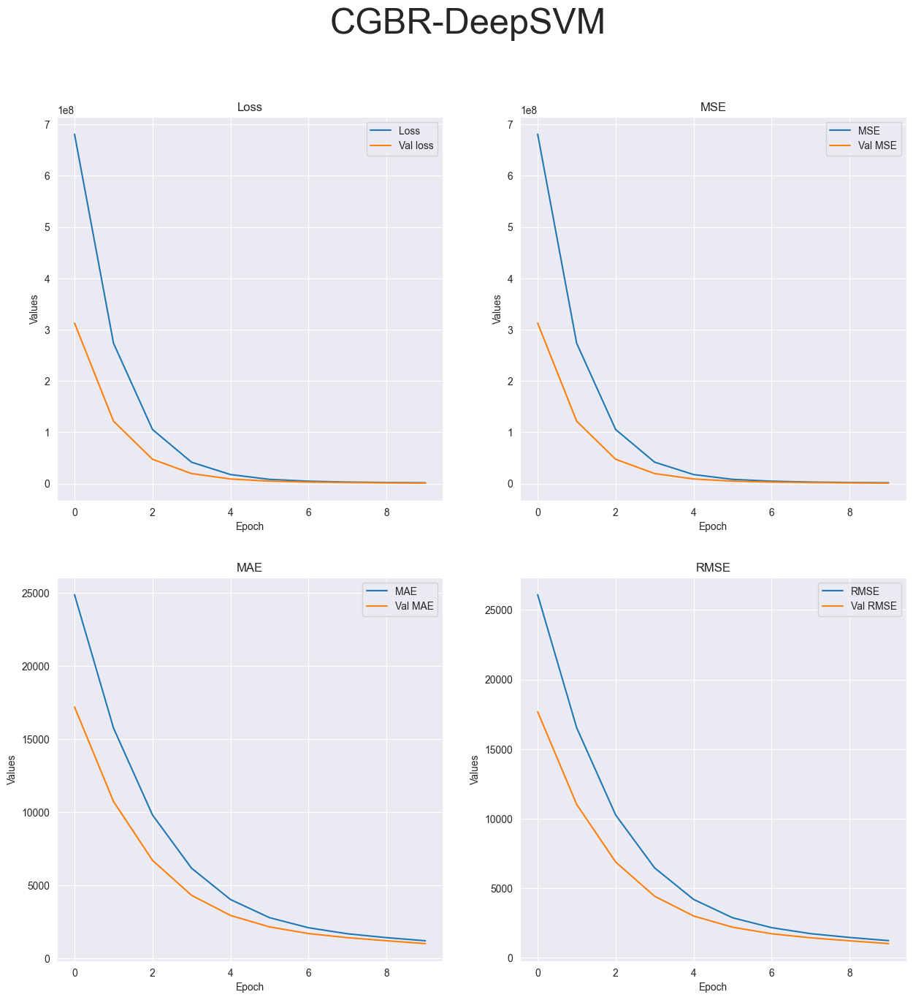

R-squared value: -3017088.1745


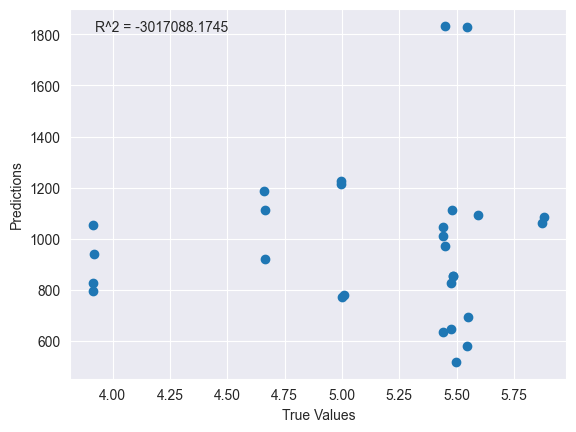

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_37 (Dense)            (None, 128)               384       
                                                                 
 dense_38 (Dense)            (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


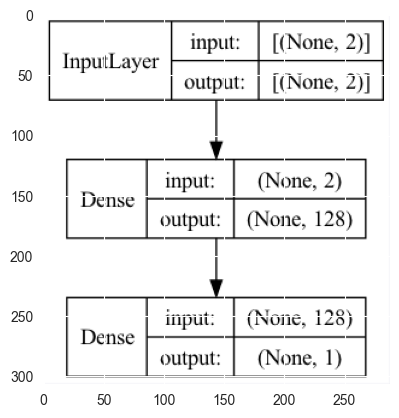

Epoch 1/20
1/3 [=========>....................] - ETA: 0s - loss: 807922560.0000 - mse: 807922560.0000 - mae: 27548.7754 - root_mean_squared_error: 28423.9785

2023-05-02 01:45:43.578458: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 93ms/step - loss: 612922176.0000 - mse: 612922176.0000 - mae: 23680.6016 - root_mean_squared_error: 24757.2656 - val_loss: 439335904.0000 - val_mse: 439335904.0000 - val_mae: 19886.9160 - val_root_mean_squared_error: 20960.3418
Epoch 2/20
3/3 [==============================] - 0s 22ms/step - loss: 249574432.0000 - mse: 249574432.0000 - mae: 15071.6514 - root_mean_squared_error: 15797.9248 - val_loss: 173090432.0000 - val_mse: 173090432.0000 - val_mae: 12482.3789 - val_root_mean_squared_error: 13156.3838
Epoch 3/20
3/3 [==============================] - 0s 17ms/step - loss: 97252728.0000 - mse: 97252728.0000 - mae: 9430.7861 - root_mean_squared_error: 9861.6797 - val_loss: 68518704.0000 - val_mse: 68518704.0000 - val_mae: 7853.3159 - val_root_mean_squared_error: 8277.6025
Epoch 4/20
1/3 [=========>....................] - ETA: 0s - loss: 50870520.0000 - mse: 50870520.0000 - mae: 6895.7051 - root_mean_squared_error: 7132.3574

2023-05-02 01:45:43.819570: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 19ms/step - loss: 38763772.0000 - mse: 38763772.0000 - mae: 5971.9775 - root_mean_squared_error: 6226.0557 - val_loss: 28733384.0000 - val_mse: 28733384.0000 - val_mae: 5085.3950 - val_root_mean_squared_error: 5360.3530
Epoch 5/20
3/3 [==============================] - 0s 17ms/step - loss: 16555113.0000 - mse: 16555113.0000 - mae: 3914.3892 - root_mean_squared_error: 4068.7976 - val_loss: 13389384.0000 - val_mse: 13389384.0000 - val_mae: 3471.2822 - val_root_mean_squared_error: 3659.1506
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 7936725.0000 - mse: 7936725.0000 - mae: 2716.6428 - root_mean_squared_error: 2817.2195 - val_loss: 7164079.5000 - val_mse: 7164079.5000 - val_mae: 2539.0181 - val_root_mean_squared_error: 2676.5798
Epoch 7/20
3/3 [==============================] - 0s 18ms/step - loss: 4454388.5000 - mse: 4454388.5000 - mae: 2032.8533 - root_mean_squared_error: 2110.5422 - val_loss: 4405045.5000 - val_mse: 44

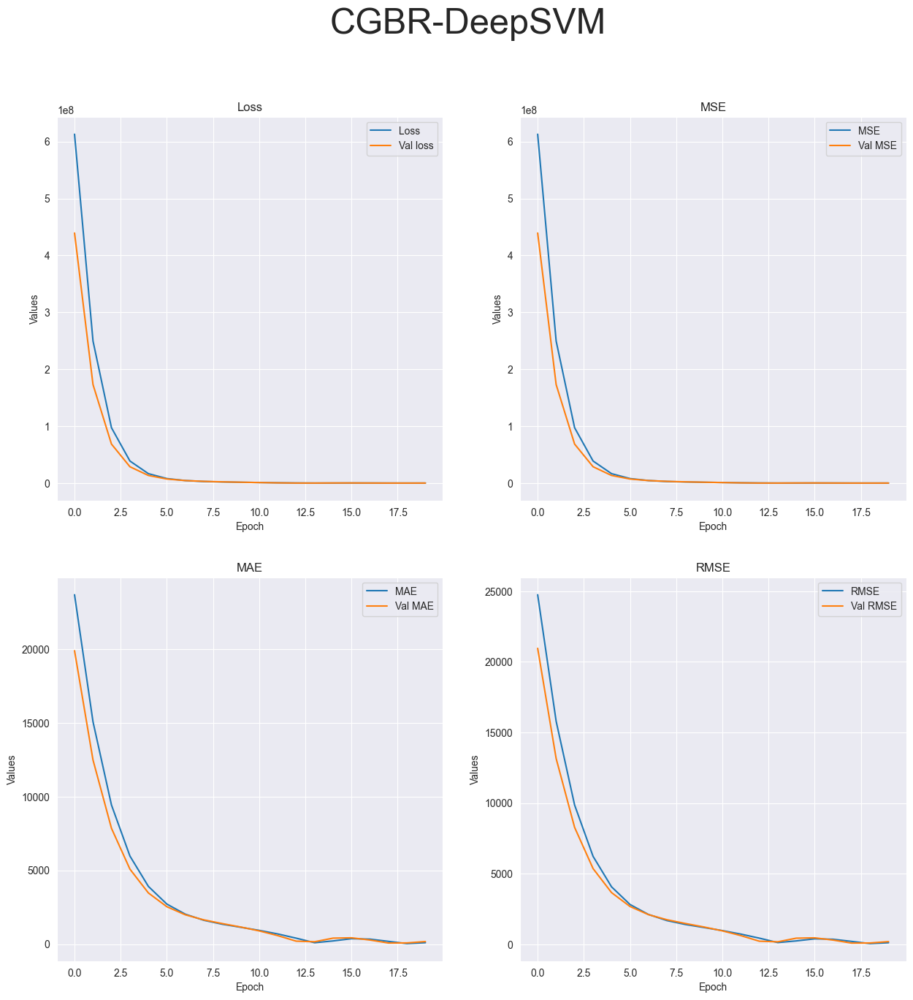

R-squared value: -44325.1090


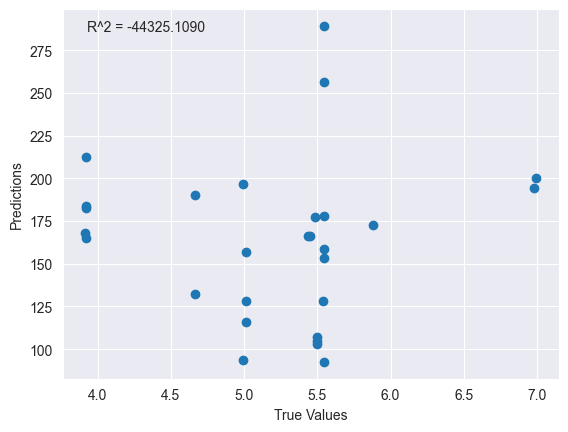

Running tests on FBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_39 (Dense)            (None, 64)                512       
                                                                 
 dropout_10 (Dropout)        (None, 64)                0         
                                                                 
 dense_40 (Dense)            (None, 32)                2080      
                                                                 
 dropout_11 (Dropout)        (None, 32)            

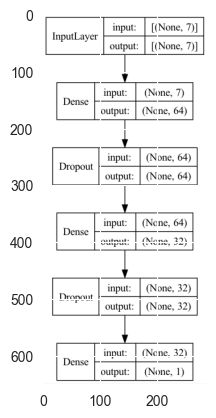

2023-05-02 01:45:46.278830: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 36ms/step - loss: 6.9928 - mse: 6.9928 - mae: 2.1503 - root_mean_squared_error: 2.6444
Test loss: [6.992804050445557, 6.992804050445557, 2.15031099319458, 2.6443910598754883]
['loss', 'mse', 'mae', 'root_mean_squared_error']


2023-05-02 01:45:46.784693: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


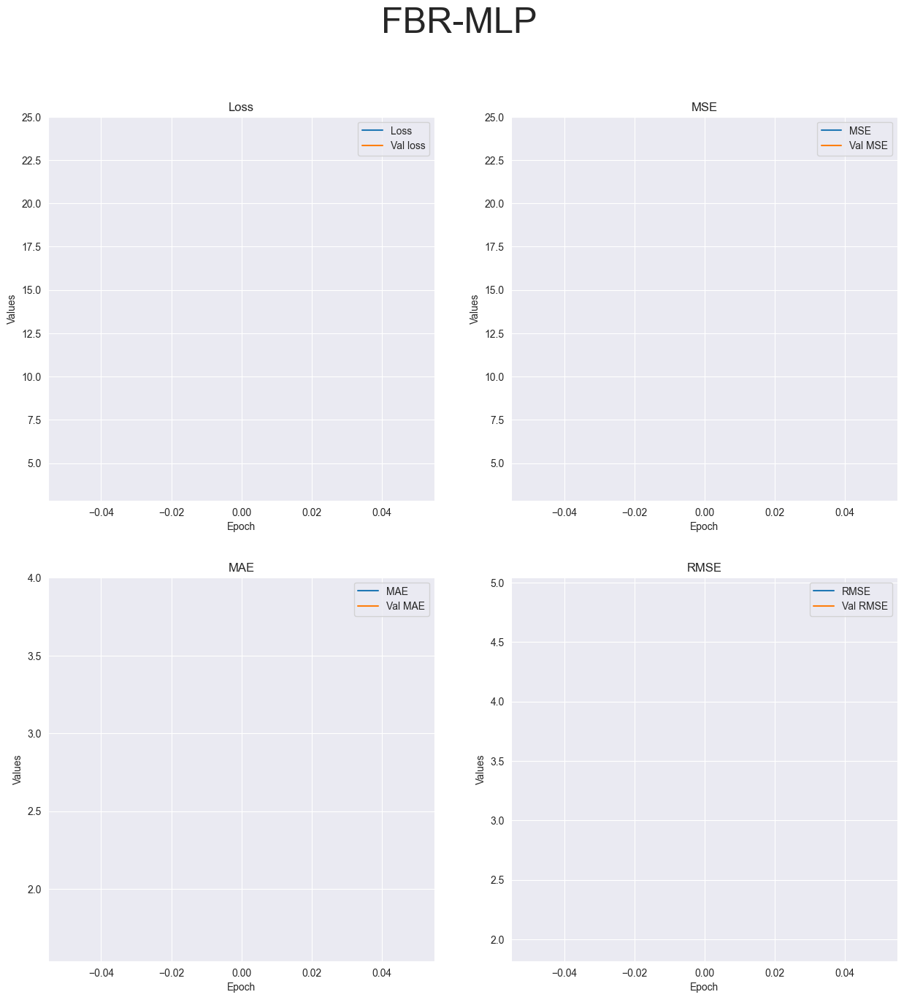

R-squared value: -14.8072


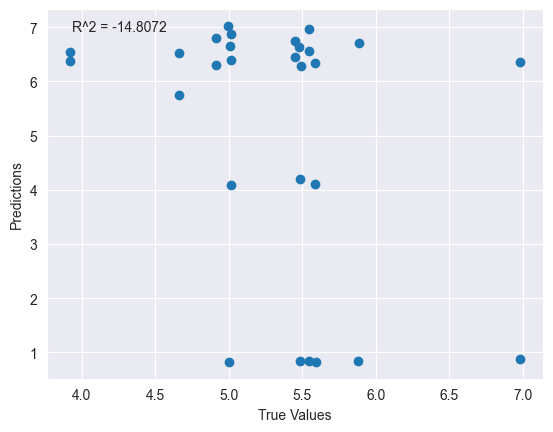

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_42 (Dense)            (None, 64)                512       
                                                                 
 dropout_12 (Dropout)        (None, 64)                0         
                                                                 
 dense_43 (Dense)            (None, 32)                2080      
                                                                 
 dropout_13 (Dropout)        (None, 32)                0         
                                                

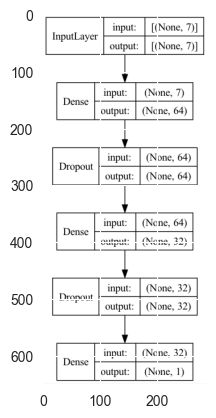

Epoch 1/4
1/3 [=========>....................] - ETA: 0s - loss: 37.5520 - mse: 37.5520 - mae: 5.2668 - root_mean_squared_error: 6.1280

2023-05-02 01:45:47.948956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 132ms/step - loss: 23.7248 - mse: 23.7248 - mae: 3.8924 - root_mean_squared_error: 4.8708 - val_loss: 5.0991 - val_mse: 5.0991 - val_mae: 2.0737 - val_root_mean_squared_error: 2.2581
Epoch 2/4
3/3 [==============================] - 0s 20ms/step - loss: 12.0641 - mse: 12.0641 - mae: 2.9748 - root_mean_squared_error: 3.4733 - val_loss: 1.4584 - val_mse: 1.4584 - val_mae: 0.9893 - val_root_mean_squared_error: 1.2076
Epoch 3/4
3/3 [==============================] - 0s 20ms/step - loss: 5.7605 - mse: 5.7605 - mae: 1.9188 - root_mean_squared_error: 2.4001 - val_loss: 4.5195 - val_mse: 4.5195 - val_mae: 1.9358 - val_root_mean_squared_error: 2.1259
Epoch 4/4
1/3 [=========>....................] - ETA: 0s - loss: 7.2541 - mse: 7.2541 - mae: 2.3425 - root_mean_squared_error: 2.6934

2023-05-02 01:45:48.312725: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 39ms/step - loss: 2.1351 - mse: 2.1351 - mae: 1.2716 - root_mean_squared_error: 1.4612
Test loss: [2.1350808143615723, 2.1350808143615723, 1.2716251611709595, 1.4611915349960327]
['loss', 'mse', 'mae', 'root_mean_squared_error']


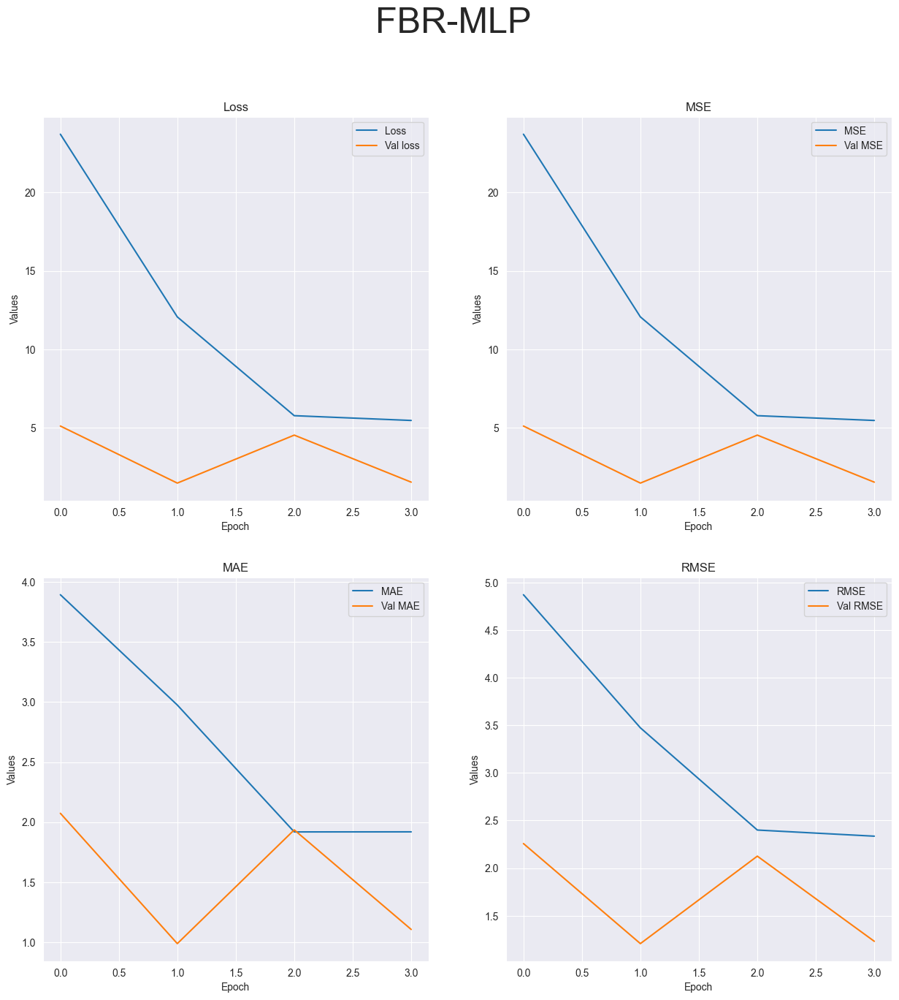

R-squared value: -2.4462


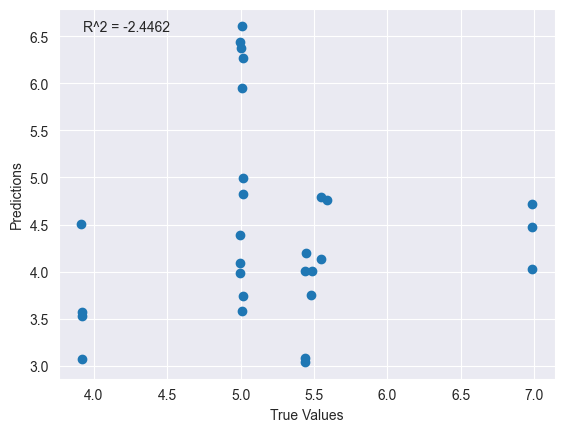

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_45 (Dense)            (None, 64)                512       
                                                                 
 dropout_14 (Dropout)        (None, 64)                0         
                                                                 
 dense_46 (Dense)            (None, 32)                2080      
                                                                 
 dropout_15 (Dropout)        (None, 32)                0         
                                               

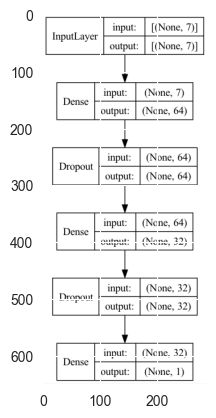

Epoch 1/10
1/3 [=========>....................] - ETA: 0s - loss: 35.6159 - mse: 35.6159 - mae: 5.1197 - root_mean_squared_error: 5.9679

2023-05-02 01:45:49.766201: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 117ms/step - loss: 22.4767 - mse: 22.4767 - mae: 3.8644 - root_mean_squared_error: 4.7410 - val_loss: 7.2852 - val_mse: 7.2852 - val_mae: 2.3926 - val_root_mean_squared_error: 2.6991
Epoch 2/10
3/3 [==============================] - 0s 26ms/step - loss: 12.8463 - mse: 12.8463 - mae: 2.9657 - root_mean_squared_error: 3.5842 - val_loss: 2.0910 - val_mse: 2.0910 - val_mae: 1.2560 - val_root_mean_squared_error: 1.4460
Epoch 3/10
3/3 [==============================] - 0s 23ms/step - loss: 5.2696 - mse: 5.2696 - mae: 1.8598 - root_mean_squared_error: 2.2956 - val_loss: 2.6470 - val_mse: 2.6470 - val_mae: 1.4448 - val_root_mean_squared_error: 1.6270
Epoch 4/10


2023-05-02 01:45:50.112796: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 21ms/step - loss: 3.6772 - mse: 3.6772 - mae: 1.5808 - root_mean_squared_error: 1.9176 - val_loss: 1.5048 - val_mse: 1.5048 - val_mae: 1.0599 - val_root_mean_squared_error: 1.2267
Epoch 5/10
3/3 [==============================] - 0s 22ms/step - loss: 2.3782 - mse: 2.3782 - mae: 1.2129 - root_mean_squared_error: 1.5421 - val_loss: 1.2327 - val_mse: 1.2327 - val_mae: 0.7925 - val_root_mean_squared_error: 1.1103
Epoch 6/10
3/3 [==============================] - 0s 19ms/step - loss: 3.3775 - mse: 3.3775 - mae: 1.4951 - root_mean_squared_error: 1.8378 - val_loss: 1.8716 - val_mse: 1.8716 - val_mae: 1.0178 - val_root_mean_squared_error: 1.3681
Epoch 7/10
3/3 [==============================] - 0s 18ms/step - loss: 2.4906 - mse: 2.4906 - mae: 1.2437 - root_mean_squared_error: 1.5782 - val_loss: 2.6396 - val_mse: 2.6396 - val_mae: 1.4540 - val_root_mean_squared_error: 1.6247
Epoch 8/10
3/3 [==============================] - 0s 27ms/step - loss: 1.8099 -

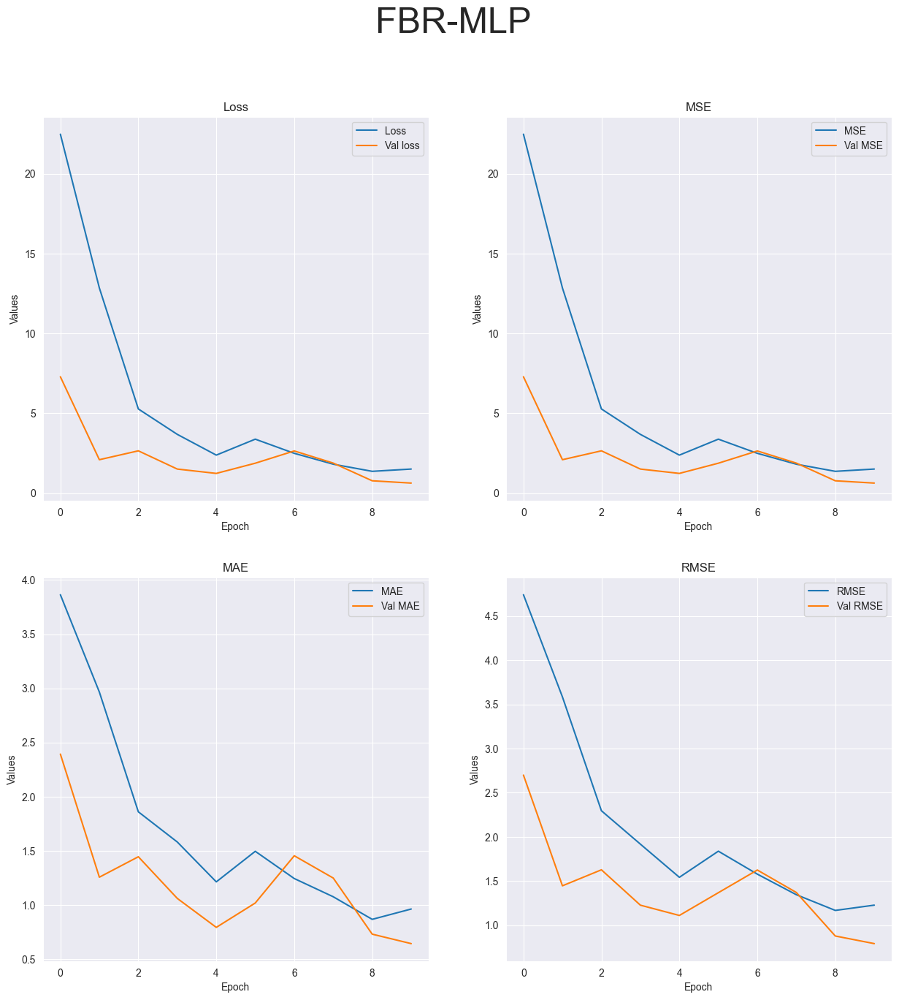

R-squared value: -0.8272


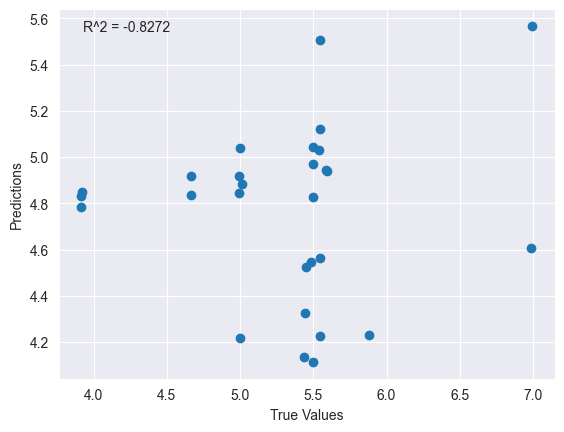

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 64)                512       
                                                                 
 dropout_16 (Dropout)        (None, 64)                0         
                                                                 
 dense_49 (Dense)            (None, 32)                2080      
                                                                 
 dropout_17 (Dropout)        (None, 32)                0         
                                               

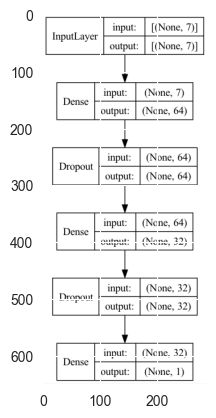

Epoch 1/20
1/3 [=========>....................] - ETA: 0s - loss: 43.2981 - mse: 43.2981 - mae: 5.6666 - root_mean_squared_error: 6.5801

2023-05-02 01:45:51.949095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 368ms/step - loss: 22.8629 - mse: 22.8629 - mae: 3.7169 - root_mean_squared_error: 4.7815 - val_loss: 3.1548 - val_mse: 3.1548 - val_mae: 1.5031 - val_root_mean_squared_error: 1.7762
Epoch 2/20
3/3 [==============================] - 0s 29ms/step - loss: 10.0662 - mse: 10.0662 - mae: 2.5940 - root_mean_squared_error: 3.1727 - val_loss: 1.9033 - val_mse: 1.9033 - val_mae: 1.1512 - val_root_mean_squared_error: 1.3796
Epoch 3/20
1/3 [=========>....................] - ETA: 0s - loss: 2.8168 - mse: 2.8168 - mae: 1.3262 - root_mean_squared_error: 1.6783

2023-05-02 01:45:52.800066: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 31ms/step - loss: 3.0679 - mse: 3.0679 - mae: 1.3283 - root_mean_squared_error: 1.7516 - val_loss: 1.5362 - val_mse: 1.5362 - val_mae: 1.1202 - val_root_mean_squared_error: 1.2394
Epoch 4/20
3/3 [==============================] - 0s 29ms/step - loss: 3.7810 - mse: 3.7810 - mae: 1.5281 - root_mean_squared_error: 1.9445 - val_loss: 1.2312 - val_mse: 1.2312 - val_mae: 0.9861 - val_root_mean_squared_error: 1.1096
Epoch 5/20
3/3 [==============================] - 0s 22ms/step - loss: 2.1817 - mse: 2.1817 - mae: 1.0983 - root_mean_squared_error: 1.4770 - val_loss: 0.9518 - val_mse: 0.9518 - val_mae: 0.8069 - val_root_mean_squared_error: 0.9756
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 1.6906 - mse: 1.6906 - mae: 1.0108 - root_mean_squared_error: 1.3002 - val_loss: 1.3444 - val_mse: 1.3444 - val_mae: 0.9951 - val_root_mean_squared_error: 1.1595
Epoch 7/20
3/3 [==============================] - 0s 23ms/step - loss: 2.0268 -

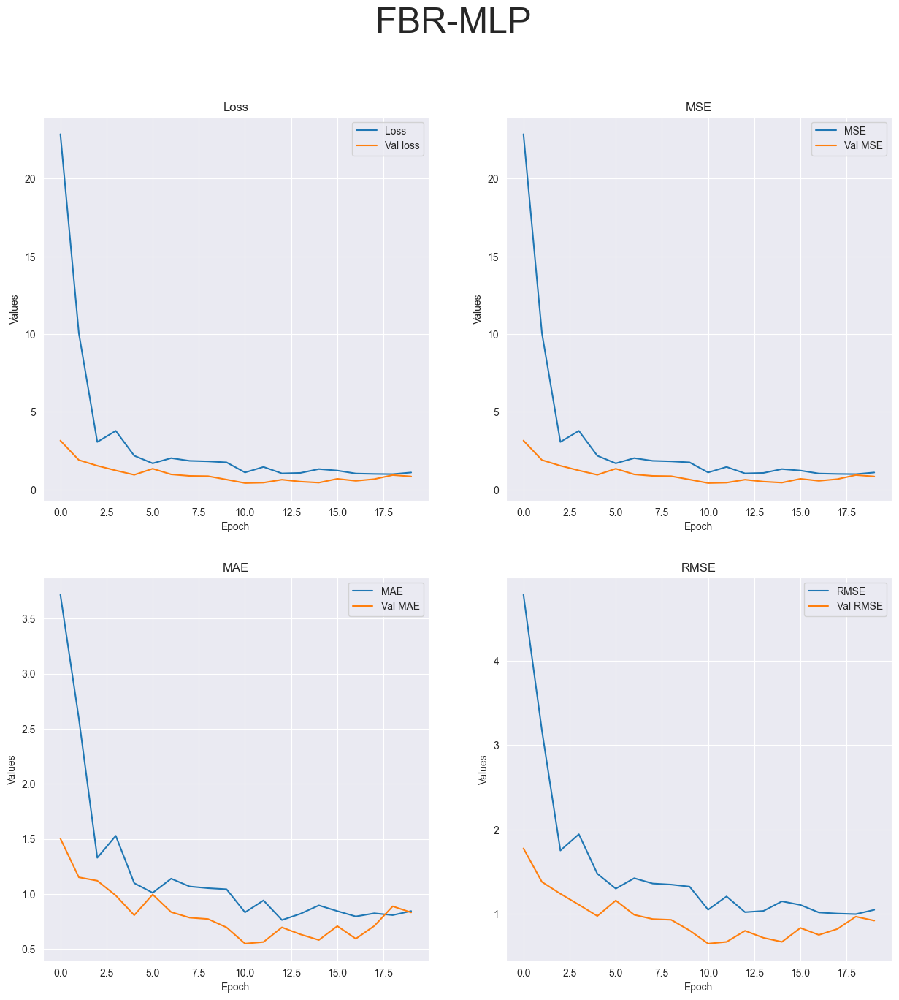

R-squared value: -1.3406


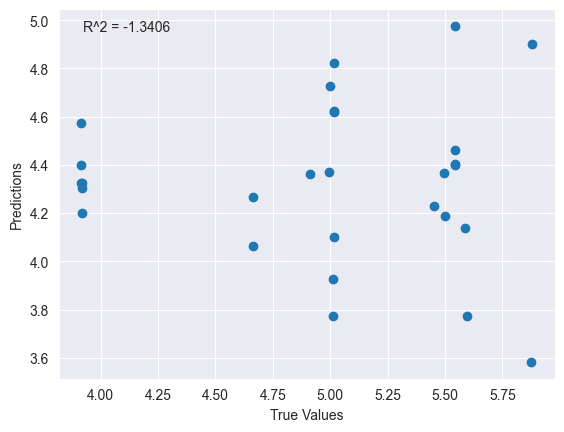

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_51 (Dense)            (None, 64)                512       
                                                                 
 dense_52 (Dense)            (None, 32)                2080      
                                                                 
 dense_53 (Dense)            (None, 16)                528       
                                                                 
 dense_54 (Dense)            (None, 1)                 17        
                    

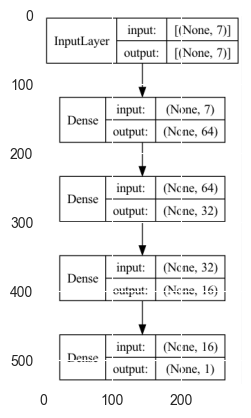

2023-05-02 01:45:55.456449: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 65ms/step - loss: 0.7728 - mse: 0.7728 - mae: 0.7867 - root_mean_squared_error: 0.8791


2023-05-02 01:45:55.829073: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [0.7727651000022888, 0.7727651000022888, 0.7866540551185608, 0.8790705800056458]
['loss', 'mse', 'mae', 'root_mean_squared_error']


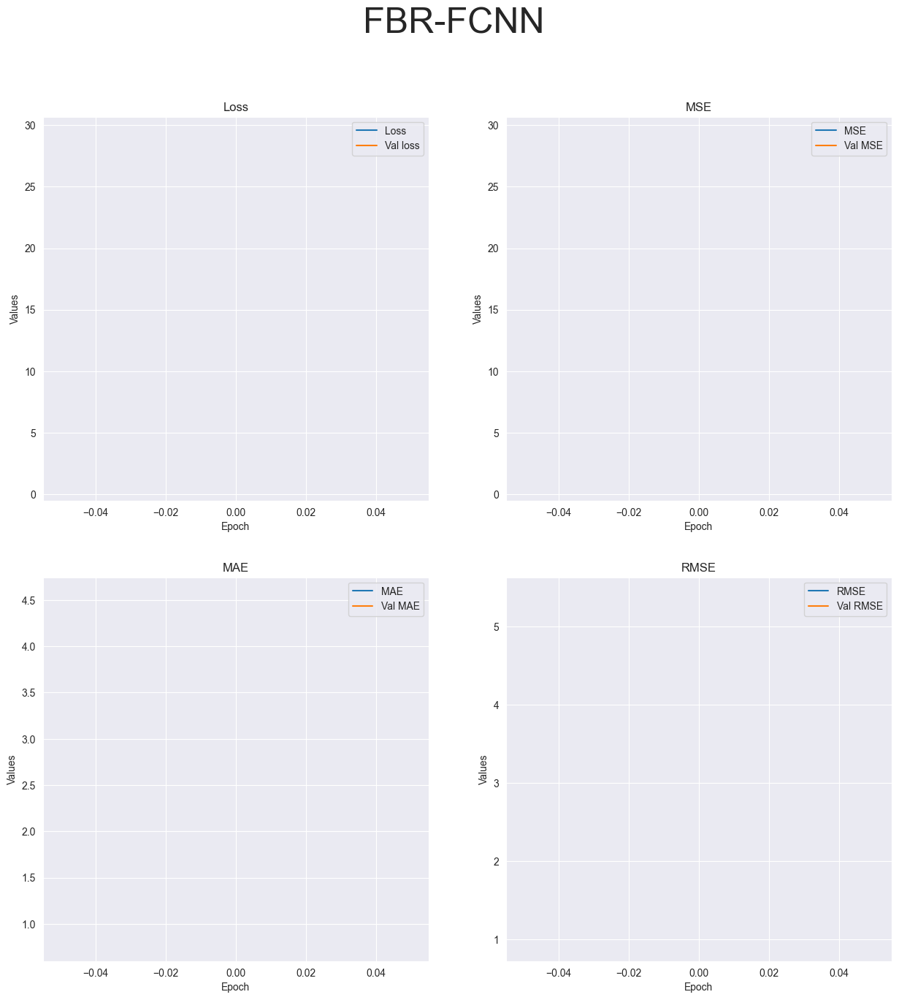

R-squared value: -2.2258


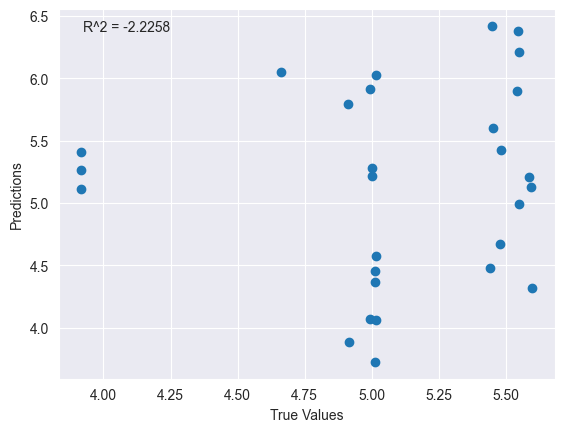

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_55 (Dense)            (None, 64)                512       
                                                                 
 dense_56 (Dense)            (None, 32)                2080      
                                                                 
 dense_57 (Dense)            (None, 16)                528       
                                                                 
 dense_58 (Dense)            (None, 1)                 17        
                                                

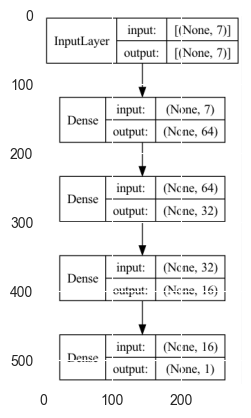

Epoch 1/4


2023-05-02 01:45:57.216235: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 122ms/step - loss: 29.9483 - mse: 29.9483 - mae: 4.6823 - root_mean_squared_error: 5.4725 - val_loss: 2.4341 - val_mse: 2.4341 - val_mae: 1.2789 - val_root_mean_squared_error: 1.5601
Epoch 2/4
3/3 [==============================] - 0s 22ms/step - loss: 5.0974 - mse: 5.0974 - mae: 1.9457 - root_mean_squared_error: 2.2577 - val_loss: 5.9408 - val_mse: 5.9408 - val_mae: 1.9586 - val_root_mean_squared_error: 2.4374
Epoch 3/4
1/3 [=========>....................] - ETA: 0s - loss: 6.3366 - mse: 6.3366 - mae: 2.2181 - root_mean_squared_error: 2.5173

2023-05-02 01:45:57.587508: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 27ms/step - loss: 4.8533 - mse: 4.8533 - mae: 1.8819 - root_mean_squared_error: 2.2030 - val_loss: 1.2108 - val_mse: 1.2108 - val_mae: 0.8656 - val_root_mean_squared_error: 1.1003
Epoch 4/4
1/1 [==============================] - 0s 39ms/step - loss: 0.5986 - mse: 0.5986 - mae: 0.5840 - root_mean_squared_error: 0.7737
Test loss: [0.5986281037330627, 0.5986281037330627, 0.5839871168136597, 0.7737106084823608]
['loss', 'mse', 'mae', 'root_mean_squared_error']


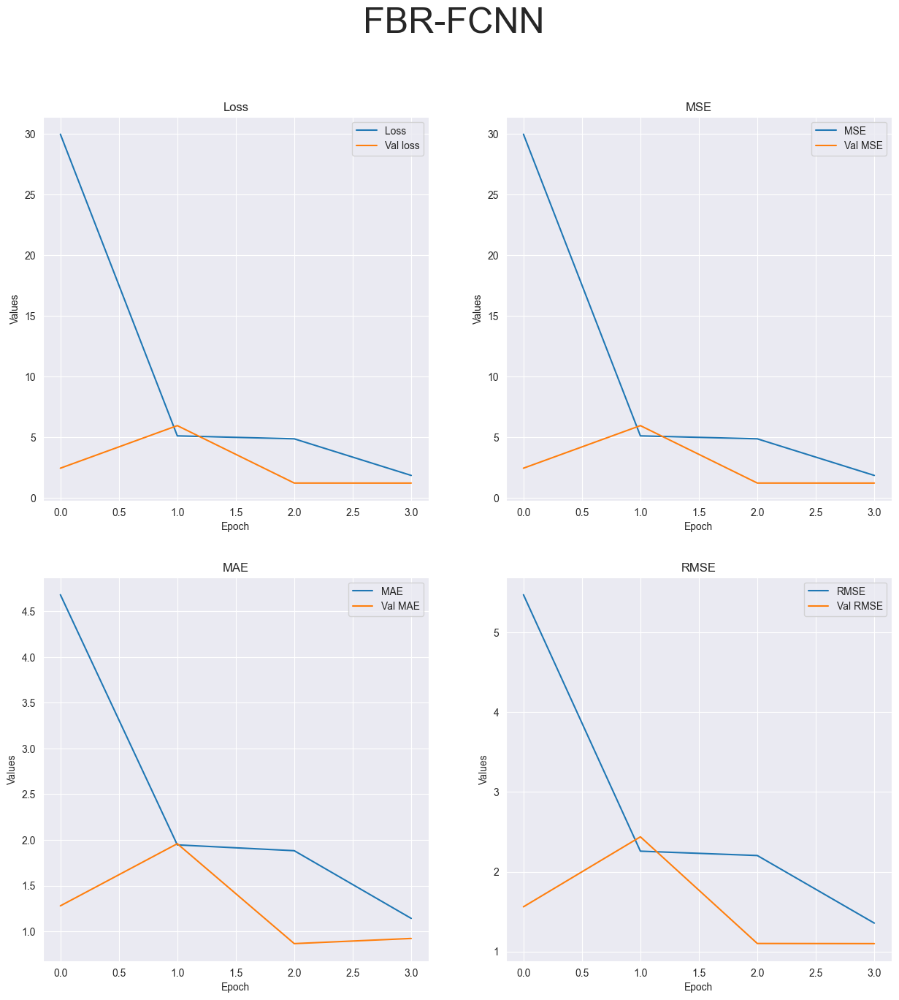

R-squared value: -0.4460


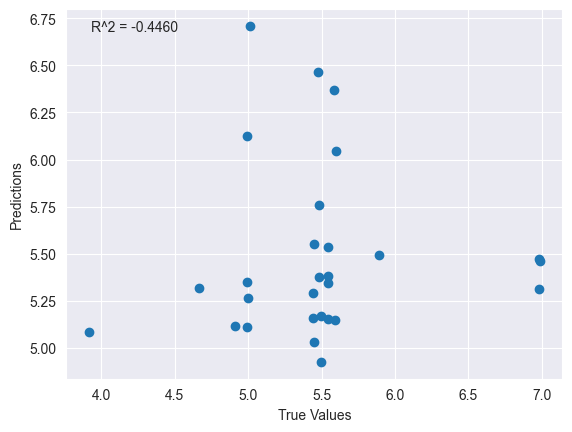

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_59 (Dense)            (None, 64)                512       
                                                                 
 dense_60 (Dense)            (None, 32)                2080      
                                                                 
 dense_61 (Dense)            (None, 16)                528       
                                                                 
 dense_62 (Dense)            (None, 1)                 17        
                                               

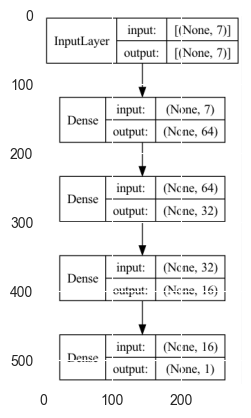

Epoch 1/10
1/3 [=========>....................] - ETA: 0s - loss: 28.2768 - mse: 28.2768 - mae: 4.3369 - root_mean_squared_error: 5.3176

2023-05-02 01:45:59.070507: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 125ms/step - loss: 28.9825 - mse: 28.9825 - mae: 4.5063 - root_mean_squared_error: 5.3835 - val_loss: 2.1376 - val_mse: 2.1376 - val_mae: 1.1913 - val_root_mean_squared_error: 1.4620
Epoch 2/10
3/3 [==============================] - 0s 24ms/step - loss: 4.6468 - mse: 4.6468 - mae: 1.7450 - root_mean_squared_error: 2.1556 - val_loss: 4.5904 - val_mse: 4.5904 - val_mae: 1.6422 - val_root_mean_squared_error: 2.1425
Epoch 3/10
3/3 [==============================] - 0s 20ms/step - loss: 4.5435 - mse: 4.5435 - mae: 1.7793 - root_mean_squared_error: 2.1315 - val_loss: 4.3882 - val_mse: 4.3882 - val_mae: 1.7493 - val_root_mean_squared_error: 2.0948
Epoch 4/10


2023-05-02 01:45:59.436133: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 26ms/step - loss: 2.7516 - mse: 2.7516 - mae: 1.3392 - root_mean_squared_error: 1.6588 - val_loss: 1.7261 - val_mse: 1.7261 - val_mae: 1.0506 - val_root_mean_squared_error: 1.3138
Epoch 5/10
3/3 [==============================] - 0s 19ms/step - loss: 0.8986 - mse: 0.8986 - mae: 0.6844 - root_mean_squared_error: 0.9480 - val_loss: 1.1362 - val_mse: 1.1362 - val_mae: 0.8371 - val_root_mean_squared_error: 1.0659
Epoch 6/10
3/3 [==============================] - 0s 20ms/step - loss: 1.2566 - mse: 1.2566 - mae: 0.8306 - root_mean_squared_error: 1.1210 - val_loss: 1.6294 - val_mse: 1.6294 - val_mae: 1.0213 - val_root_mean_squared_error: 1.2765
Epoch 7/10
3/3 [==============================] - 0s 18ms/step - loss: 1.3255 - mse: 1.3255 - mae: 0.8594 - root_mean_squared_error: 1.1513 - val_loss: 1.1466 - val_mse: 1.1466 - val_mae: 0.8362 - val_root_mean_squared_error: 1.0708
Epoch 8/10
3/3 [==============================] - 0s 26ms/step - loss: 0.7320 -

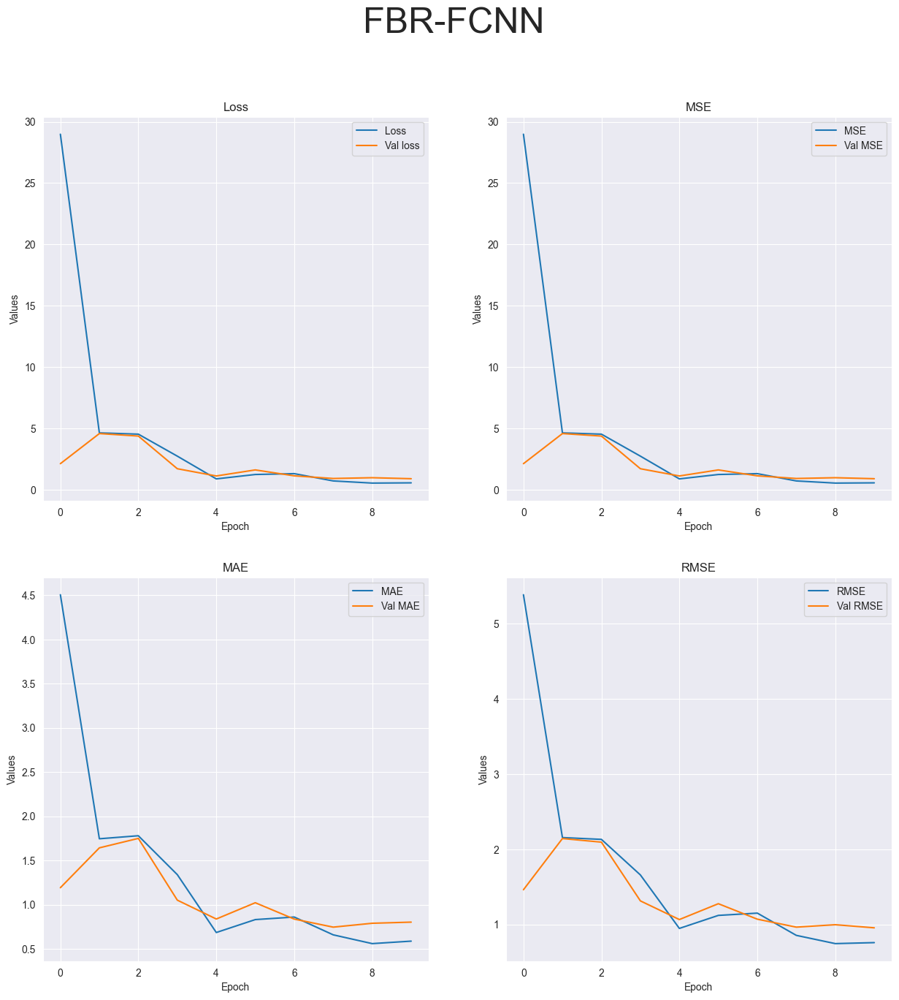

R-squared value: -1.5127


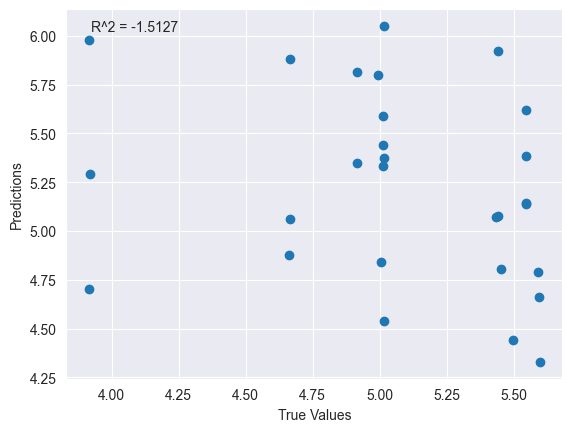

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_63 (Dense)            (None, 64)                512       
                                                                 
 dense_64 (Dense)            (None, 32)                2080      
                                                                 
 dense_65 (Dense)            (None, 16)                528       
                                                                 
 dense_66 (Dense)            (None, 1)                 17        
                                               

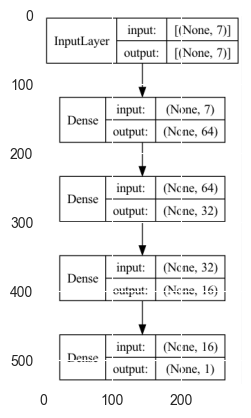

Epoch 1/20
1/3 [=========>....................] - ETA: 0s - loss: 28.6409 - mse: 28.6409 - mae: 4.7442 - root_mean_squared_error: 5.3517

2023-05-02 01:46:01.617800: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 128ms/step - loss: 30.9739 - mse: 30.9739 - mae: 4.7267 - root_mean_squared_error: 5.5654 - val_loss: 1.1331 - val_mse: 1.1331 - val_mae: 0.8256 - val_root_mean_squared_error: 1.0644
Epoch 2/20
3/3 [==============================] - 0s 24ms/step - loss: 3.7964 - mse: 3.7964 - mae: 1.6295 - root_mean_squared_error: 1.9484 - val_loss: 6.8992 - val_mse: 6.8992 - val_mae: 2.2871 - val_root_mean_squared_error: 2.6266
Epoch 3/20
1/3 [=========>....................] - ETA: 0s - loss: 7.0690 - mse: 7.0690 - mae: 2.4432 - root_mean_squared_error: 2.6588

2023-05-02 01:46:01.985204: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 22ms/step - loss: 5.6155 - mse: 5.6155 - mae: 2.0011 - root_mean_squared_error: 2.3697 - val_loss: 2.7188 - val_mse: 2.7188 - val_mae: 1.3073 - val_root_mean_squared_error: 1.6489
Epoch 4/20
3/3 [==============================] - 0s 37ms/step - loss: 2.3415 - mse: 2.3415 - mae: 1.2183 - root_mean_squared_error: 1.5302 - val_loss: 3.0386 - val_mse: 3.0386 - val_mae: 1.4428 - val_root_mean_squared_error: 1.7432
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 1.4942 - mse: 1.4942 - mae: 0.9909 - root_mean_squared_error: 1.2224 - val_loss: 0.9915 - val_mse: 0.9915 - val_mae: 0.7675 - val_root_mean_squared_error: 0.9958
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 0.6774 - mse: 0.6774 - mae: 0.6264 - root_mean_squared_error: 0.8230 - val_loss: 0.5811 - val_mse: 0.5811 - val_mae: 0.5642 - val_root_mean_squared_error: 0.7623
Epoch 7/20
3/3 [==============================] - 0s 17ms/step - loss: 1.2532 -

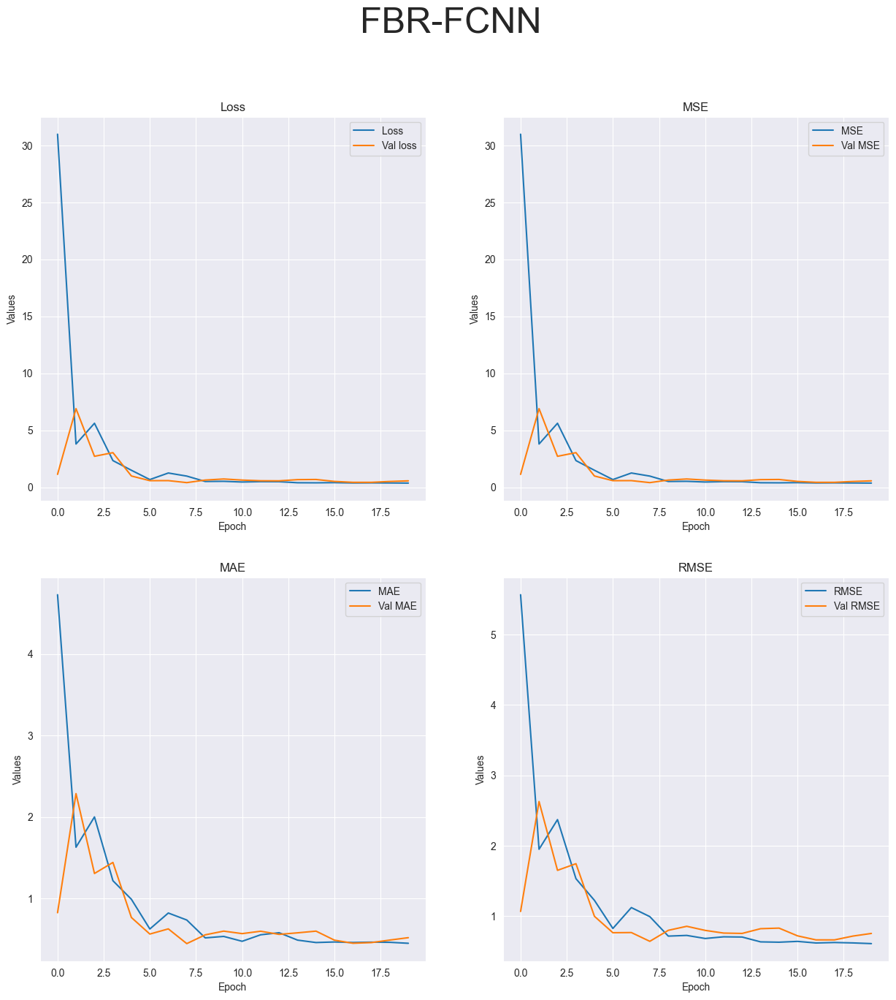

R-squared value: 0.2018


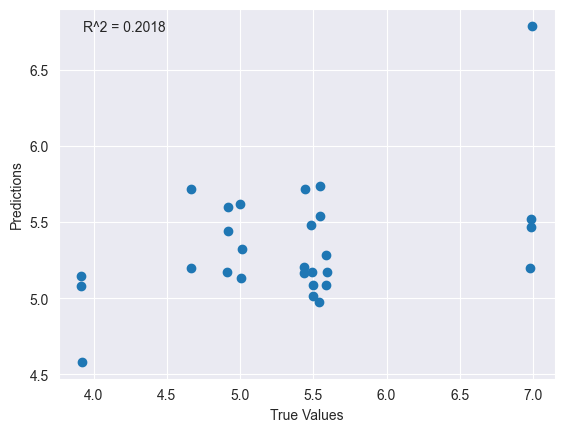

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_67 (Dense)            (None, 128)               1024      
                                                                 
 dense_68 (Dense)            (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


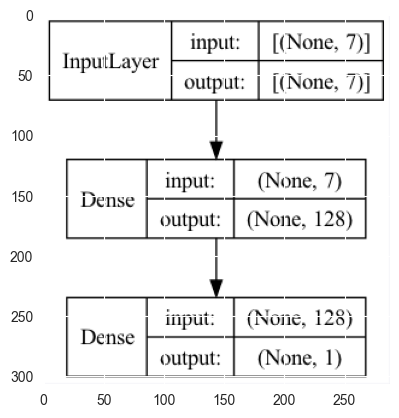

1/3 [=========>....................] - ETA: 0s - loss: 20.2462 - mse: 20.1120 - mae: 3.8320 - root_mean_squared_error: 4.4846

2023-05-02 01:46:04.249928: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 53ms/step - loss: 4.5194 - mse: 4.3846 - mae: 1.7242 - root_mean_squared_error: 2.0939


2023-05-02 01:46:04.642972: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [4.5193915367126465, 4.3846235275268555, 1.724244475364685, 2.093949317932129]
['loss', 'mse', 'mae', 'root_mean_squared_error']


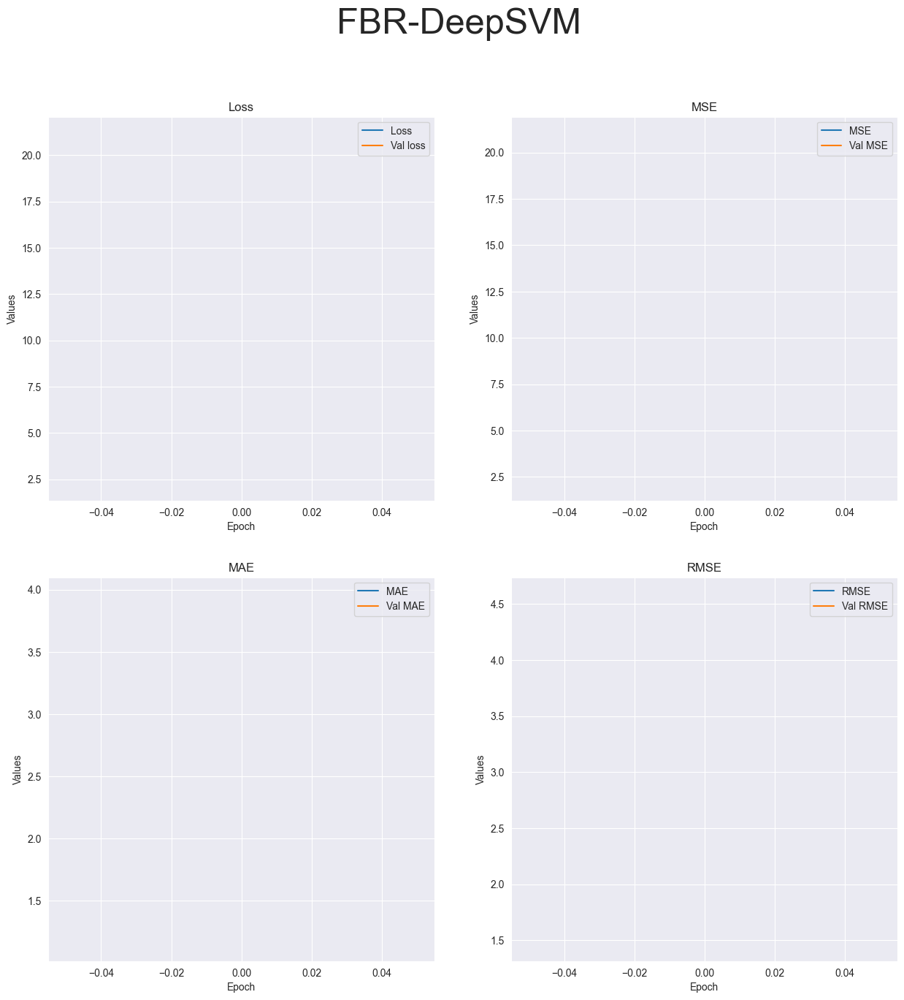

R-squared value: -7.1206


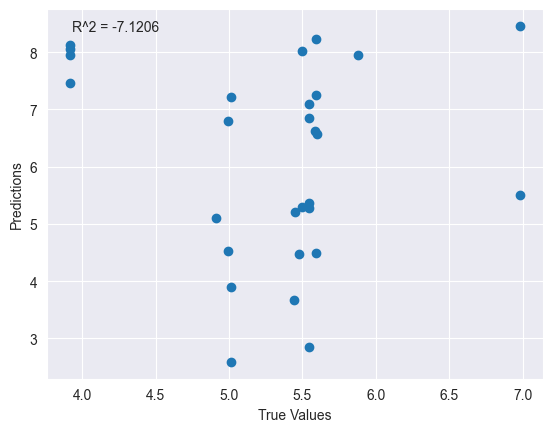

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_69 (Dense)            (None, 128)               1024      
                                                                 
 dense_70 (Dense)            (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


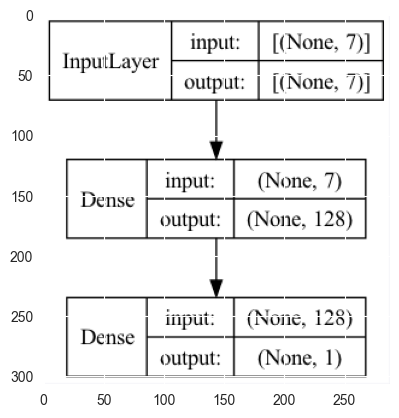

Epoch 1/4
1/3 [=========>....................] - ETA: 0s - loss: 25.1369 - mse: 25.0027 - mae: 4.2224 - root_mean_squared_error: 5.0003

2023-05-02 01:46:05.933036: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 143ms/step - loss: 27.2475 - mse: 27.1118 - mae: 4.4867 - root_mean_squared_error: 5.2069 - val_loss: 5.2997 - val_mse: 5.1648 - val_mae: 2.0484 - val_root_mean_squared_error: 2.2726
Epoch 2/4
3/3 [==============================] - 0s 21ms/step - loss: 10.5381 - mse: 10.4041 - mae: 2.5789 - root_mean_squared_error: 3.2255 - val_loss: 11.8373 - val_mse: 11.7044 - val_mae: 3.1037 - val_root_mean_squared_error: 3.4212
Epoch 3/4
1/3 [=========>....................] - ETA: 0s - loss: 9.5186 - mse: 9.3857 - mae: 2.5091 - root_mean_squared_error: 3.0636

2023-05-02 01:46:06.287400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 27ms/step - loss: 5.7173 - mse: 5.5842 - mae: 1.9355 - root_mean_squared_error: 2.3631 - val_loss: 4.0435 - val_mse: 3.9099 - val_mae: 1.6756 - val_root_mean_squared_error: 1.9773
Epoch 4/4
1/1 [==============================] - 0s 34ms/step - loss: 2.2346 - mse: 2.1018 - mae: 1.3623 - root_mean_squared_error: 1.4498
Test loss: [2.234563112258911, 2.1018149852752686, 1.3622809648513794, 1.4497637748718262]
['loss', 'mse', 'mae', 'root_mean_squared_error']


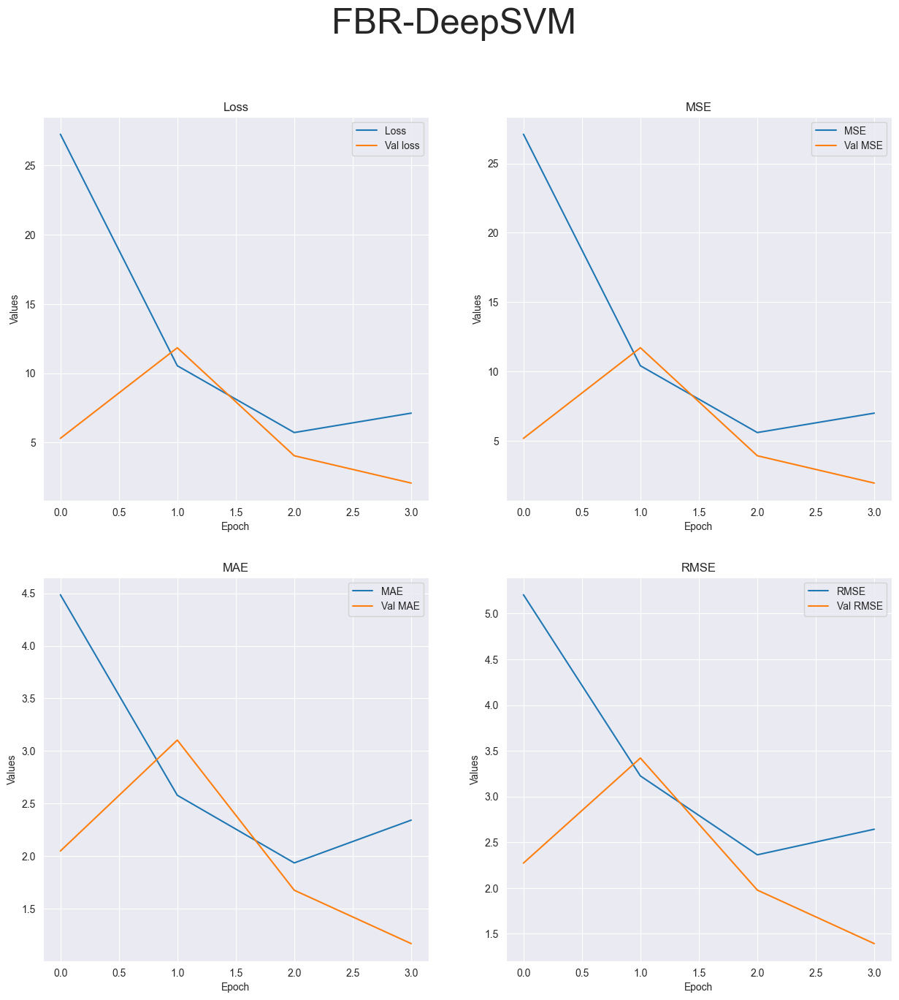

R-squared value: -7.9180


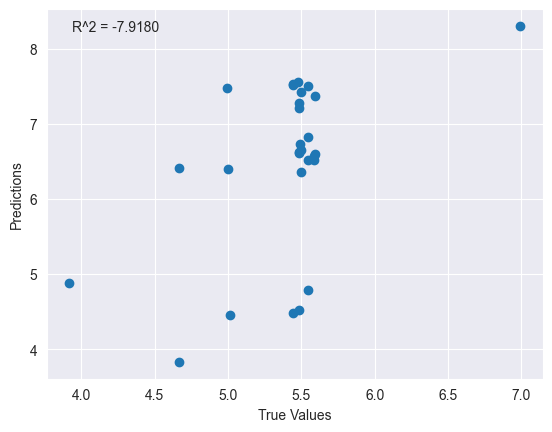

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_71 (Dense)            (None, 128)               1024      
                                                                 
 dense_72 (Dense)            (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


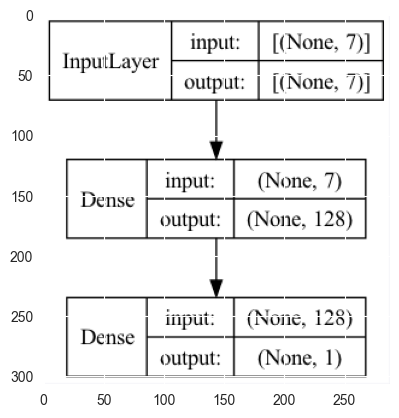

Epoch 1/10
1/3 [=========>....................] - ETA: 1s - loss: 23.5002 - mse: 23.3660 - mae: 4.3706 - root_mean_squared_error: 4.8338

2023-05-02 01:46:08.211377: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 117ms/step - loss: 22.7069 - mse: 22.5712 - mae: 4.1536 - root_mean_squared_error: 4.7509 - val_loss: 5.9671 - val_mse: 5.8320 - val_mae: 2.1033 - val_root_mean_squared_error: 2.4150
Epoch 2/10
3/3 [==============================] - 0s 20ms/step - loss: 7.3727 - mse: 7.2387 - mae: 2.2193 - root_mean_squared_error: 2.6905 - val_loss: 10.5673 - val_mse: 10.4351 - val_mae: 2.5946 - val_root_mean_squared_error: 3.2303
Epoch 3/10
3/3 [==============================] - 0s 18ms/step - loss: 7.0816 - mse: 6.9494 - mae: 2.2014 - root_mean_squared_error: 2.6362 - val_loss: 5.8340 - val_mse: 5.7014 - val_mae: 2.1501 - val_root_mean_squared_error: 2.3878
Epoch 4/10
1/3 [=========>....................] - ETA: 0s - loss: 5.2720 - mse: 5.1394 - mae: 2.0159 - root_mean_squared_error: 2.2670

2023-05-02 01:46:08.534289: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 28ms/step - loss: 7.0532 - mse: 6.9205 - mae: 2.3540 - root_mean_squared_error: 2.6307 - val_loss: 2.8330 - val_mse: 2.7008 - val_mae: 1.3172 - val_root_mean_squared_error: 1.6434
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 2.3573 - mse: 2.2255 - mae: 1.2552 - root_mean_squared_error: 1.4918 - val_loss: 3.6926 - val_mse: 3.5617 - val_mae: 1.6658 - val_root_mean_squared_error: 1.8873
Epoch 6/10
3/3 [==============================] - 0s 17ms/step - loss: 3.6958 - mse: 3.5651 - mae: 1.7244 - root_mean_squared_error: 1.8881 - val_loss: 0.9773 - val_mse: 0.8468 - val_mae: 0.6845 - val_root_mean_squared_error: 0.9202
Epoch 7/10
3/3 [==============================] - 0s 19ms/step - loss: 1.1048 - mse: 0.9743 - mae: 0.7976 - root_mean_squared_error: 0.9871 - val_loss: 2.0461 - val_mse: 1.9158 - val_mae: 1.1880 - val_root_mean_squared_error: 1.3841
Epoch 8/10
3/3 [==============================] - 0s 17ms/step - loss: 2.1927 -

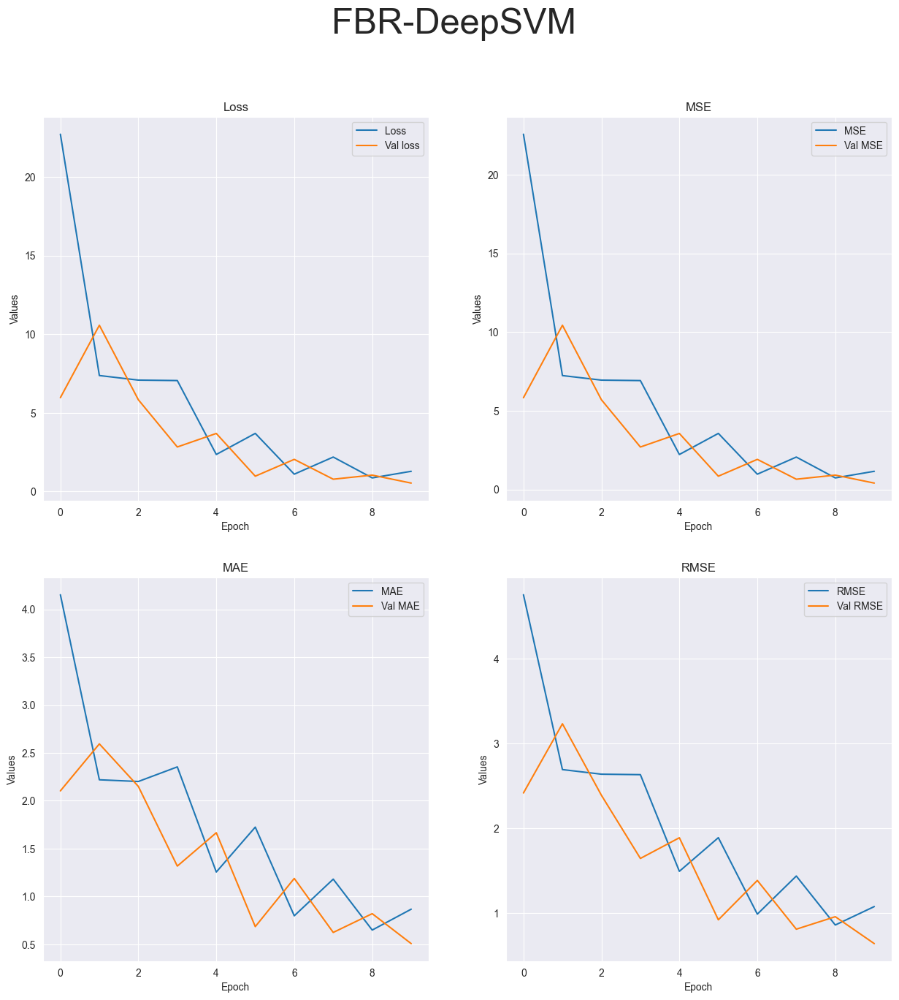

R-squared value: -0.0939


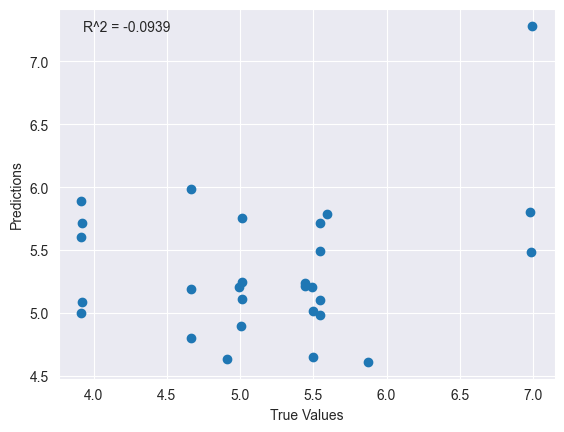

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_73 (Dense)            (None, 128)               1024      
                                                                 
 dense_74 (Dense)            (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


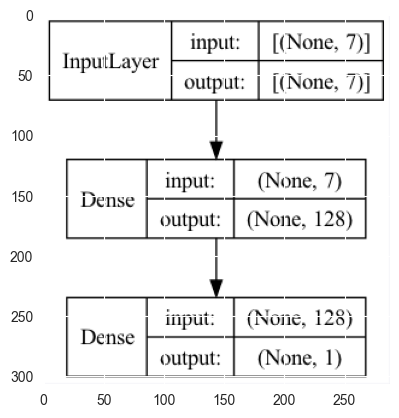

Epoch 1/20
1/3 [=========>....................] - ETA: 0s - loss: 19.6148 - mse: 19.4806 - mae: 3.6310 - root_mean_squared_error: 4.4137

2023-05-02 01:46:10.189922: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 137ms/step - loss: 19.8530 - mse: 19.7175 - mae: 3.6812 - root_mean_squared_error: 4.4404 - val_loss: 1.3192 - val_mse: 1.1850 - val_mae: 0.9001 - val_root_mean_squared_error: 1.0886
Epoch 2/20
3/3 [==============================] - 0s 25ms/step - loss: 6.8502 - mse: 6.7168 - mae: 2.0129 - root_mean_squared_error: 2.5917 - val_loss: 3.3571 - val_mse: 3.2245 - val_mae: 1.4517 - val_root_mean_squared_error: 1.7957
Epoch 3/20
3/3 [==============================] - 0s 18ms/step - loss: 2.9609 - mse: 2.8279 - mae: 1.3642 - root_mean_squared_error: 1.6817 - val_loss: 7.5400 - val_mse: 7.4065 - val_mae: 2.3247 - val_root_mean_squared_error: 2.7215
Epoch 4/20


2023-05-02 01:46:10.534315: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 19ms/step - loss: 5.1487 - mse: 5.0155 - mae: 1.9028 - root_mean_squared_error: 2.2395 - val_loss: 0.8497 - val_mse: 0.7175 - val_mae: 0.7815 - val_root_mean_squared_error: 0.8471
Epoch 5/20
3/3 [==============================] - 0s 17ms/step - loss: 1.8140 - mse: 1.6823 - mae: 1.0224 - root_mean_squared_error: 1.2970 - val_loss: 2.6720 - val_mse: 2.5410 - val_mae: 1.3257 - val_root_mean_squared_error: 1.5940
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 2.3828 - mse: 2.2517 - mae: 1.1874 - root_mean_squared_error: 1.5006 - val_loss: 1.3011 - val_mse: 1.1697 - val_mae: 0.8711 - val_root_mean_squared_error: 1.0815
Epoch 7/20
3/3 [==============================] - 0s 15ms/step - loss: 1.8887 - mse: 1.7572 - mae: 1.0475 - root_mean_squared_error: 1.3256 - val_loss: 2.2125 - val_mse: 2.0811 - val_mae: 1.1923 - val_root_mean_squared_error: 1.4426
Epoch 8/20
3/3 [==============================] - 0s 15ms/step - loss: 1.1234 -

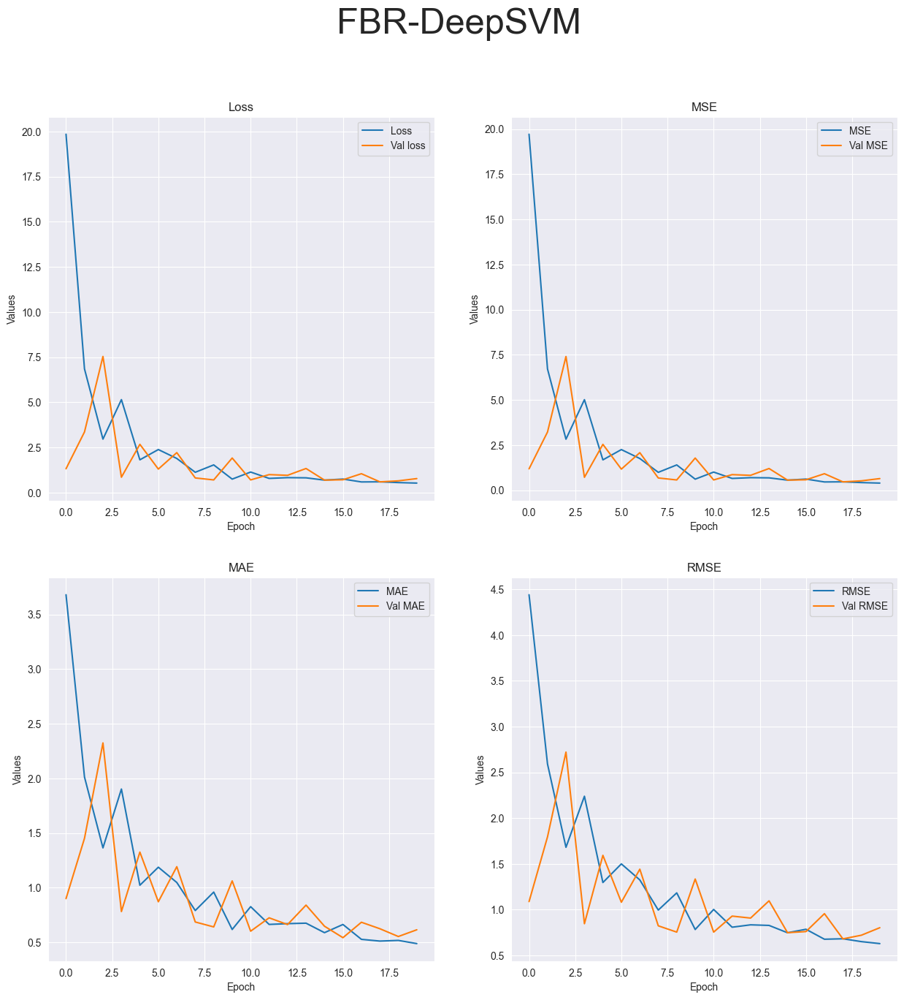

R-squared value: -0.0243


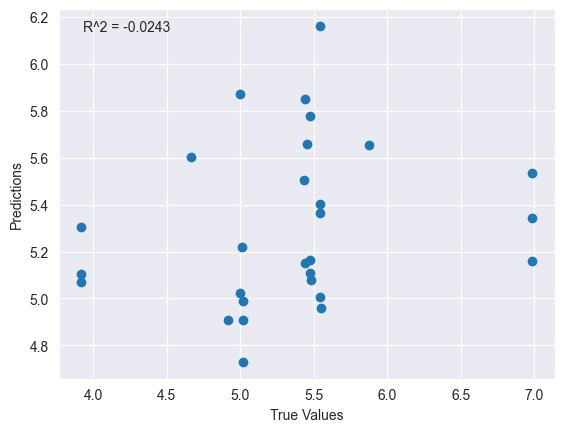

Running tests on CBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_75 (Dense)            (None, 64)                256       
                                                                 
 dropout_18 (Dropout)        (None, 64)                0         
                                                                 
 dense_76 (Dense)            (None, 32)                2080      
                                                                 
 dropout_19 (Dropout)        (None, 32)                0         
                                                                 
 dense_77 (Dense)            (None, 1)                 33 

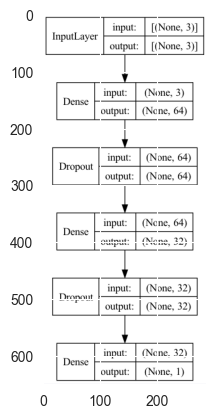

2023-05-02 01:46:12.768136: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 44ms/step - loss: 12.5052 - mse: 12.5052 - mae: 1.4585 - root_mean_squared_error: 3.5363


2023-05-02 01:46:13.285011: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [12.505186080932617, 12.505186080932617, 1.4584814310073853, 3.5362672805786133]
['loss', 'mse', 'mae', 'root_mean_squared_error']


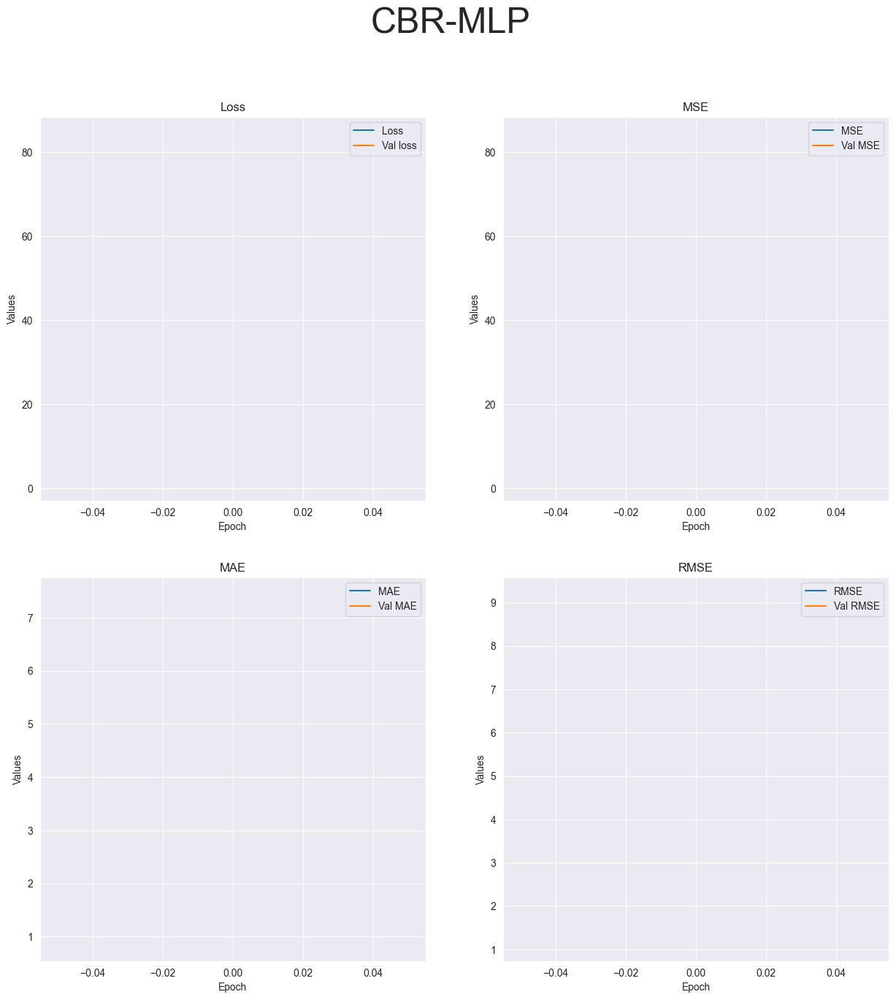

R-squared value: -23.4269


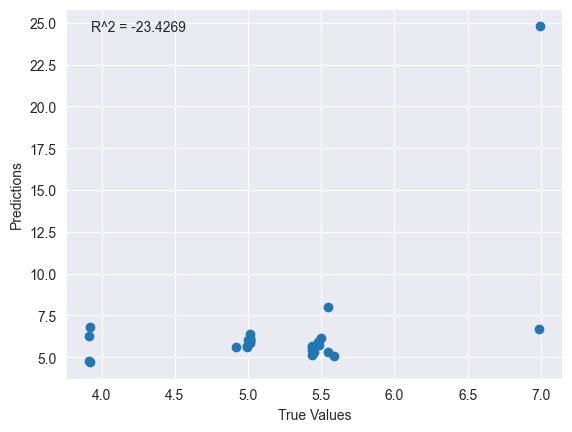

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_78 (Dense)            (None, 64)                256       
                                                                 
 dropout_20 (Dropout)        (None, 64)                0         
                                                                 
 dense_79 (Dense)            (None, 32)                2080      
                                                                 
 dropout_21 (Dropout)        (None, 32)                0         
                                                                 
 dense_80 (Dense)            (None, 1)                 33        
                                                       

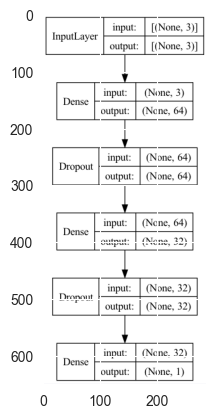

Epoch 1/4
1/3 [=========>....................] - ETA: 1s - loss: 84.5160 - mse: 84.5160 - mae: 7.7879 - root_mean_squared_error: 9.1933

2023-05-02 01:46:15.062666: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 149ms/step - loss: 225.2845 - mse: 225.2845 - mae: 8.5955 - root_mean_squared_error: 15.0095 - val_loss: 3.1467 - val_mse: 3.1467 - val_mae: 1.6283 - val_root_mean_squared_error: 1.7739
Epoch 2/4
3/3 [==============================] - 0s 25ms/step - loss: 33.5267 - mse: 33.5267 - mae: 4.3319 - root_mean_squared_error: 5.7902 - val_loss: 7.1178 - val_mse: 7.1178 - val_mae: 2.5833 - val_root_mean_squared_error: 2.6679
Epoch 3/4
1/3 [=========>....................] - ETA: 0s - loss: 21.8574 - mse: 21.8574 - mae: 3.5281 - root_mean_squared_error: 4.6752

2023-05-02 01:46:15.475833: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 28ms/step - loss: 21.9255 - mse: 21.9255 - mae: 3.2905 - root_mean_squared_error: 4.6825 - val_loss: 4.6043 - val_mse: 4.6043 - val_mae: 2.0351 - val_root_mean_squared_error: 2.1458
Epoch 4/4
1/1 [==============================] - 0s 35ms/step - loss: 1.3577 - mse: 1.3577 - mae: 1.0320 - root_mean_squared_error: 1.1652
Test loss: [1.3576725721359253, 1.3576725721359253, 1.0319997072219849, 1.1651921272277832]
['loss', 'mse', 'mae', 'root_mean_squared_error']


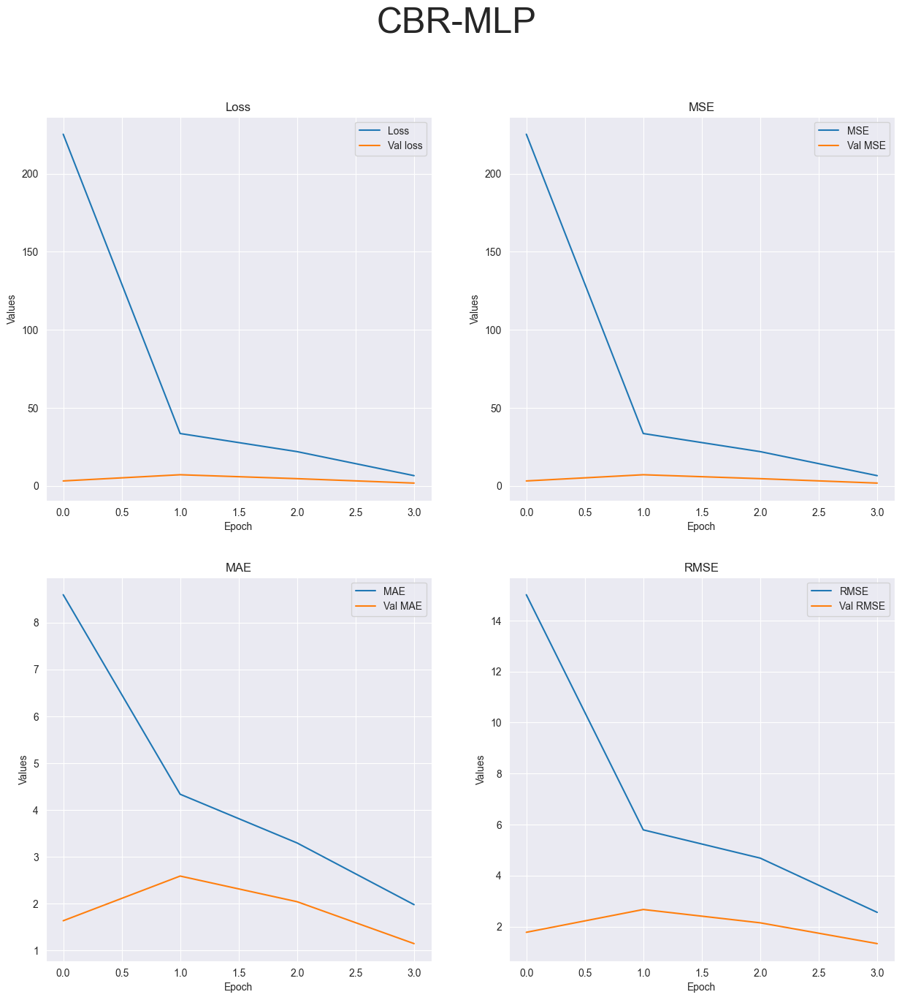

R-squared value: -2.0700


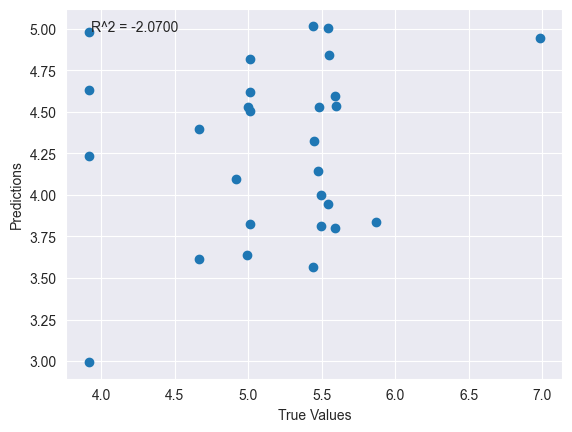

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_81 (Dense)            (None, 64)                256       
                                                                 
 dropout_22 (Dropout)        (None, 64)                0         
                                                                 
 dense_82 (Dense)            (None, 32)                2080      
                                                                 
 dropout_23 (Dropout)        (None, 32)                0         
                                                                 
 dense_83 (Dense)            (None, 1)                 33        
                                                      

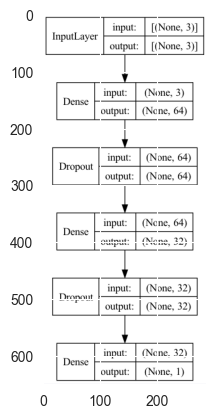

Epoch 1/10


2023-05-02 01:46:17.016076: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 160ms/step - loss: 78.4044 - mse: 78.4044 - mae: 6.8996 - root_mean_squared_error: 8.8546 - val_loss: 3.7434 - val_mse: 3.7434 - val_mae: 1.8173 - val_root_mean_squared_error: 1.9348
Epoch 2/10
3/3 [==============================] - 0s 26ms/step - loss: 57.2787 - mse: 57.2787 - mae: 5.8601 - root_mean_squared_error: 7.5683 - val_loss: 4.9221 - val_mse: 4.9221 - val_mae: 2.1258 - val_root_mean_squared_error: 2.2186
Epoch 3/10
1/3 [=========>....................] - ETA: 0s - loss: 27.1087 - mse: 27.1087 - mae: 3.9386 - root_mean_squared_error: 5.2066

2023-05-02 01:46:17.478125: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 27ms/step - loss: 17.7359 - mse: 17.7359 - mae: 3.2847 - root_mean_squared_error: 4.2114 - val_loss: 13.5496 - val_mse: 13.5496 - val_mae: 3.5374 - val_root_mean_squared_error: 3.6810
Epoch 4/10
3/3 [==============================] - 0s 23ms/step - loss: 19.4117 - mse: 19.4117 - mae: 3.2799 - root_mean_squared_error: 4.4059 - val_loss: 0.9649 - val_mse: 0.9649 - val_mae: 0.8419 - val_root_mean_squared_error: 0.9823
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 6.3639 - mse: 6.3639 - mae: 2.1247 - root_mean_squared_error: 2.5227 - val_loss: 13.2036 - val_mse: 13.2036 - val_mae: 3.5833 - val_root_mean_squared_error: 3.6337
Epoch 6/10
3/3 [==============================] - 0s 36ms/step - loss: 10.7010 - mse: 10.7010 - mae: 3.0103 - root_mean_squared_error: 3.2712 - val_loss: 9.9356 - val_mse: 9.9356 - val_mae: 3.0925 - val_root_mean_squared_error: 3.1521
Epoch 7/10
3/3 [==============================] - 0s 19ms/step - loss

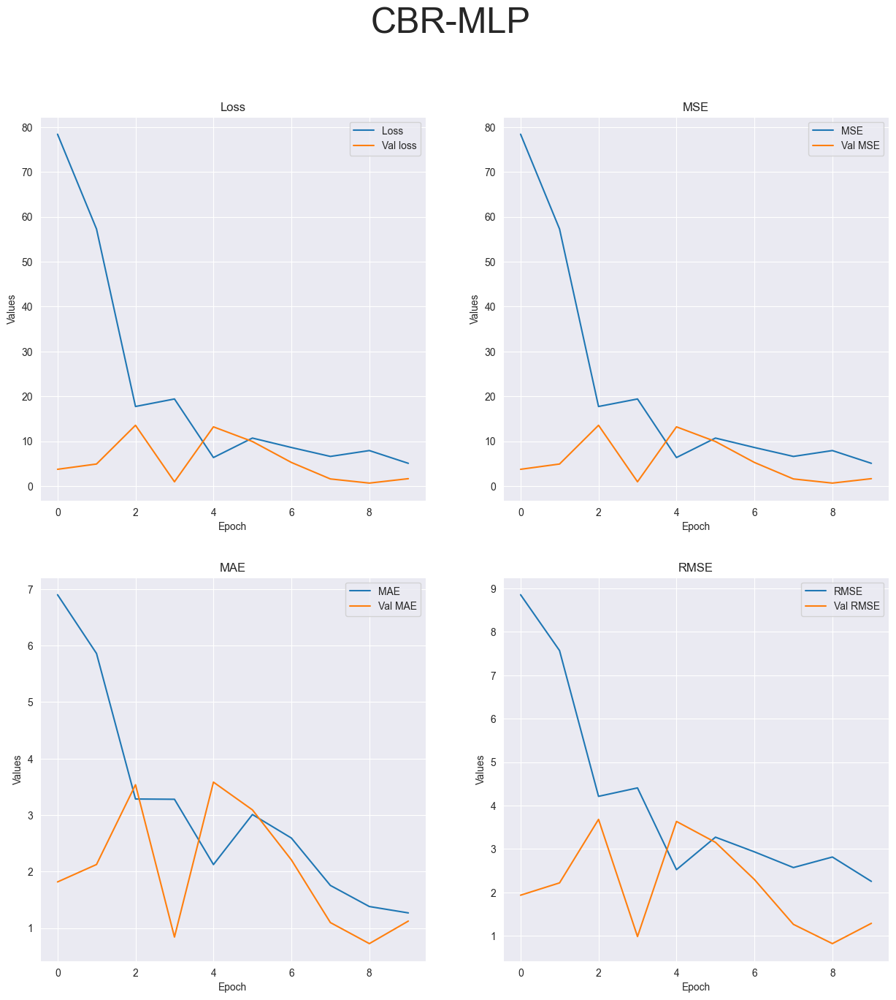

R-squared value: -2.9347


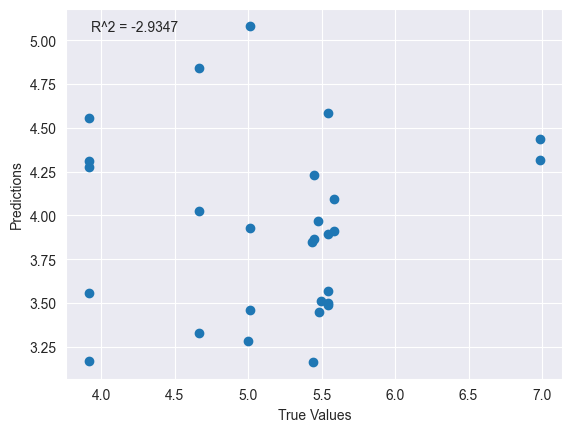

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_84 (Dense)            (None, 64)                256       
                                                                 
 dropout_24 (Dropout)        (None, 64)                0         
                                                                 
 dense_85 (Dense)            (None, 32)                2080      
                                                                 
 dropout_25 (Dropout)        (None, 32)                0         
                                                                 
 dense_86 (Dense)            (None, 1)                 33        
                                                      

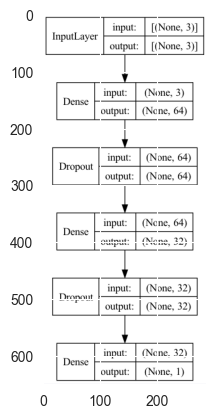

Epoch 1/20


2023-05-02 01:46:19.251052: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 155ms/step - loss: 79.1049 - mse: 79.1049 - mae: 7.1700 - root_mean_squared_error: 8.8941 - val_loss: 0.5842 - val_mse: 0.5842 - val_mae: 0.6499 - val_root_mean_squared_error: 0.7644
Epoch 2/20
3/3 [==============================] - 0s 31ms/step - loss: 25.7903 - mse: 25.7903 - mae: 3.7999 - root_mean_squared_error: 5.0784 - val_loss: 0.4711 - val_mse: 0.4711 - val_mae: 0.5787 - val_root_mean_squared_error: 0.6863
Epoch 3/20
1/3 [=========>....................] - ETA: 0s - loss: 13.7489 - mse: 13.7489 - mae: 2.9571 - root_mean_squared_error: 3.7080

2023-05-02 01:46:19.699476: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 44ms/step - loss: 11.4828 - mse: 11.4828 - mae: 2.4831 - root_mean_squared_error: 3.3886 - val_loss: 0.6778 - val_mse: 0.6778 - val_mae: 0.5983 - val_root_mean_squared_error: 0.8233
Epoch 4/20
3/3 [==============================] - 0s 28ms/step - loss: 4.8504 - mse: 4.8504 - mae: 1.7174 - root_mean_squared_error: 2.2024 - val_loss: 2.3369 - val_mse: 2.3369 - val_mae: 1.4114 - val_root_mean_squared_error: 1.5287
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 8.4247 - mse: 8.4247 - mae: 2.1459 - root_mean_squared_error: 2.9025 - val_loss: 6.0004 - val_mse: 6.0004 - val_mae: 2.3859 - val_root_mean_squared_error: 2.4496
Epoch 6/20
3/3 [==============================] - 0s 20ms/step - loss: 5.4421 - mse: 5.4421 - mae: 1.7797 - root_mean_squared_error: 2.3328 - val_loss: 1.2579 - val_mse: 1.2579 - val_mae: 1.0279 - val_root_mean_squared_error: 1.1216
Epoch 7/20
3/3 [==============================] - 0s 22ms/step - loss: 5.6850

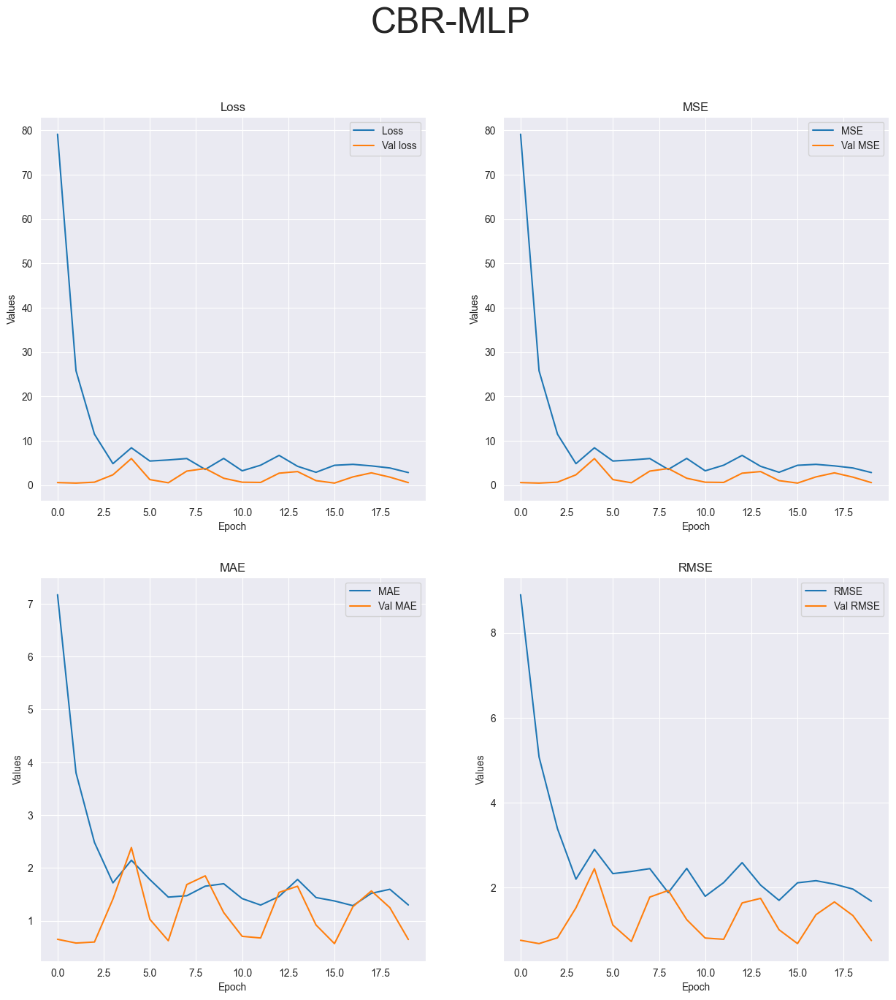

R-squared value: -0.6069


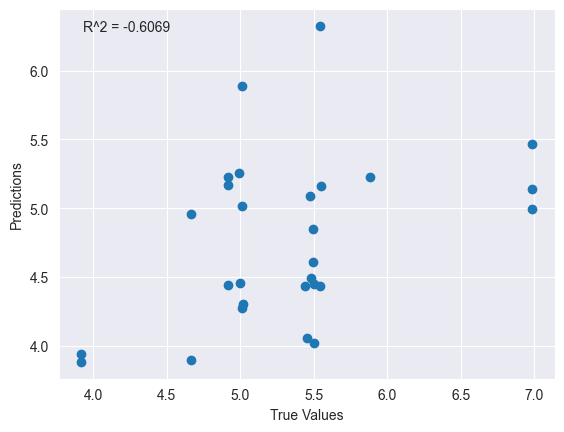

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_87 (Dense)            (None, 64)                256       
                                                                 
 dense_88 (Dense)            (None, 32)                2080      
                                                                 
 dense_89 (Dense)            (None, 16)                528       
                                                                 
 dense_90 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_________________________

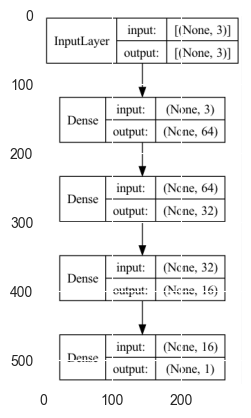

2023-05-02 01:46:22.764256: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 47ms/step - loss: 34.0834 - mse: 34.0834 - mae: 5.7671 - root_mean_squared_error: 5.8381


2023-05-02 01:46:23.250551: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [34.08340072631836, 34.08340072631836, 5.767066955566406, 5.838099002838135]
['loss', 'mse', 'mae', 'root_mean_squared_error']


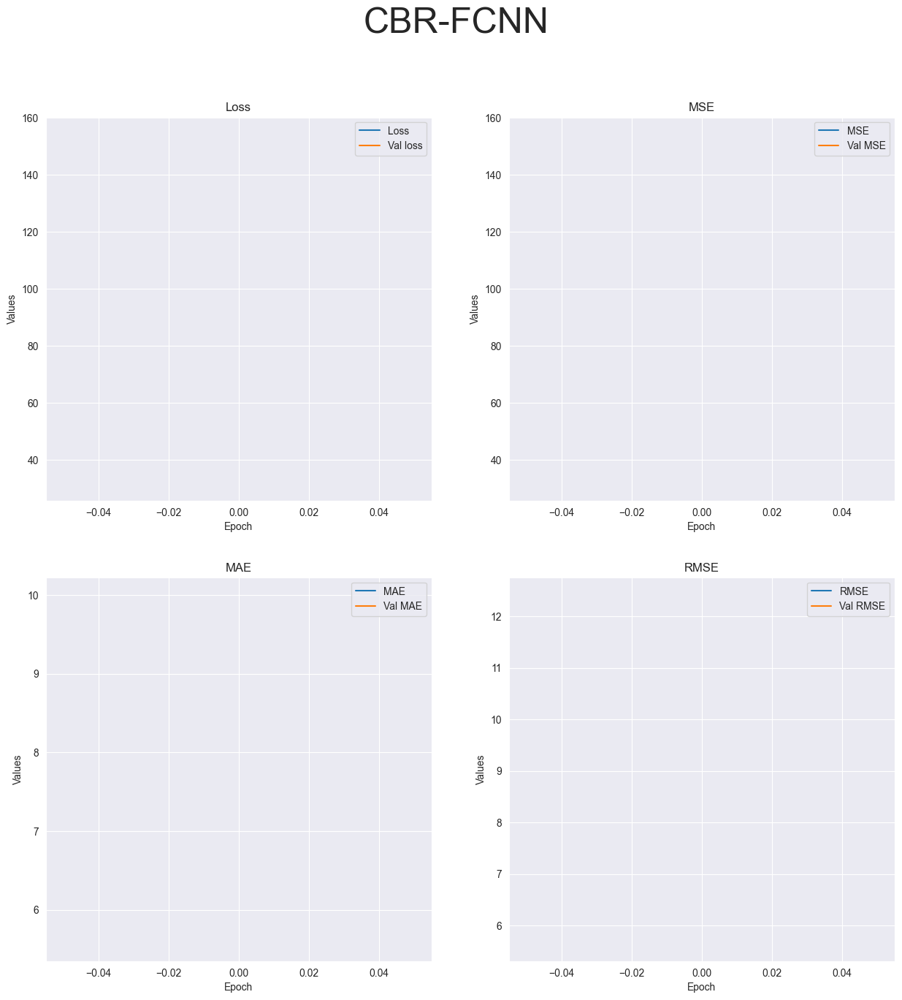

R-squared value: -42.1623


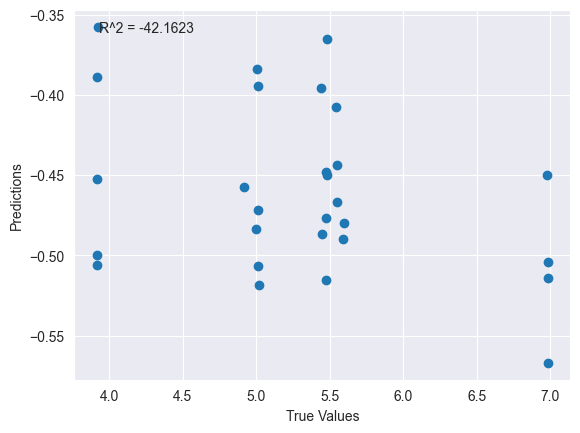

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_91 (Dense)            (None, 64)                256       
                                                                 
 dense_92 (Dense)            (None, 32)                2080      
                                                                 
 dense_93 (Dense)            (None, 16)                528       
                                                                 
 dense_94 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_____________________________________________________

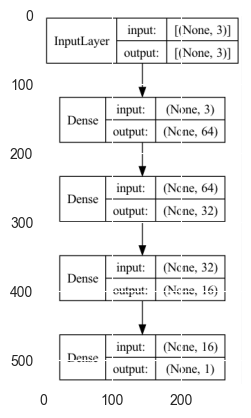

Epoch 1/4


2023-05-02 01:46:24.712524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 174ms/step - loss: 150.9266 - mse: 150.9266 - mae: 9.9174 - root_mean_squared_error: 12.2852 - val_loss: 24.8452 - val_mse: 24.8452 - val_mae: 4.9259 - val_root_mean_squared_error: 4.9845
Epoch 2/4
3/3 [==============================] - 0s 29ms/step - loss: 66.9624 - mse: 66.9624 - mae: 7.8826 - root_mean_squared_error: 8.1831 - val_loss: 51.7375 - val_mse: 51.7375 - val_mae: 7.0146 - val_root_mean_squared_error: 7.1929
Epoch 3/4


2023-05-02 01:46:25.325084: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 22ms/step - loss: 21.8100 - mse: 21.8100 - mae: 3.9872 - root_mean_squared_error: 4.6701 - val_loss: 29.3192 - val_mse: 29.3192 - val_mae: 2.9360 - val_root_mean_squared_error: 5.4147
Epoch 4/4
1/1 [==============================] - 0s 62ms/step - loss: 5.3366 - mse: 5.3366 - mae: 2.0947 - root_mean_squared_error: 2.3101
Test loss: [5.336594581604004, 5.336594581604004, 2.0946621894836426, 2.3101069927215576]
['loss', 'mse', 'mae', 'root_mean_squared_error']


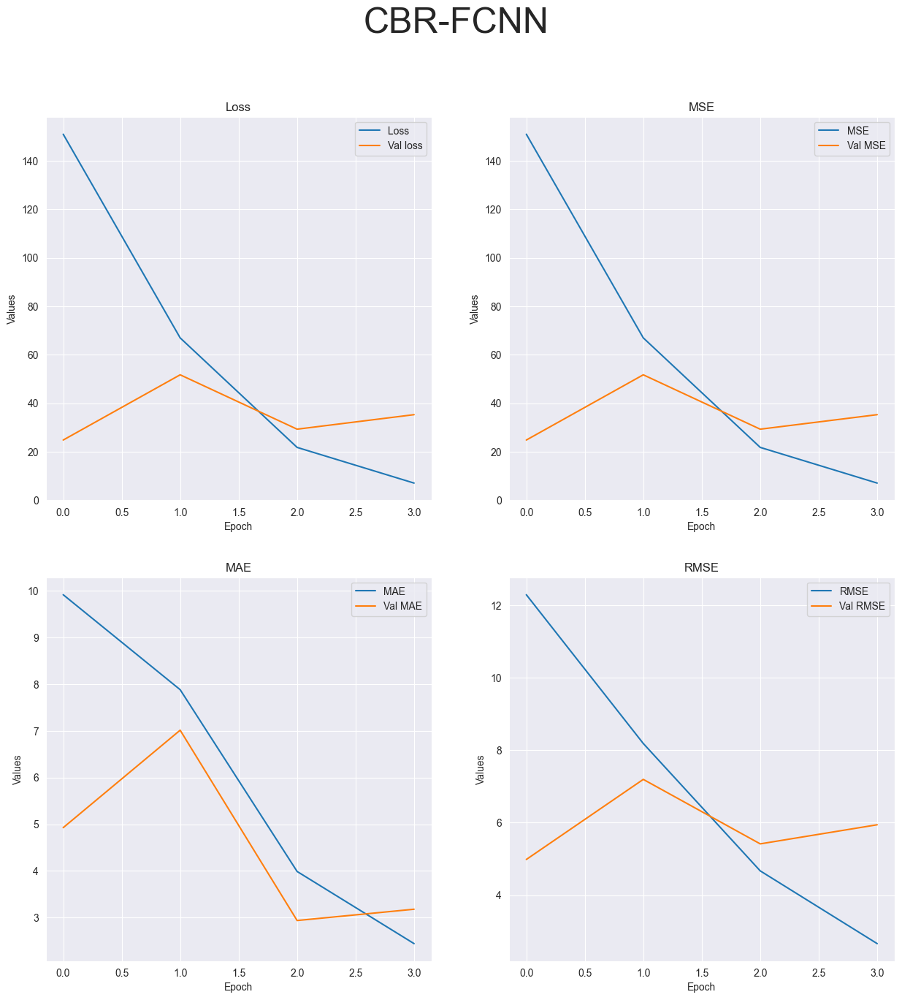

R-squared value: -15.5643


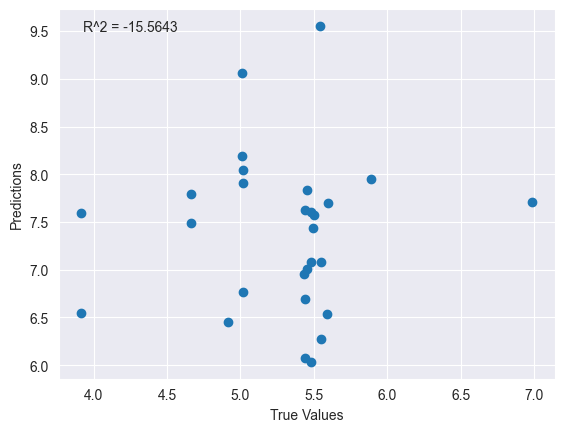

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_95 (Dense)            (None, 64)                256       
                                                                 
 dense_96 (Dense)            (None, 32)                2080      
                                                                 
 dense_97 (Dense)            (None, 16)                528       
                                                                 
 dense_98 (Dense)            (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

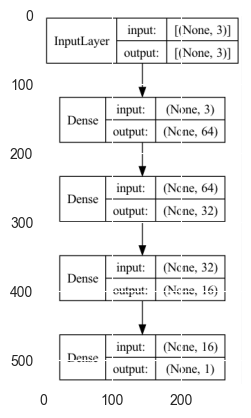

Epoch 1/10


2023-05-02 01:46:26.920173: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 169ms/step - loss: 139.5577 - mse: 139.5577 - mae: 9.7907 - root_mean_squared_error: 11.8135 - val_loss: 35.2574 - val_mse: 35.2574 - val_mae: 5.9038 - val_root_mean_squared_error: 5.9378
Epoch 2/10
3/3 [==============================] - 0s 27ms/step - loss: 71.4660 - mse: 71.4660 - mae: 8.1876 - root_mean_squared_error: 8.4538 - val_loss: 46.2607 - val_mse: 46.2607 - val_mae: 6.7720 - val_root_mean_squared_error: 6.8015
Epoch 3/10
1/3 [=========>....................] - ETA: 0s - loss: 39.9176 - mse: 39.9176 - mae: 6.2859 - root_mean_squared_error: 6.3180

2023-05-02 01:46:27.391147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 31ms/step - loss: 21.0768 - mse: 21.0768 - mae: 3.7925 - root_mean_squared_error: 4.5909 - val_loss: 4.1682 - val_mse: 4.1682 - val_mae: 1.7996 - val_root_mean_squared_error: 2.0416
Epoch 4/10
3/3 [==============================] - 0s 22ms/step - loss: 11.5035 - mse: 11.5035 - mae: 2.3355 - root_mean_squared_error: 3.3917 - val_loss: 4.6610 - val_mse: 4.6610 - val_mae: 1.9155 - val_root_mean_squared_error: 2.1589
Epoch 5/10
3/3 [==============================] - 0s 34ms/step - loss: 7.4041 - mse: 7.4041 - mae: 1.7134 - root_mean_squared_error: 2.7210 - val_loss: 0.7899 - val_mse: 0.7899 - val_mae: 0.6492 - val_root_mean_squared_error: 0.8888
Epoch 6/10
3/3 [==============================] - 0s 23ms/step - loss: 3.0255 - mse: 3.0255 - mae: 1.0180 - root_mean_squared_error: 1.7394 - val_loss: 3.9632 - val_mse: 3.9632 - val_mae: 1.8348 - val_root_mean_squared_error: 1.9908
Epoch 7/10
3/3 [==============================] - 0s 20ms/step - loss: 4.78

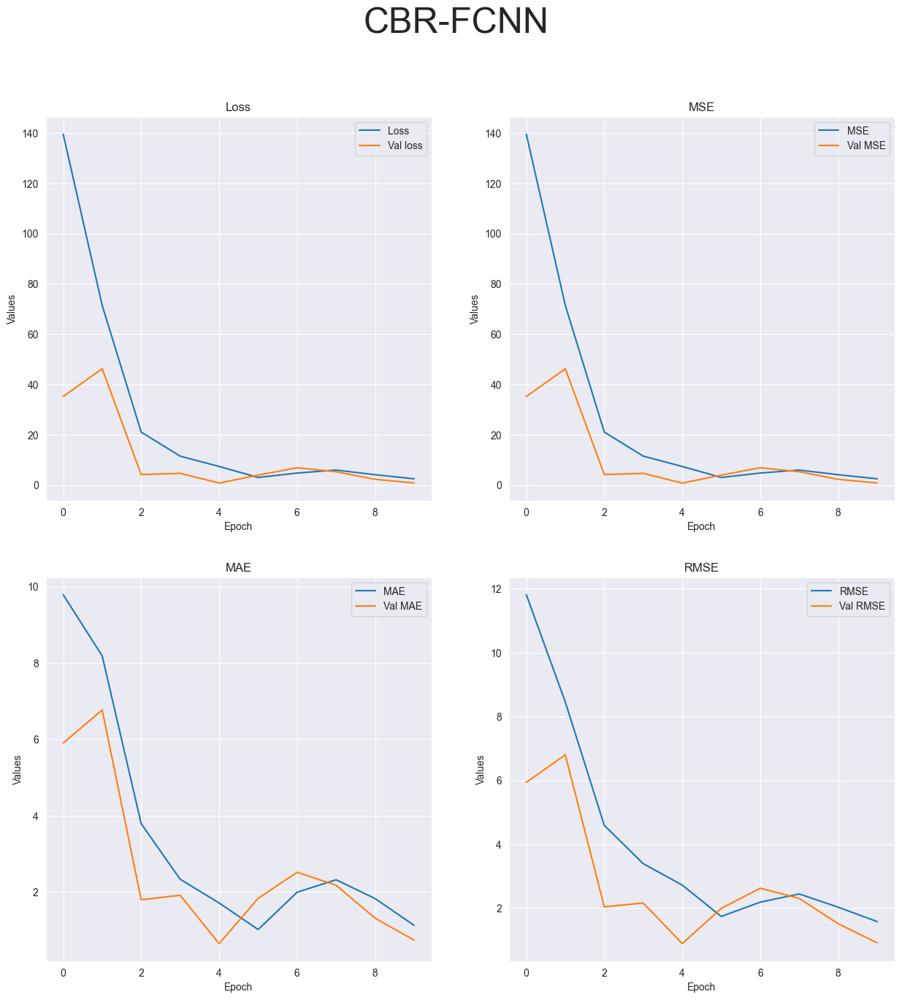

R-squared value: -1.8693


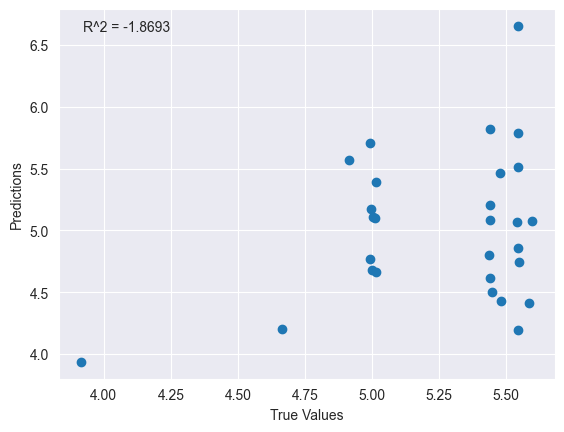

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_99 (Dense)            (None, 64)                256       
                                                                 
 dense_100 (Dense)           (None, 32)                2080      
                                                                 
 dense_101 (Dense)           (None, 16)                528       
                                                                 
 dense_102 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

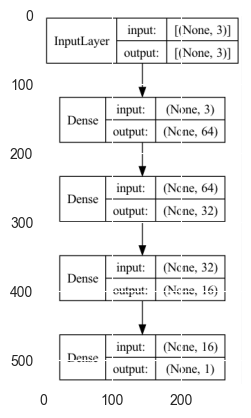

Epoch 1/20


2023-05-02 01:46:29.230646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 385ms/step - loss: 241.6049 - mse: 241.6049 - mae: 10.3434 - root_mean_squared_error: 15.5436 - val_loss: 42.9097 - val_mse: 42.9097 - val_mae: 6.5117 - val_root_mean_squared_error: 6.5506
Epoch 2/20
3/3 [==============================] - 0s 33ms/step - loss: 115.8272 - mse: 115.8272 - mae: 10.0798 - root_mean_squared_error: 10.7623 - val_loss: 68.6528 - val_mse: 68.6528 - val_mae: 8.2526 - val_root_mean_squared_error: 8.2857
Epoch 3/20


2023-05-02 01:46:30.171443: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 25ms/step - loss: 40.8155 - mse: 40.8155 - mae: 5.6357 - root_mean_squared_error: 6.3887 - val_loss: 1.0839 - val_mse: 1.0839 - val_mae: 0.7984 - val_root_mean_squared_error: 1.0411
Epoch 4/20
3/3 [==============================] - 0s 47ms/step - loss: 10.2636 - mse: 10.2636 - mae: 1.8680 - root_mean_squared_error: 3.2037 - val_loss: 9.2907 - val_mse: 9.2907 - val_mae: 2.8755 - val_root_mean_squared_error: 3.0481
Epoch 5/20
3/3 [==============================] - 0s 19ms/step - loss: 14.9609 - mse: 14.9609 - mae: 2.8379 - root_mean_squared_error: 3.8679 - val_loss: 4.8584 - val_mse: 4.8584 - val_mae: 1.9862 - val_root_mean_squared_error: 2.2042
Epoch 6/20
3/3 [==============================] - 0s 26ms/step - loss: 5.3733 - mse: 5.3733 - mae: 1.3734 - root_mean_squared_error: 2.3180 - val_loss: 0.7207 - val_mse: 0.7207 - val_mae: 0.7336 - val_root_mean_squared_error: 0.8489
Epoch 7/20
3/3 [==============================] - 0s 20ms/step - loss: 2.

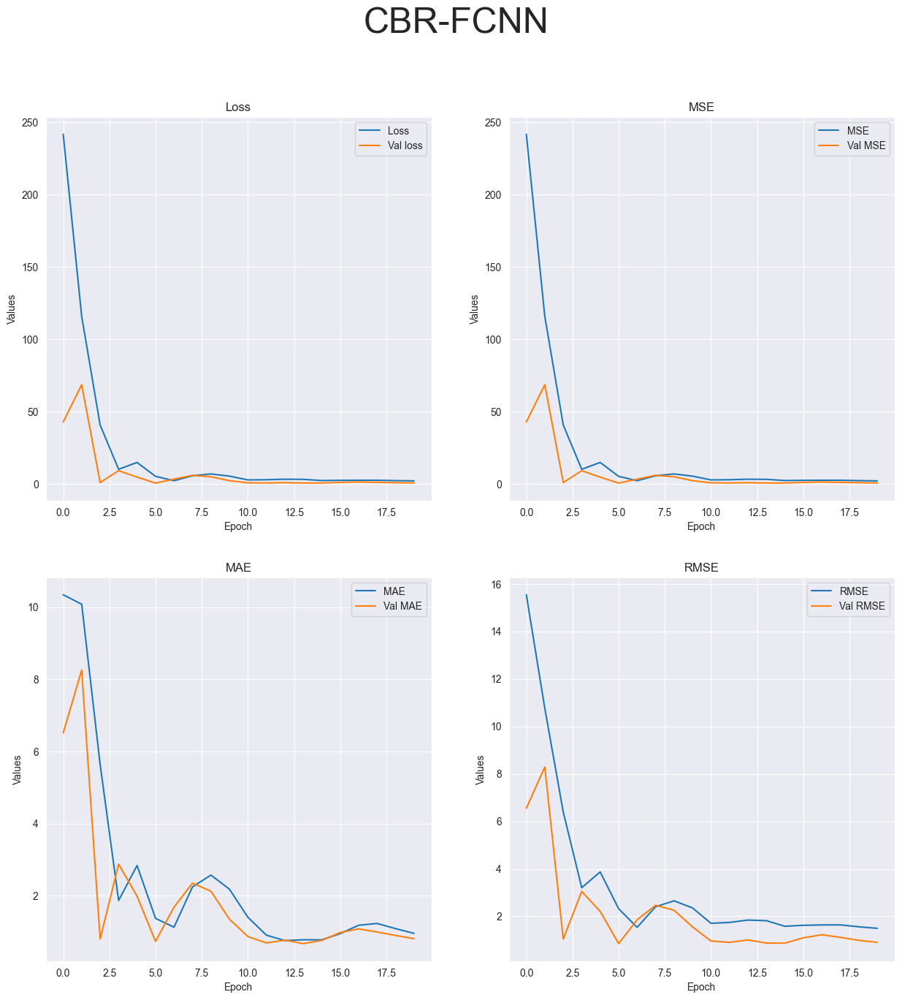

R-squared value: -0.4625


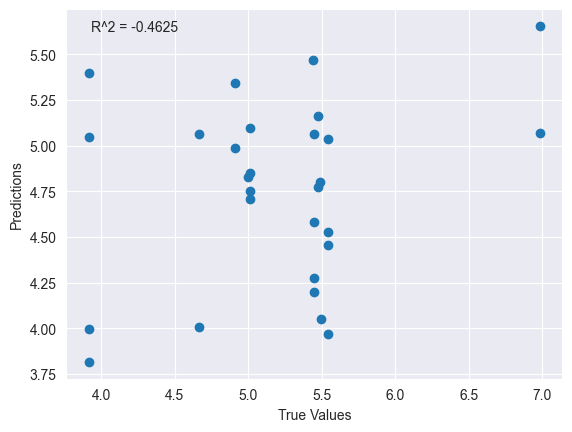

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_103 (Dense)           (None, 128)               512       
                                                                 
 dense_104 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


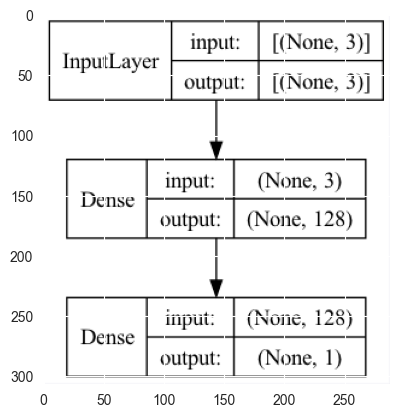

1/3 [=========>....................] - ETA: 0s - loss: 5813.3984 - mse: 5813.3413 - mae: 75.6281 - root_mean_squared_error: 76.2453

2023-05-02 01:46:32.692645: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 42ms/step - loss: 11.5744 - mse: 11.5205 - mae: 2.7864 - root_mean_squared_error: 3.3942


2023-05-02 01:46:33.093560: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [11.574376106262207, 11.520479202270508, 2.78643536567688, 3.3941831588745117]
['loss', 'mse', 'mae', 'root_mean_squared_error']


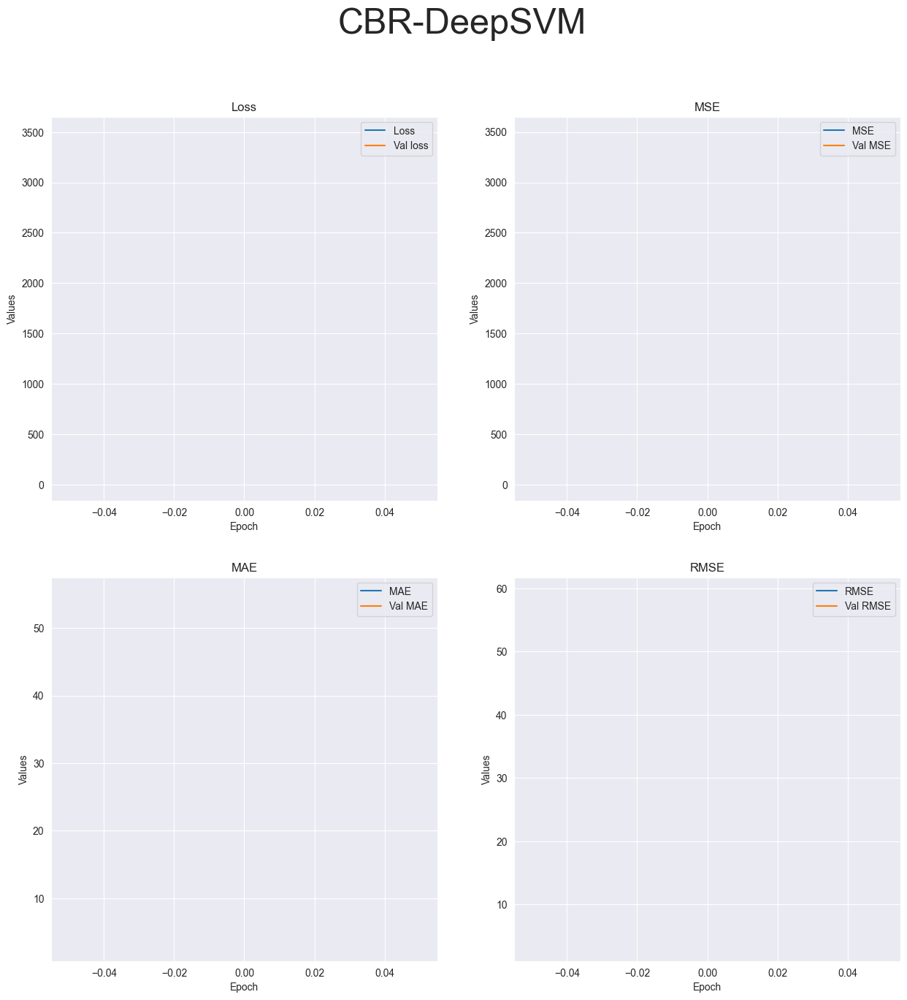

R-squared value: -34.1247


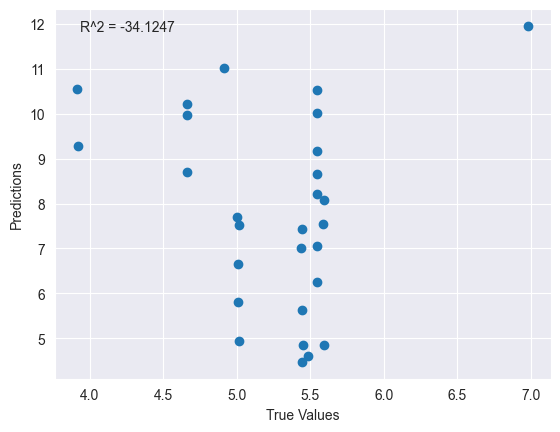

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_105 (Dense)           (None, 128)               512       
                                                                 
 dense_106 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


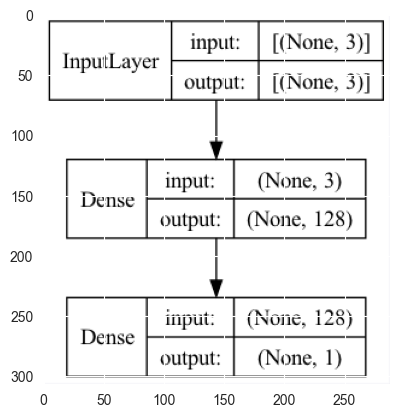

Epoch 1/4
1/3 [=========>....................] - ETA: 0s - loss: 6764.9873 - mse: 6764.9302 - mae: 81.3738 - root_mean_squared_error: 82.2492

2023-05-02 01:46:34.425827: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 163ms/step - loss: 4168.6758 - mse: 4168.6201 - mae: 57.4830 - root_mean_squared_error: 64.5648 - val_loss: 20.4715 - val_mse: 20.4177 - val_mae: 3.8838 - val_root_mean_squared_error: 4.5186
Epoch 2/4
3/3 [==============================] - 0s 25ms/step - loss: 310.5886 - mse: 310.5344 - mae: 14.8125 - root_mean_squared_error: 17.6220 - val_loss: 1206.3766 - val_mse: 1206.3219 - val_mae: 34.6664 - val_root_mean_squared_error: 34.7321
Epoch 3/4
1/3 [=========>....................] - ETA: 0s - loss: 1227.1185 - mse: 1227.0638 - mae: 34.8944 - root_mean_squared_error: 35.0295

2023-05-02 01:46:34.842336: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 25ms/step - loss: 1554.4131 - mse: 1554.3589 - mae: 36.9912 - root_mean_squared_error: 39.4254 - val_loss: 807.5614 - val_mse: 807.5085 - val_mae: 28.3656 - val_root_mean_squared_error: 28.4167
Epoch 4/4
1/1 [==============================] - 0s 43ms/step - loss: 50.3692 - mse: 50.3183 - mae: 6.9601 - root_mean_squared_error: 7.0935
Test loss: [50.36924362182617, 50.31834030151367, 6.960078716278076, 7.093542098999023]
['loss', 'mse', 'mae', 'root_mean_squared_error']


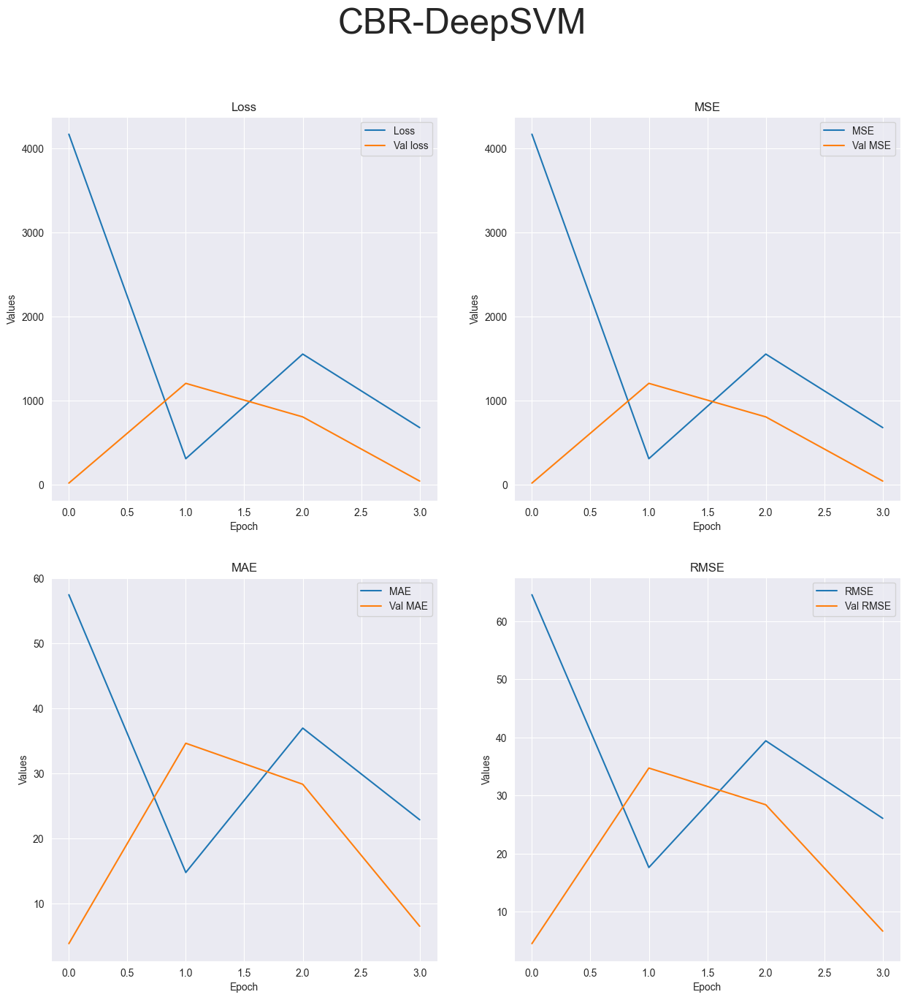

R-squared value: -97.4014


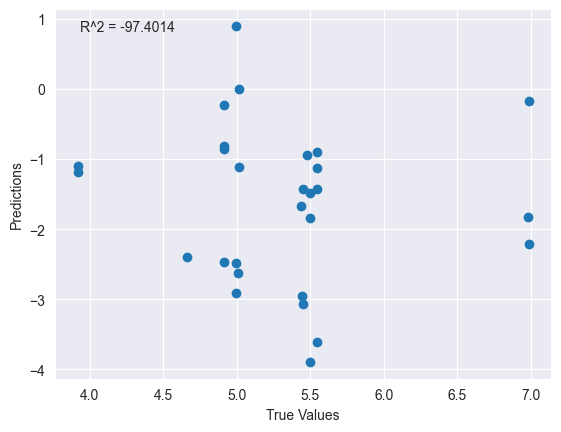

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_107 (Dense)           (None, 128)               512       
                                                                 
 dense_108 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


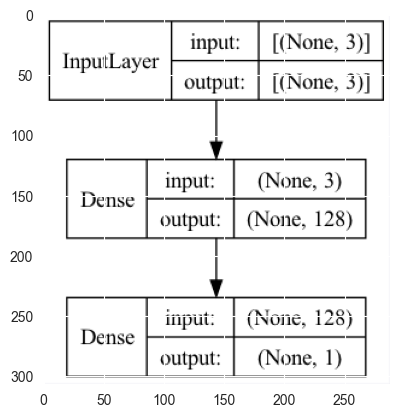

Epoch 1/10
1/3 [=========>....................] - ETA: 0s - loss: 6665.8970 - mse: 6665.8398 - mae: 80.4843 - root_mean_squared_error: 81.6446

2023-05-02 01:46:36.407309: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 165ms/step - loss: 4084.5688 - mse: 4084.5134 - mae: 56.4344 - root_mean_squared_error: 63.9102 - val_loss: 28.0561 - val_mse: 28.0023 - val_mae: 4.8038 - val_root_mean_squared_error: 5.2917
Epoch 2/10
3/3 [==============================] - 0s 19ms/step - loss: 290.0492 - mse: 289.9951 - mae: 13.7532 - root_mean_squared_error: 17.0292 - val_loss: 974.9922 - val_mse: 974.9380 - val_mae: 31.1672 - val_root_mean_squared_error: 31.2240
Epoch 3/10
1/3 [=========>....................] - ETA: 0s - loss: 1555.2640 - mse: 1555.2097 - mae: 34.7675 - root_mean_squared_error: 39.4361

2023-05-02 01:46:36.818469: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 21ms/step - loss: 1163.2642 - mse: 1163.2103 - mae: 32.0959 - root_mean_squared_error: 34.1059 - val_loss: 595.9142 - val_mse: 595.8617 - val_mae: 24.3669 - val_root_mean_squared_error: 24.4103
Epoch 4/10
3/3 [==============================] - 0s 22ms/step - loss: 430.5373 - mse: 430.4854 - mae: 19.8238 - root_mean_squared_error: 20.7481 - val_loss: 39.0726 - val_mse: 39.0218 - val_mae: 6.1230 - val_root_mean_squared_error: 6.2467
Epoch 5/10
3/3 [==============================] - 0s 21ms/step - loss: 35.7165 - mse: 35.6660 - mae: 4.6510 - root_mean_squared_error: 5.9721 - val_loss: 95.9656 - val_mse: 95.9155 - val_mae: 9.5388 - val_root_mean_squared_error: 9.7936
Epoch 6/10
3/3 [==============================] - 0s 21ms/step - loss: 167.5262 - mse: 167.4762 - mae: 11.8901 - root_mean_squared_error: 12.9413 - val_loss: 223.3126 - val_mse: 223.2630 - val_mae: 14.7155 - val_root_mean_squared_error: 14.9420
Epoch 7/10
3/3 [=========================

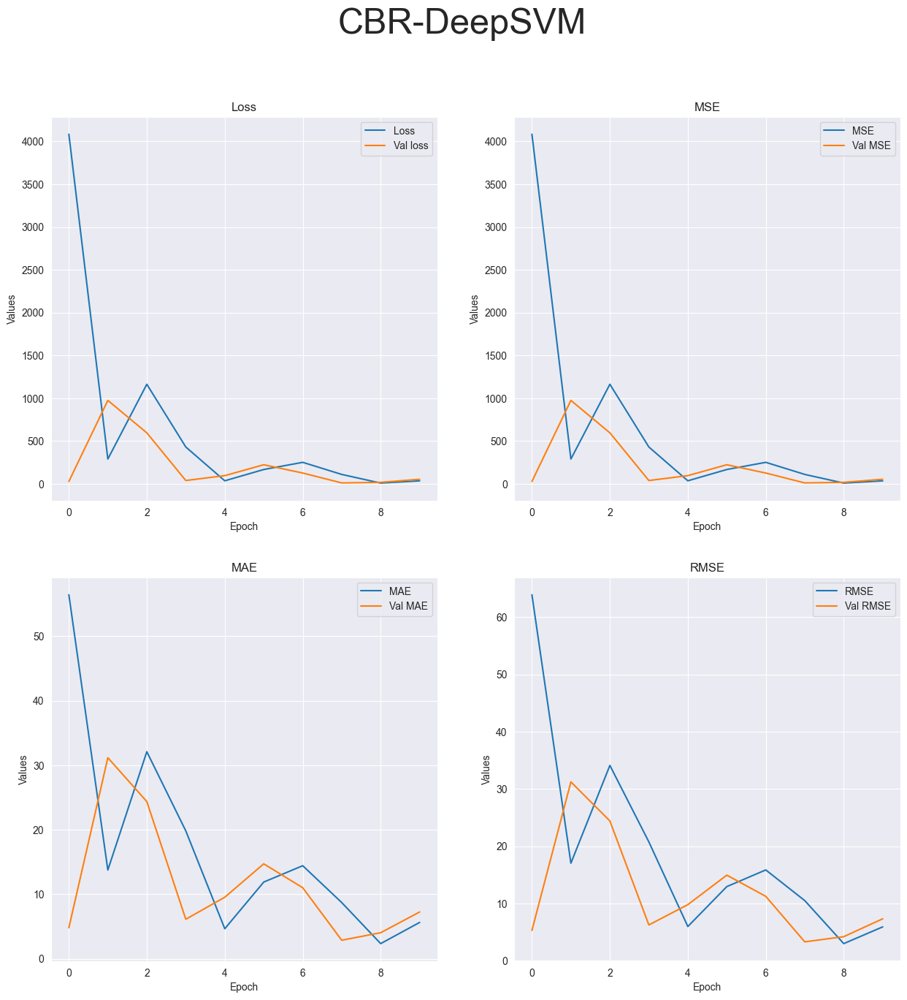

R-squared value: -197.2104


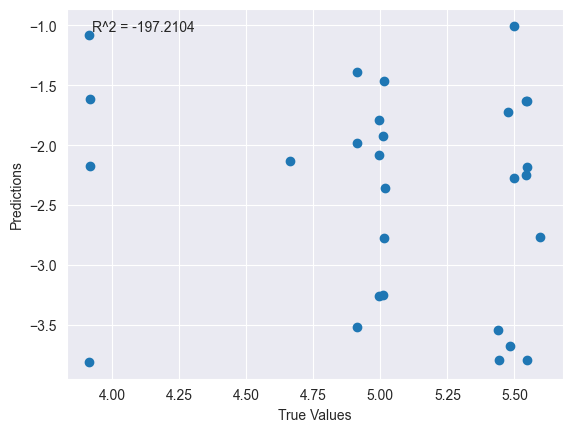

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_109 (Dense)           (None, 128)               512       
                                                                 
 dense_110 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


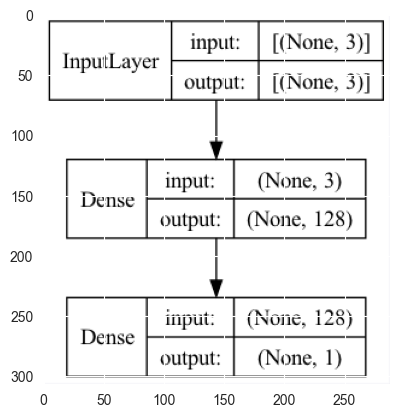

Epoch 1/20


2023-05-02 01:46:39.094228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 143ms/step - loss: 4736.8828 - mse: 4736.8276 - mae: 57.7539 - root_mean_squared_error: 68.8246 - val_loss: 74.9570 - val_mse: 74.9029 - val_mae: 8.1879 - val_root_mean_squared_error: 8.6546
Epoch 2/20
3/3 [==============================] - 0s 23ms/step - loss: 222.1766 - mse: 222.1222 - mae: 13.0259 - root_mean_squared_error: 14.9038 - val_loss: 1020.5421 - val_mse: 1020.4871 - val_mae: 31.8614 - val_root_mean_squared_error: 31.9451
Epoch 3/20
3/3 [==============================] - 0s 19ms/step - loss: 1269.5895 - mse: 1269.5349 - mae: 33.7417 - root_mean_squared_error: 35.6305 - val_loss: 875.3867 - val_mse: 875.3333 - val_mae: 29.5088 - val_root_mean_squared_error: 29.5860
Epoch 4/20


2023-05-02 01:46:39.499646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 19ms/step - loss: 686.6886 - mse: 686.6359 - mae: 25.1137 - root_mean_squared_error: 26.2037 - val_loss: 150.3674 - val_mse: 150.3161 - val_mae: 12.1959 - val_root_mean_squared_error: 12.2603
Epoch 5/20
3/3 [==============================] - 0s 16ms/step - loss: 93.1836 - mse: 93.1328 - mae: 7.2866 - root_mean_squared_error: 9.6505 - val_loss: 40.3810 - val_mse: 40.3310 - val_mae: 5.9593 - val_root_mean_squared_error: 6.3507
Epoch 6/20
3/3 [==============================] - 0s 17ms/step - loss: 114.4424 - mse: 114.3925 - mae: 9.7379 - root_mean_squared_error: 10.6954 - val_loss: 239.4970 - val_mse: 239.4475 - val_mae: 15.1853 - val_root_mean_squared_error: 15.4741
Epoch 7/20
3/3 [==============================] - 0s 21ms/step - loss: 320.3972 - mse: 320.3478 - mae: 16.3873 - root_mean_squared_error: 17.8983 - val_loss: 228.6747 - val_mse: 228.6258 - val_mae: 14.8398 - val_root_mean_squared_error: 15.1204
Epoch 8/20
3/3 [========================

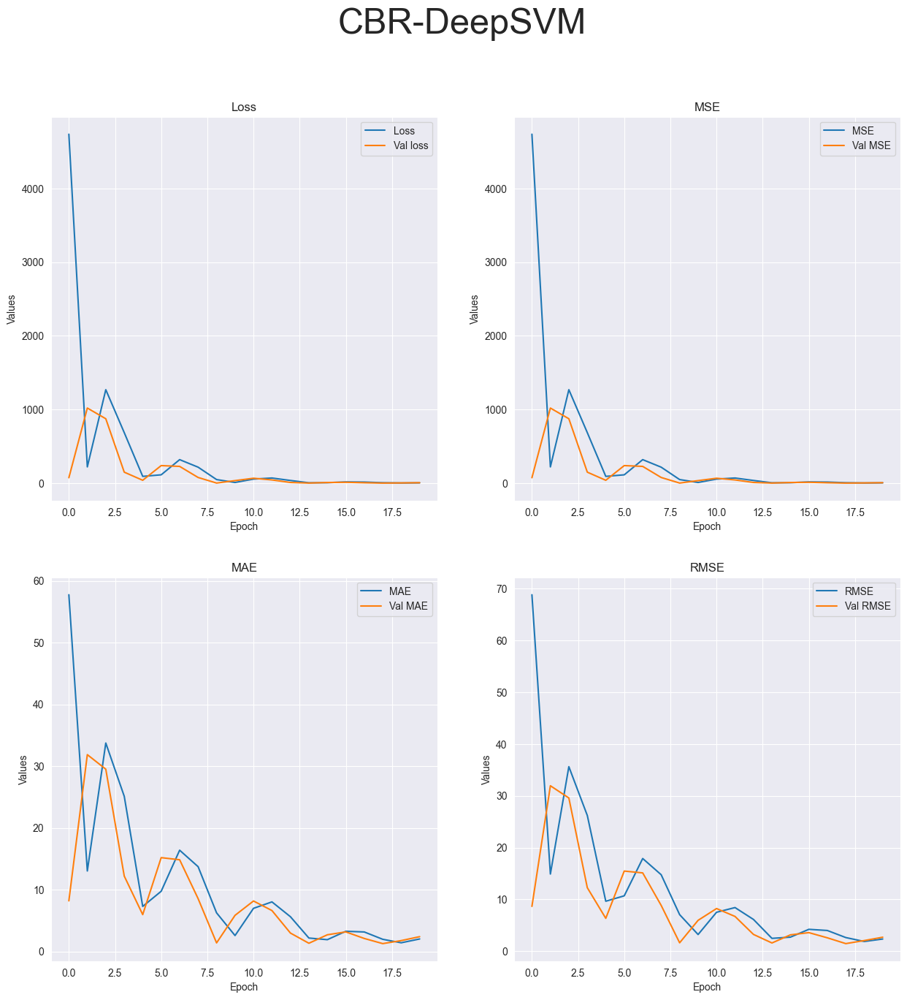

R-squared value: -17.3103


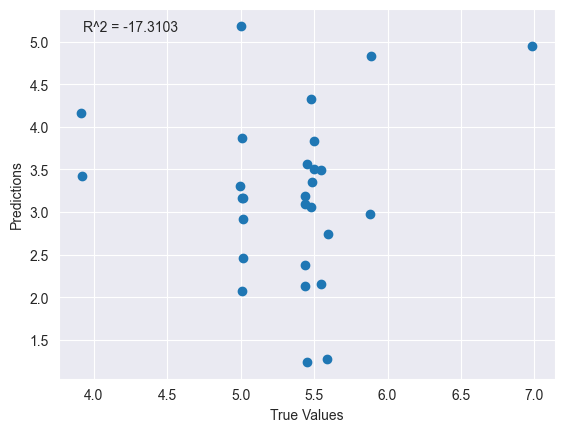

Running tests on ABR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_111 (Dense)           (None, 64)                832       
                                                                 
 dropout_26 (Dropout)        (None, 64)                0         
                             

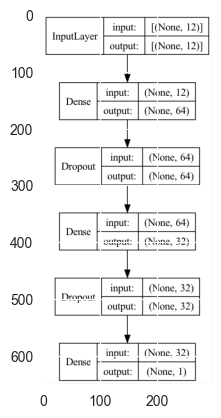

2023-05-02 01:46:41.860504: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 53ms/step - loss: 76687.0234 - mse: 76687.0234 - mae: 270.4418 - root_mean_squared_error: 276.9242


2023-05-02 01:46:42.346922: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [76687.0234375, 76687.0234375, 270.4418029785156, 276.9242248535156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


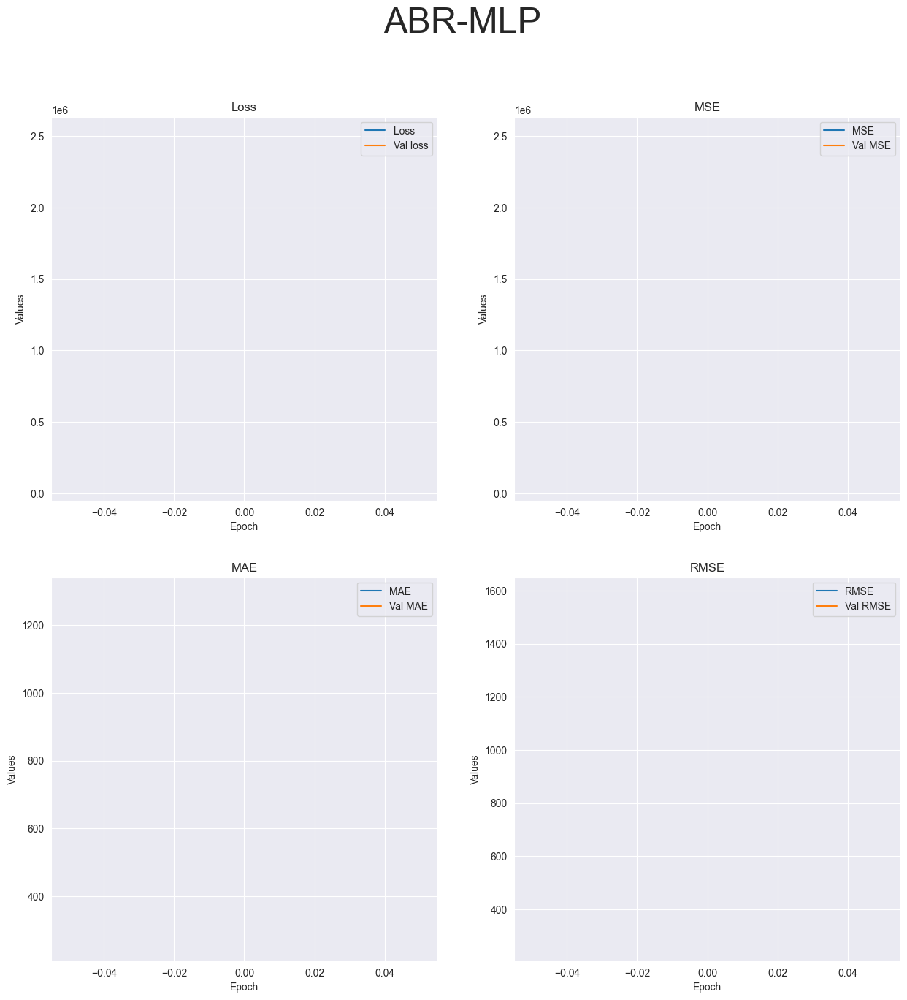

R-squared value: -100048.3034


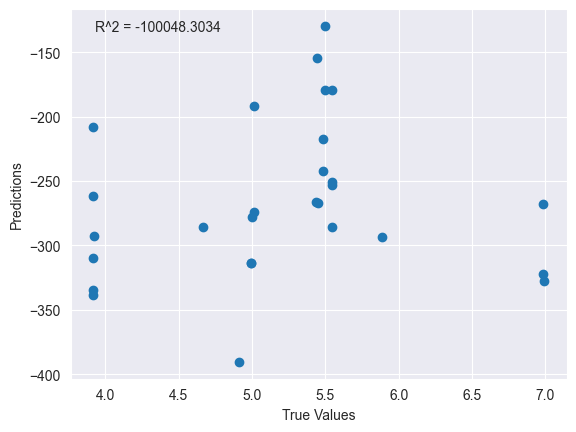

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_114 (Dense)           (None, 64)                832       
                                                                 
 dropout_28 (Dropout)        (None, 64)                0         
                                                                 
 dense_115 (Dense)        

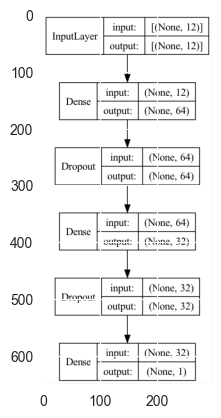

Epoch 1/4


2023-05-02 01:46:43.729284: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 170ms/step - loss: 2347452.7500 - mse: 2347452.7500 - mae: 1186.9374 - root_mean_squared_error: 1532.1399 - val_loss: 271304.2812 - val_mse: 271304.2812 - val_mae: 510.3508 - val_root_mean_squared_error: 520.8688
Epoch 2/4
3/3 [==============================] - 0s 26ms/step - loss: 698717.5000 - mse: 698717.5000 - mae: 616.5569 - root_mean_squared_error: 835.8932 - val_loss: 227302.3438 - val_mse: 227302.3438 - val_mae: 467.1680 - val_root_mean_squared_error: 476.7624
Epoch 3/4
1/3 [=========>....................] - ETA: 0s - loss: 350717.4688 - mse: 350717.4688 - mae: 443.1691 - root_mean_squared_error: 592.2141

2023-05-02 01:46:44.217156: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 19ms/step - loss: 271922.3750 - mse: 271922.3750 - mae: 395.5573 - root_mean_squared_error: 521.4618 - val_loss: 16119.2402 - val_mse: 16119.2402 - val_mae: 124.2597 - val_root_mean_squared_error: 126.9616
Epoch 4/4
1/1 [==============================] - 0s 43ms/step - loss: 31511.3535 - mse: 31511.3535 - mae: 171.6023 - root_mean_squared_error: 177.5144
Test loss: [31511.353515625, 31511.353515625, 171.60227966308594, 177.51437377929688]
['loss', 'mse', 'mae', 'root_mean_squared_error']


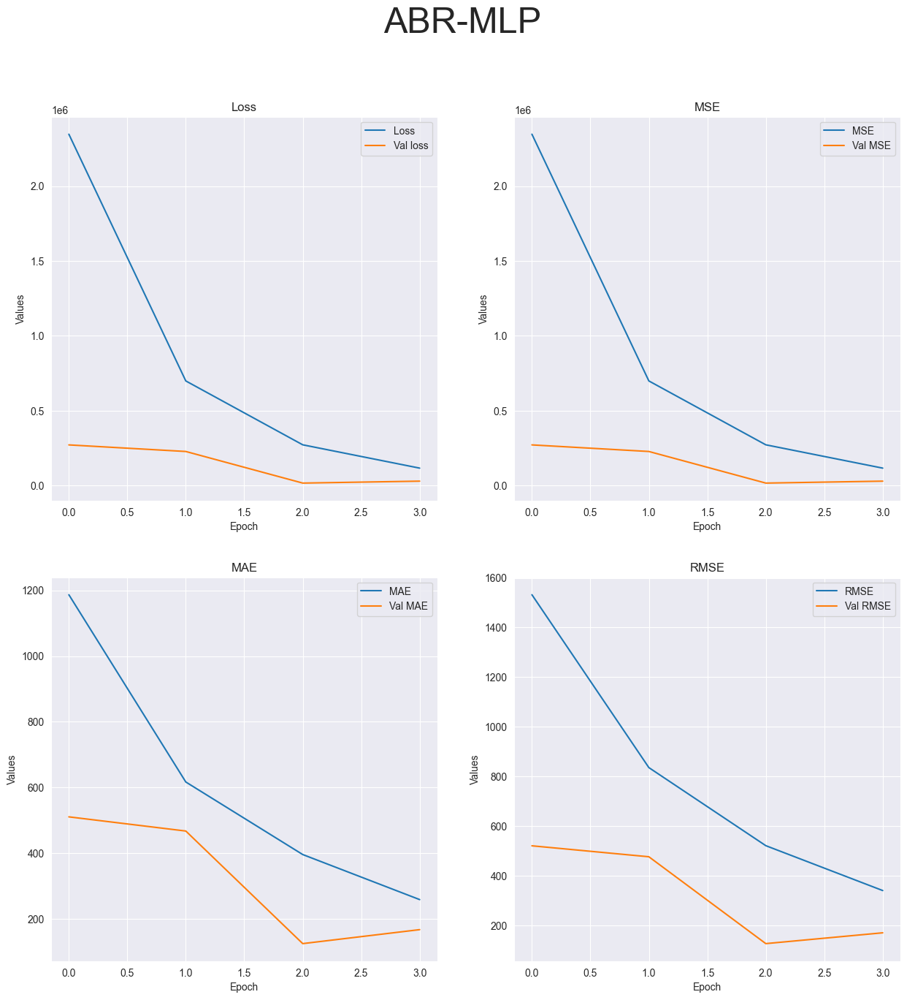

R-squared value: -113428.4765


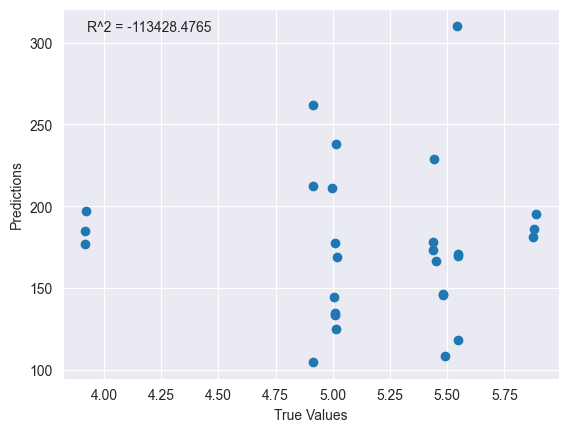

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_117 (Dense)           (None, 64)                832       
                                                                 
 dropout_30 (Dropout)        (None, 64)                0         
                                                                 
 dense_118 (Dense)       

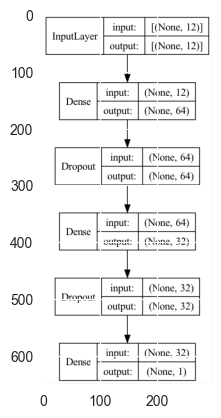

Epoch 1/10


2023-05-02 01:46:46.308050: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 178ms/step - loss: 2436350.2500 - mse: 2436350.2500 - mae: 1168.7980 - root_mean_squared_error: 1560.8812 - val_loss: 118837.6172 - val_mse: 118837.6172 - val_mae: 329.4823 - val_root_mean_squared_error: 344.7283
Epoch 2/10
3/3 [==============================] - 0s 29ms/step - loss: 335455.9688 - mse: 335455.9688 - mae: 432.9859 - root_mean_squared_error: 579.1856 - val_loss: 34983.8438 - val_mse: 34983.8438 - val_mae: 178.8756 - val_root_mean_squared_error: 187.0397
Epoch 3/10
1/3 [=========>....................] - ETA: 0s - loss: 161526.7344 - mse: 161526.7344 - mae: 315.2720 - root_mean_squared_error: 401.9039

2023-05-02 01:46:46.867043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 29ms/step - loss: 122082.7266 - mse: 122082.7422 - mae: 270.4722 - root_mean_squared_error: 349.4034 - val_loss: 13117.8574 - val_mse: 13117.8574 - val_mae: 108.8435 - val_root_mean_squared_error: 114.5332
Epoch 4/10
3/3 [==============================] - 0s 51ms/step - loss: 53617.6406 - mse: 53617.6406 - mae: 172.8309 - root_mean_squared_error: 231.5548 - val_loss: 20973.9297 - val_mse: 20973.9297 - val_mae: 137.7233 - val_root_mean_squared_error: 144.8238
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 48796.7344 - mse: 48796.7344 - mae: 169.0776 - root_mean_squared_error: 220.8998 - val_loss: 19660.7891 - val_mse: 19660.7891 - val_mae: 133.2961 - val_root_mean_squared_error: 140.2169
Epoch 6/10
3/3 [==============================] - 0s 23ms/step - loss: 34328.0234 - mse: 34328.0234 - mae: 150.8915 - root_mean_squared_error: 185.2782 - val_loss: 12232.3750 - val_mse: 12232.3750 - val_mae: 104.9930 - val_root_mean_squar

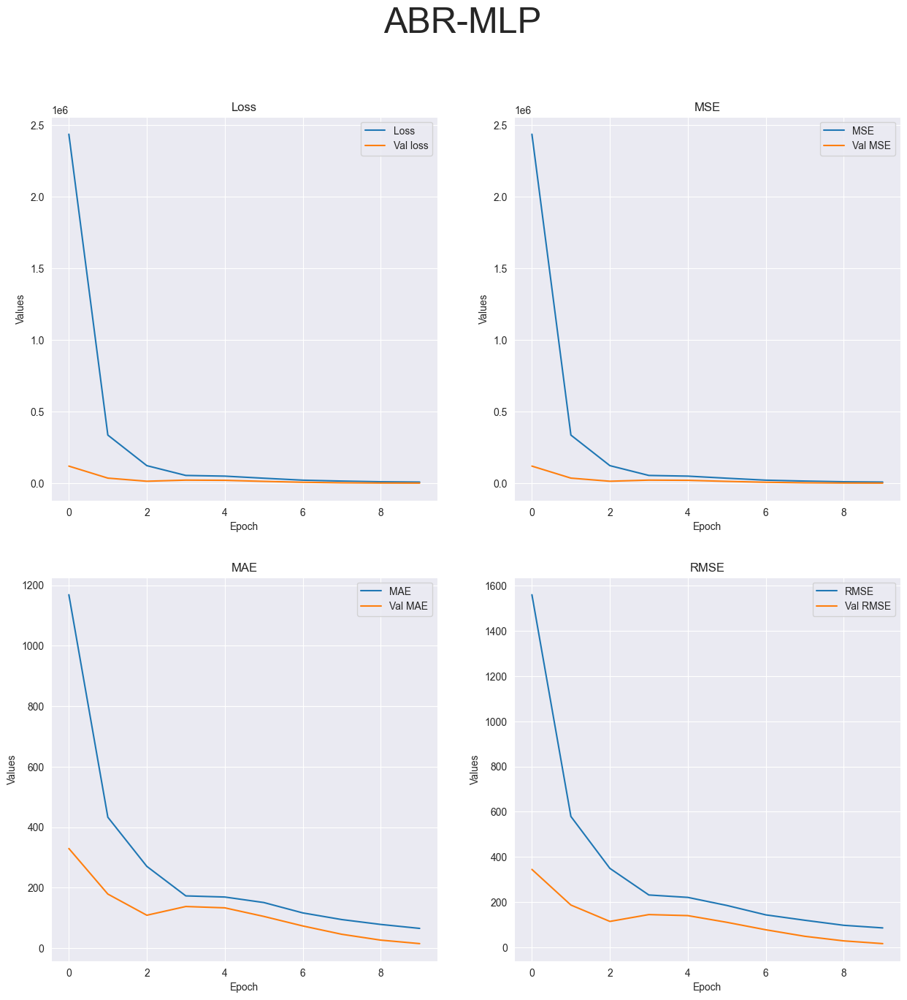

R-squared value: -820.4471


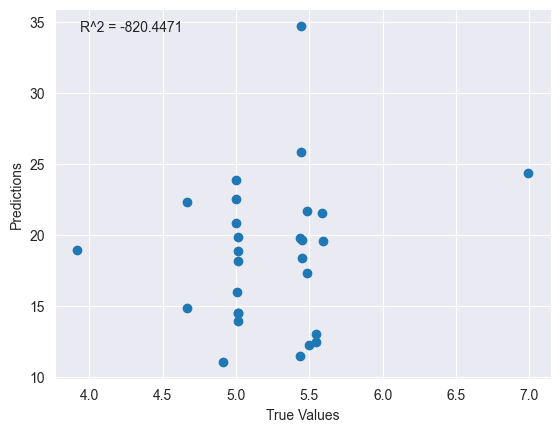

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_120 (Dense)           (None, 64)                832       
                                                                 
 dropout_32 (Dropout)        (None, 64)                0         
                                                                 
 dense_121 (Dense)       

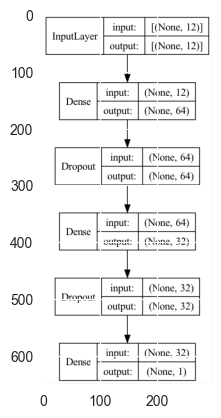

Epoch 1/20


2023-05-02 01:46:48.856402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 159ms/step - loss: 2107913.2500 - mse: 2107913.2500 - mae: 1133.3182 - root_mean_squared_error: 1451.8655 - val_loss: 262856.5625 - val_mse: 262856.5625 - val_mae: 485.9444 - val_root_mean_squared_error: 512.6954
Epoch 2/20
3/3 [==============================] - 0s 29ms/step - loss: 639309.1250 - mse: 639309.1250 - mae: 600.7132 - root_mean_squared_error: 799.5681 - val_loss: 129900.8906 - val_mse: 129900.8906 - val_mae: 341.4250 - val_root_mean_squared_error: 360.4177
Epoch 3/20
1/3 [=========>....................] - ETA: 0s - loss: 311822.5625 - mse: 311822.5625 - mae: 435.2658 - root_mean_squared_error: 558.4108

2023-05-02 01:46:49.335827: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 30ms/step - loss: 188215.3906 - mse: 188215.3906 - mae: 319.1264 - root_mean_squared_error: 433.8380 - val_loss: 60689.2930 - val_mse: 60689.2930 - val_mae: 232.3977 - val_root_mean_squared_error: 246.3520
Epoch 4/20
3/3 [==============================] - 0s 48ms/step - loss: 92637.4375 - mse: 92637.4375 - mae: 234.1467 - root_mean_squared_error: 304.3640 - val_loss: 83400.1172 - val_mse: 83400.1172 - val_mae: 272.5185 - val_root_mean_squared_error: 288.7908
Epoch 5/20
3/3 [==============================] - 0s 21ms/step - loss: 81779.7109 - mse: 81779.7188 - mae: 237.0910 - root_mean_squared_error: 285.9715 - val_loss: 49503.5742 - val_mse: 49503.5742 - val_mae: 209.8271 - val_root_mean_squared_error: 222.4940
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 44376.7305 - mse: 44376.7305 - mae: 174.6916 - root_mean_squared_error: 210.6579 - val_loss: 22297.3359 - val_mse: 22297.3359 - val_mae: 140.6888 - val_root_mean_squar

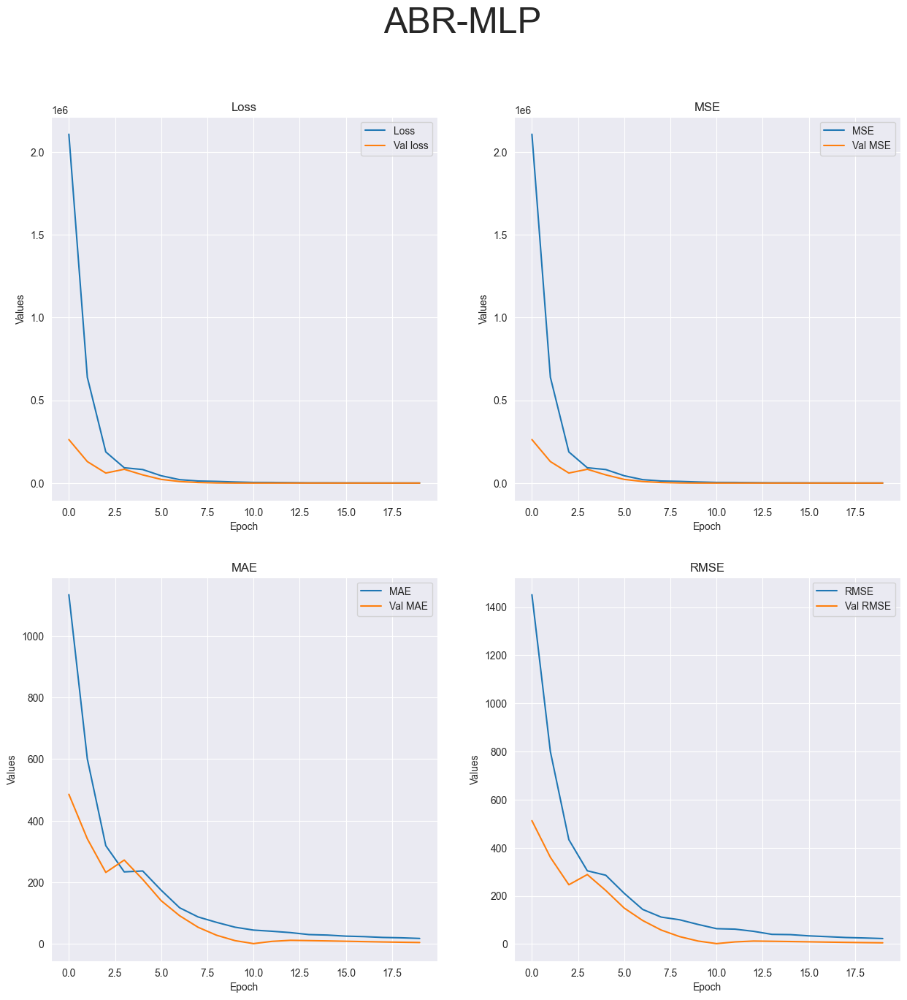

R-squared value: -45.1836


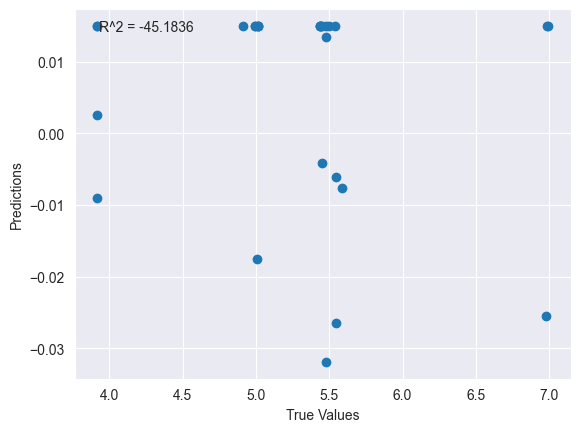

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_123 (Dense)           (None, 64)                832       
                                                                 
 dense_124 (Dense)           (None, 32)                2080      
                                                                

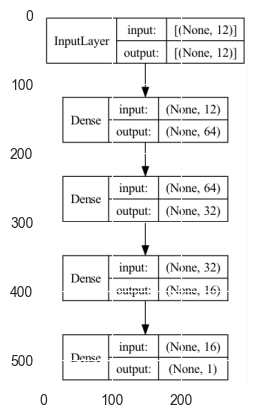

2023-05-02 01:46:51.967784: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 52ms/step - loss: 139796.0469 - mse: 139796.0469 - mae: 358.8465 - root_mean_squared_error: 373.8931


2023-05-02 01:46:52.382562: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [139796.046875, 139796.046875, 358.8464660644531, 373.8930969238281]
['loss', 'mse', 'mae', 'root_mean_squared_error']


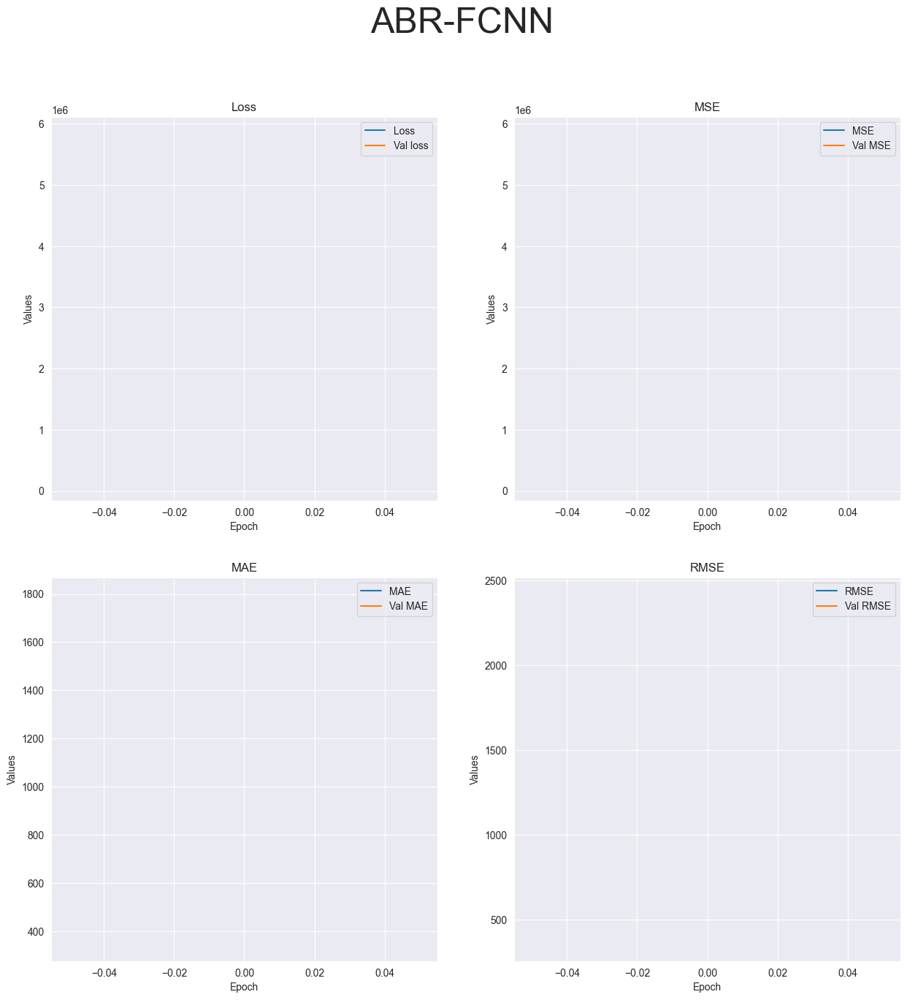

R-squared value: -255004.1045


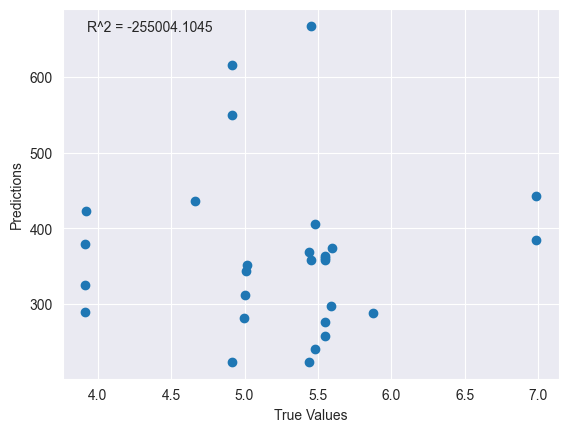

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_127 (Dense)           (None, 64)                832       
                                                                 
 dense_128 (Dense)           (None, 32)                2080      
                                                                 
 dense_129 (Dense)        

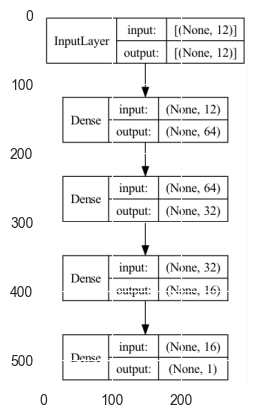

Epoch 1/4
1/3 [=========>....................] - ETA: 0s - loss: 59666.3828 - mse: 59666.3828 - mae: 233.6820 - root_mean_squared_error: 244.2670

2023-05-02 01:46:53.779973: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 396ms/step - loss: 6297443.0000 - mse: 6297443.0000 - mae: 1826.4677 - root_mean_squared_error: 2509.4707 - val_loss: 185965.7344 - val_mse: 185965.7344 - val_mae: 417.2980 - val_root_mean_squared_error: 431.2375
Epoch 2/4
3/3 [==============================] - 0s 37ms/step - loss: 1519777.5000 - mse: 1519777.5000 - mae: 1057.8990 - root_mean_squared_error: 1232.7926 - val_loss: 2290241.7500 - val_mse: 2290241.7500 - val_mae: 1465.4106 - val_root_mean_squared_error: 1513.3545
Epoch 3/4


2023-05-02 01:46:54.666439: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 44ms/step - loss: 1250616.6250 - mse: 1250616.6250 - mae: 1008.1050 - root_mean_squared_error: 1118.3097 - val_loss: 3268.6848 - val_mse: 3268.6848 - val_mae: 54.5978 - val_root_mean_squared_error: 57.1724
Epoch 4/4
1/1 [==============================] - 0s 47ms/step - loss: 470090.5000 - mse: 470090.5000 - mae: 665.1460 - root_mean_squared_error: 685.6315
Test loss: [470090.5, 470090.5, 665.14599609375, 685.6314697265625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


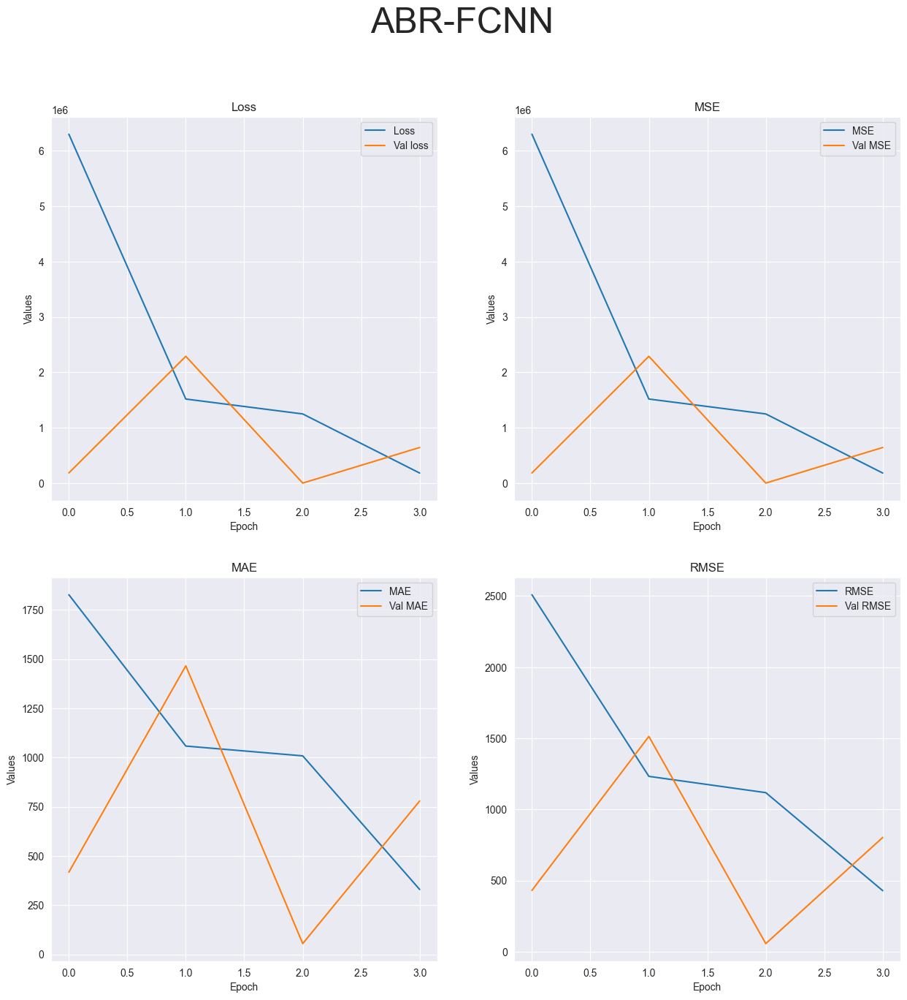

R-squared value: -1504220.3852


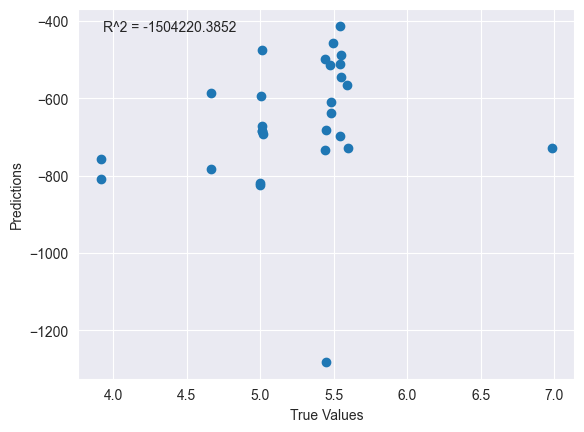

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_131 (Dense)           (None, 64)                832       
                                                                 
 dense_132 (Dense)           (None, 32)                2080      
                                                                 
 dense_133 (Dense)       

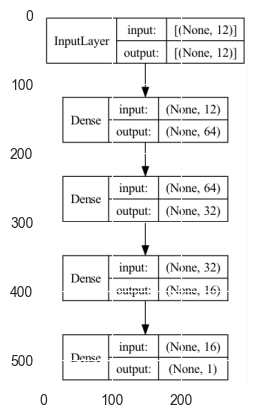

Epoch 1/10


2023-05-02 01:46:56.367885: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 152ms/step - loss: 6175532.5000 - mse: 6175532.5000 - mae: 1851.7581 - root_mean_squared_error: 2485.0618 - val_loss: 171323.0781 - val_mse: 171323.0781 - val_mae: 396.3457 - val_root_mean_squared_error: 413.9119
Epoch 2/10
3/3 [==============================] - 0s 32ms/step - loss: 1634076.0000 - mse: 1634076.0000 - mae: 1117.3917 - root_mean_squared_error: 1278.3098 - val_loss: 1786992.0000 - val_mse: 1786992.0000 - val_mae: 1280.1001 - val_root_mean_squared_error: 1336.7842
Epoch 3/10


2023-05-02 01:46:56.829563: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 27ms/step - loss: 1445532.8750 - mse: 1445532.8750 - mae: 1119.5111 - root_mean_squared_error: 1202.3031 - val_loss: 64437.8594 - val_mse: 64437.8594 - val_mae: 242.4428 - val_root_mean_squared_error: 253.8461
Epoch 4/10
3/3 [==============================] - 0s 22ms/step - loss: 99084.1484 - mse: 99084.1484 - mae: 273.2752 - root_mean_squared_error: 314.7763 - val_loss: 342282.9688 - val_mse: 342282.9688 - val_mae: 561.2449 - val_root_mean_squared_error: 585.0496
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 436483.4062 - mse: 436483.4062 - mae: 637.2332 - root_mean_squared_error: 660.6689 - val_loss: 208520.4844 - val_mse: 208520.4844 - val_mae: 438.1962 - val_root_mean_squared_error: 456.6404
Epoch 6/10
3/3 [==============================] - 0s 23ms/step - loss: 172888.2344 - mse: 172888.2344 - mae: 388.8049 - root_mean_squared_error: 415.7983 - val_loss: 24955.1523 - val_mse: 24955.1523 - val_mae: 151.9617 - val_roo

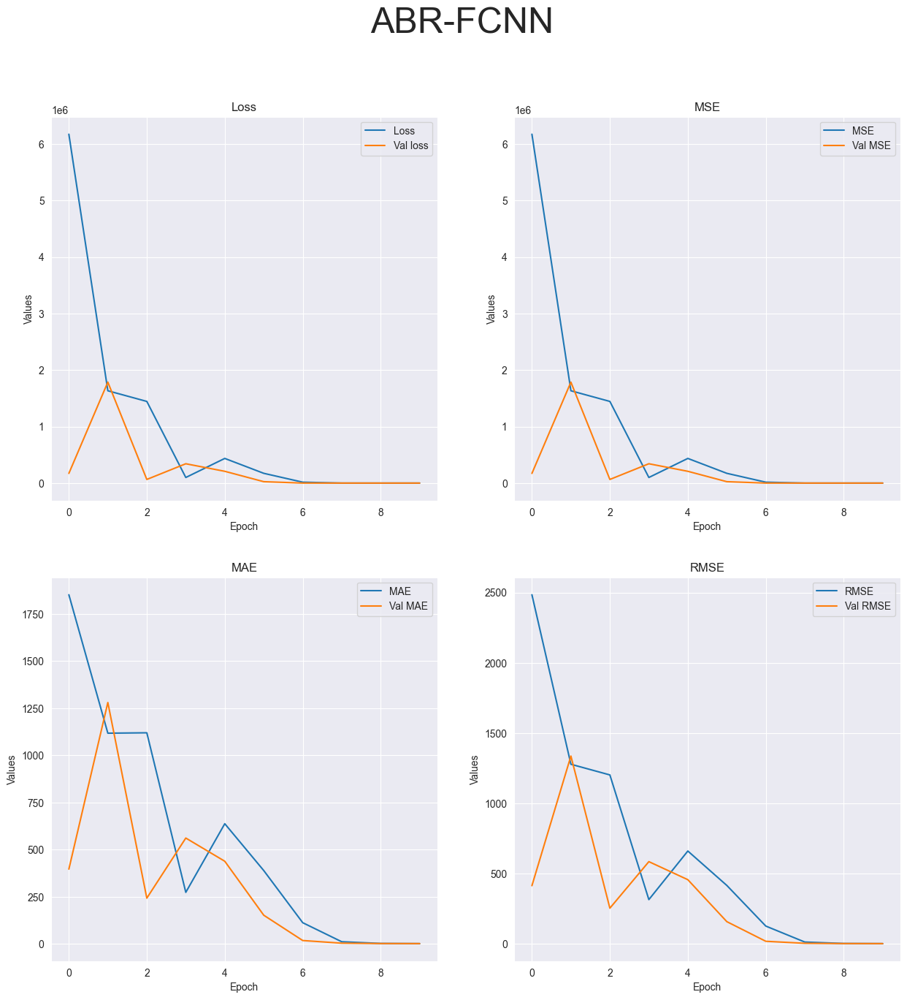

R-squared value: -4.3689


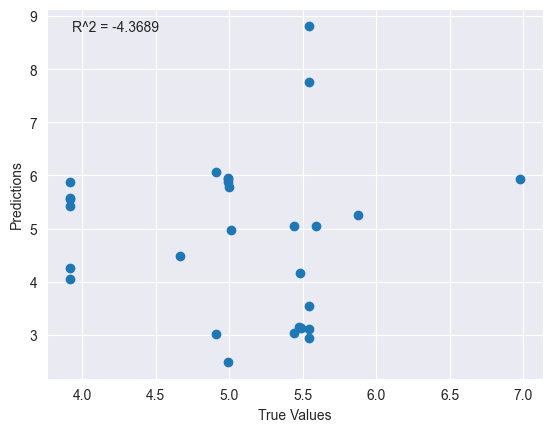

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_135 (Dense)           (None, 64)                832       
                                                                 
 dense_136 (Dense)           (None, 32)                2080      
                                                                 
 dense_137 (Dense)       

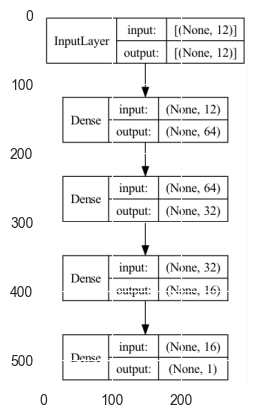

Epoch 1/20


2023-05-02 01:46:58.797269: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 178ms/step - loss: 7022784.0000 - mse: 7022784.0000 - mae: 1887.9496 - root_mean_squared_error: 2650.0535 - val_loss: 154295.2656 - val_mse: 154295.2656 - val_mae: 380.6127 - val_root_mean_squared_error: 392.8044
Epoch 2/20
3/3 [==============================] - 0s 29ms/step - loss: 1334563.3750 - mse: 1334563.3750 - mae: 998.2399 - root_mean_squared_error: 1155.2330 - val_loss: 2365796.5000 - val_mse: 2365796.5000 - val_mae: 1491.8859 - val_root_mean_squared_error: 1538.1146
Epoch 3/20
1/3 [=========>....................] - ETA: 0s - loss: 1853001.2500 - mse: 1853001.2500 - mae: 1322.5093 - root_mean_squared_error: 1361.2499

2023-05-02 01:46:59.307678: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 29ms/step - loss: 1338739.8750 - mse: 1338739.8750 - mae: 1082.1102 - root_mean_squared_error: 1157.0393 - val_loss: 47302.8906 - val_mse: 47302.8906 - val_mae: 210.3604 - val_root_mean_squared_error: 217.4923
Epoch 4/20
3/3 [==============================] - 0s 44ms/step - loss: 146780.4219 - mse: 146780.4219 - mae: 322.7286 - root_mean_squared_error: 383.1193 - val_loss: 606745.6875 - val_mse: 606745.6875 - val_mae: 756.4954 - val_root_mean_squared_error: 778.9388
Epoch 5/20
3/3 [==============================] - 0s 22ms/step - loss: 520401.8750 - mse: 520401.8750 - mae: 691.8679 - root_mean_squared_error: 721.3889 - val_loss: 296019.3125 - val_mse: 296019.3125 - val_mae: 528.5551 - val_root_mean_squared_error: 544.0765
Epoch 6/20
3/3 [==============================] - 0s 20ms/step - loss: 168365.3438 - mse: 168365.3438 - mae: 375.9878 - root_mean_squared_error: 410.3235 - val_loss: 15588.5303 - val_mse: 15588.5303 - val_mae: 121.6896 - val_r

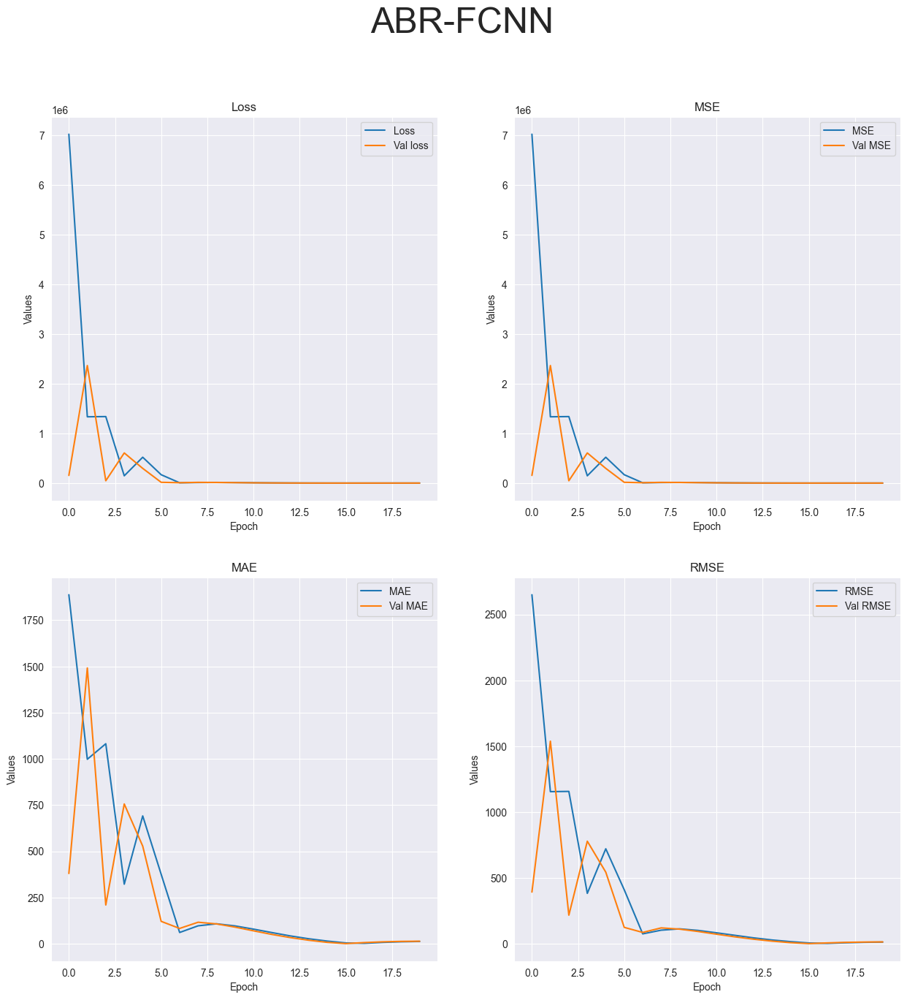

R-squared value: -336.5189


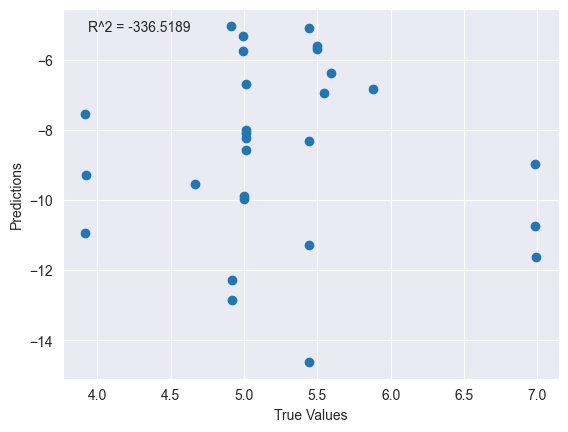

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_139 (Dense)           (None, 128)               1664      
                                                                 
 dense_140 (Dense)           (None, 1)                 129       
                                                             

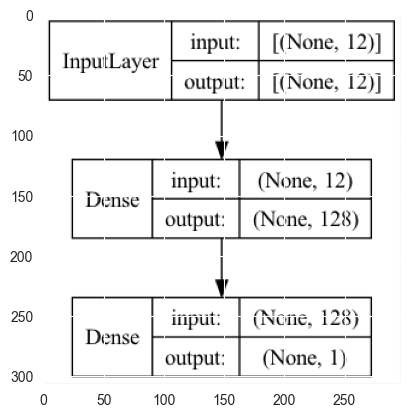

1/3 [=========>....................] - ETA: 0s - loss: 779047552.0000 - mse: 779047552.0000 - mae: 26659.5781 - root_mean_squared_error: 27911.4238

2023-05-02 01:47:01.779956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 47ms/step - loss: 354582528.0000 - mse: 354582528.0000 - mae: 18119.9531 - root_mean_squared_error: 18830.3613


2023-05-02 01:47:02.273910: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [354582528.0, 354582528.0, 18119.953125, 18830.361328125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


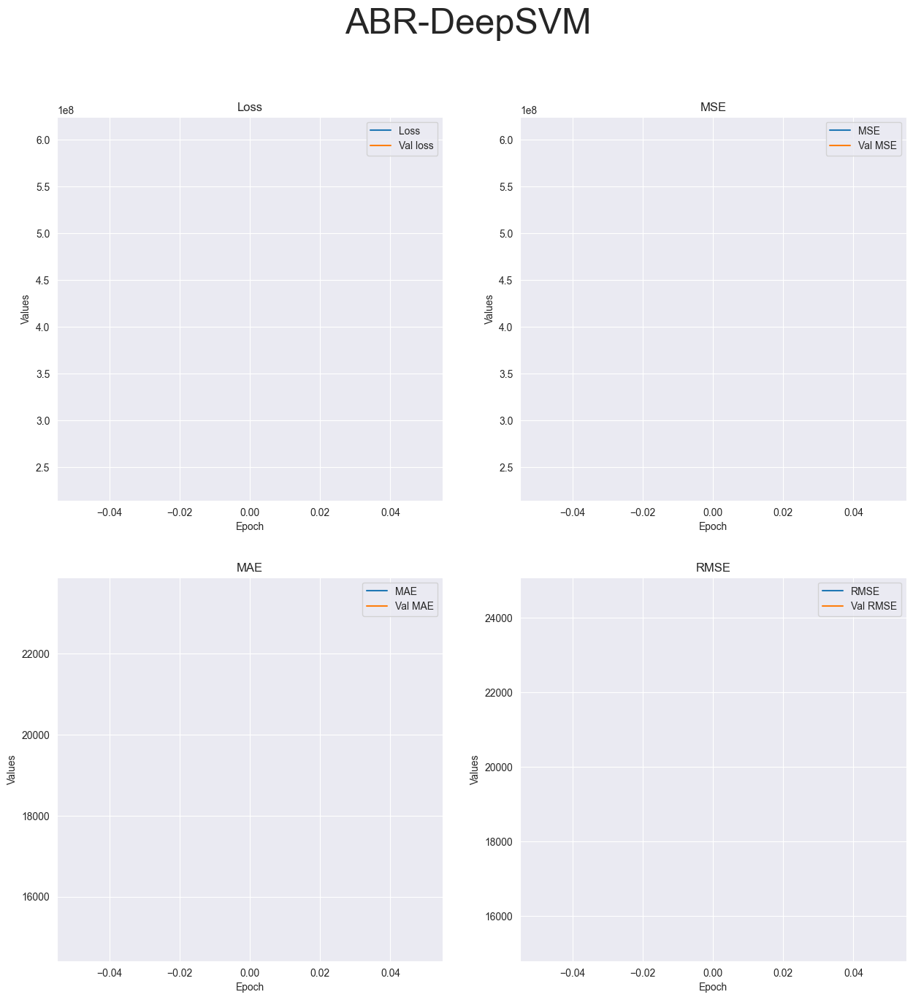

R-squared value: -597891003.3766


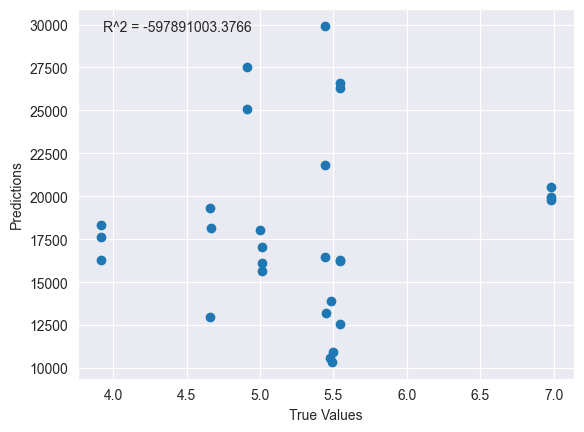

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_141 (Dense)           (None, 128)               1664      
                                                                 
 dense_142 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Traina

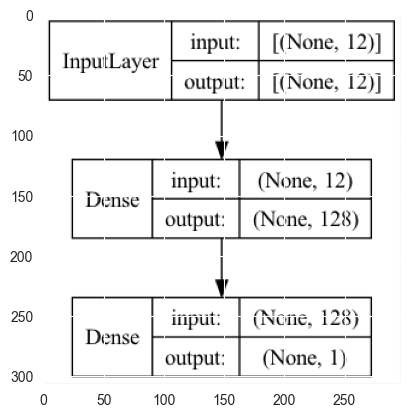

Epoch 1/4


2023-05-02 01:47:04.305812: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 164ms/step - loss: 610194496.0000 - mse: 610194496.0000 - mae: 23415.5938 - root_mean_squared_error: 24702.1152 - val_loss: 339448864.0000 - val_mse: 339448864.0000 - val_mae: 17635.8125 - val_root_mean_squared_error: 18424.1387
Epoch 2/4
3/3 [==============================] - 0s 26ms/step - loss: 239905520.0000 - mse: 239905520.0000 - mae: 14720.5166 - root_mean_squared_error: 15488.8838 - val_loss: 131492712.0000 - val_mse: 131492712.0000 - val_mae: 10972.8223 - val_root_mean_squared_error: 11467.0273
Epoch 3/4
1/3 [=========>....................] - ETA: 0s - loss: 121328952.0000 - mse: 121328952.0000 - mae: 10639.5234 - root_mean_squared_error: 11014.9424

2023-05-02 01:47:04.787653: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 23ms/step - loss: 92091080.0000 - mse: 92091080.0000 - mae: 9131.9824 - root_mean_squared_error: 9596.4102 - val_loss: 49703412.0000 - val_mse: 49703412.0000 - val_mae: 6743.5122 - val_root_mean_squared_error: 7050.0645
Epoch 4/4
1/1 [==============================] - 0s 41ms/step - loss: 16308408.0000 - mse: 16308408.0000 - mae: 3885.7300 - root_mean_squared_error: 4038.3669
Test loss: [16308408.0, 16308408.0, 3885.72998046875, 4038.366943359375]
['loss', 'mse', 'mae', 'root_mean_squared_error']


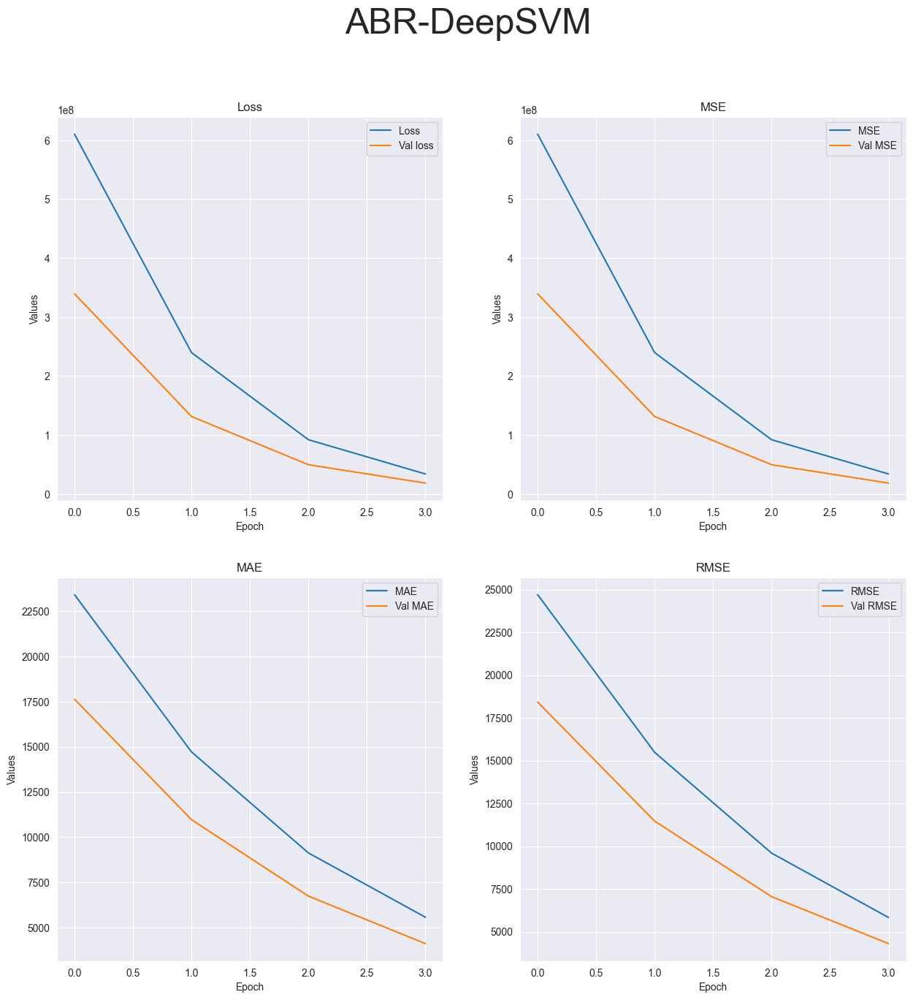

R-squared value: -32293859.3240


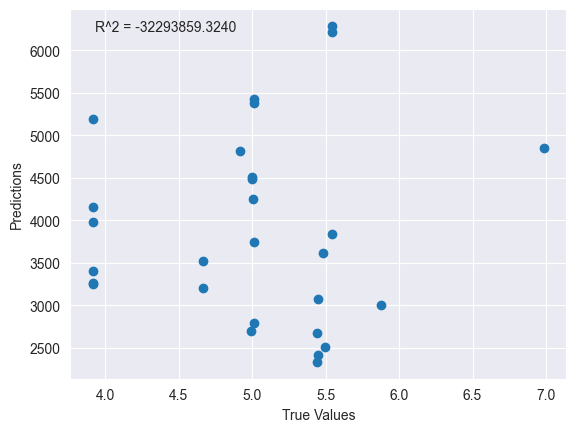

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_143 (Dense)           (None, 128)               1664      
                                                                 
 dense_144 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

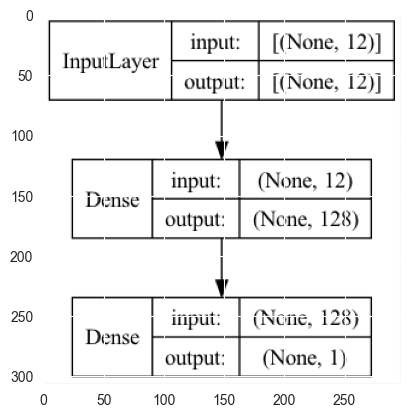

Epoch 1/10
1/3 [=========>....................] - ETA: 0s - loss: 673728768.0000 - mse: 673728768.0000 - mae: 24785.5703 - root_mean_squared_error: 25956.2852

2023-05-02 01:47:06.404940: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 143ms/step - loss: 613369024.0000 - mse: 613369024.0000 - mae: 23710.1172 - root_mean_squared_error: 24766.2871 - val_loss: 284153824.0000 - val_mse: 284153824.0000 - val_mae: 16280.2266 - val_root_mean_squared_error: 16856.8633
Epoch 2/10
3/3 [==============================] - 0s 22ms/step - loss: 245995408.0000 - mse: 245995408.0000 - mae: 14841.1377 - root_mean_squared_error: 15684.2412 - val_loss: 103838696.0000 - val_mse: 103838696.0000 - val_mae: 9839.1475 - val_root_mean_squared_error: 10190.1270
Epoch 3/10
1/3 [=========>....................] - ETA: 0s - loss: 135329872.0000 - mse: 135329872.0000 - mae: 11122.8613 - root_mean_squared_error: 11633.1367

2023-05-02 01:47:06.770712: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 27ms/step - loss: 91418880.0000 - mse: 91418880.0000 - mae: 8979.0420 - root_mean_squared_error: 9561.3223 - val_loss: 37226156.0000 - val_mse: 37226156.0000 - val_mae: 5889.4448 - val_root_mean_squared_error: 6101.3242
Epoch 4/10
3/3 [==============================] - 0s 37ms/step - loss: 31037836.0000 - mse: 31037836.0000 - mae: 5312.2188 - root_mean_squared_error: 5571.1611 - val_loss: 13333894.0000 - val_mse: 13333894.0000 - val_mae: 3523.4697 - val_root_mean_squared_error: 3651.5605
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 11251537.0000 - mse: 11251537.0000 - mae: 3167.6897 - root_mean_squared_error: 3354.3311 - val_loss: 4288460.5000 - val_mse: 4288460.0000 - val_mae: 1997.0275 - val_root_mean_squared_error: 2070.8596
Epoch 6/10
3/3 [==============================] - 0s 16ms/step - loss: 3352713.2500 - mse: 3352713.2500 - mae: 1719.1479 - root_mean_squared_error: 1831.0416 - val_loss: 874501.3125 - val_mse: 8

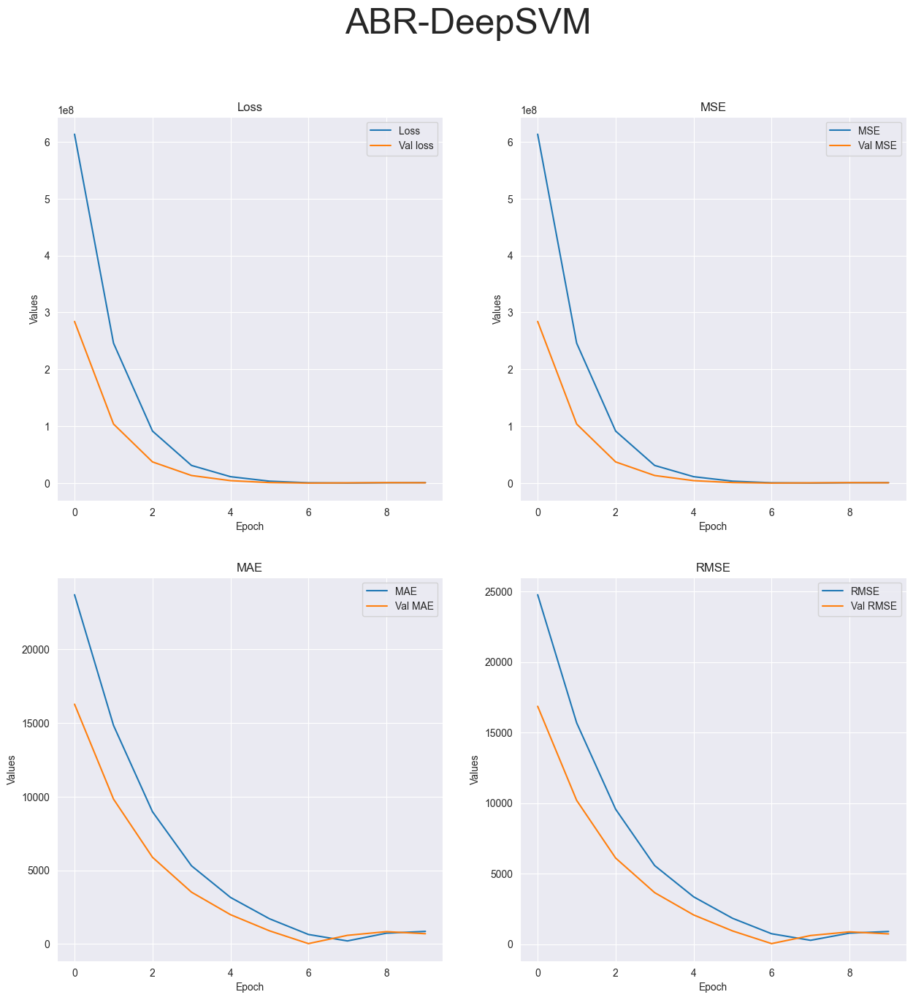

R-squared value: -1018981.0871


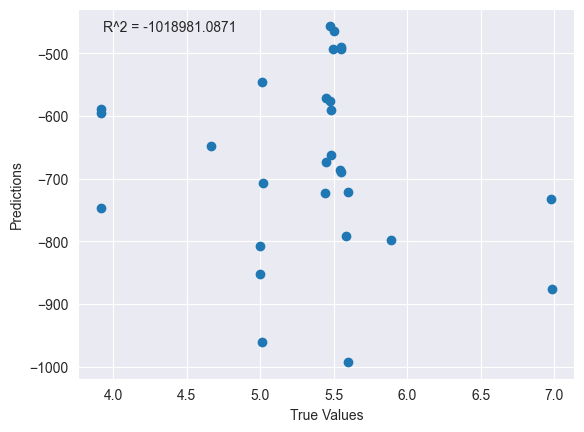

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_145 (Dense)           (None, 128)               1664      
                                                                 
 dense_146 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

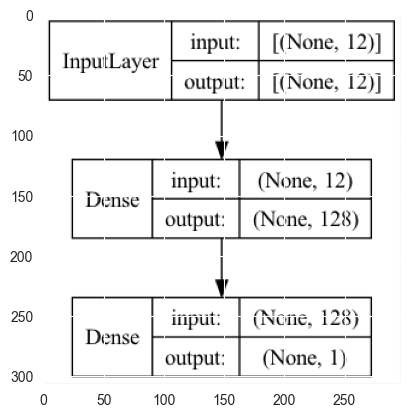

Epoch 1/20


2023-05-02 01:47:08.641182: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 172ms/step - loss: 600690624.0000 - mse: 600690624.0000 - mae: 23347.4316 - root_mean_squared_error: 24508.9902 - val_loss: 241712000.0000 - val_mse: 241712000.0000 - val_mae: 15177.9717 - val_root_mean_squared_error: 15547.0898
Epoch 2/20
3/3 [==============================] - 0s 30ms/step - loss: 233101104.0000 - mse: 233101104.0000 - mae: 14564.8516 - root_mean_squared_error: 15267.6494 - val_loss: 90637488.0000 - val_mse: 90637488.0000 - val_mae: 9291.6104 - val_root_mean_squared_error: 9520.3721
Epoch 3/20


2023-05-02 01:47:09.125018: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 28ms/step - loss: 88496288.0000 - mse: 88496288.0000 - mae: 8901.0225 - root_mean_squared_error: 9407.2461 - val_loss: 33043966.0000 - val_mse: 33043966.0000 - val_mae: 5608.2451 - val_root_mean_squared_error: 5748.3882
Epoch 4/20
3/3 [==============================] - 0s 21ms/step - loss: 32391560.0000 - mse: 32391560.0000 - mae: 5391.5981 - root_mean_squared_error: 5691.3584 - val_loss: 11847669.0000 - val_mse: 11847669.0000 - val_mae: 3356.5862 - val_root_mean_squared_error: 3442.0442
Epoch 5/20
3/3 [==============================] - 0s 17ms/step - loss: 11689368.0000 - mse: 11689368.0000 - mae: 3213.5354 - root_mean_squared_error: 3418.9717 - val_loss: 3863361.7500 - val_mse: 3863361.5000 - val_mae: 1915.3376 - val_root_mean_squared_error: 1965.5436
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 3520545.0000 - mse: 3520544.2500 - mae: 1759.9224 - root_mean_squared_error: 1876.3114 - val_loss: 858304.8750 - val_mse: 8

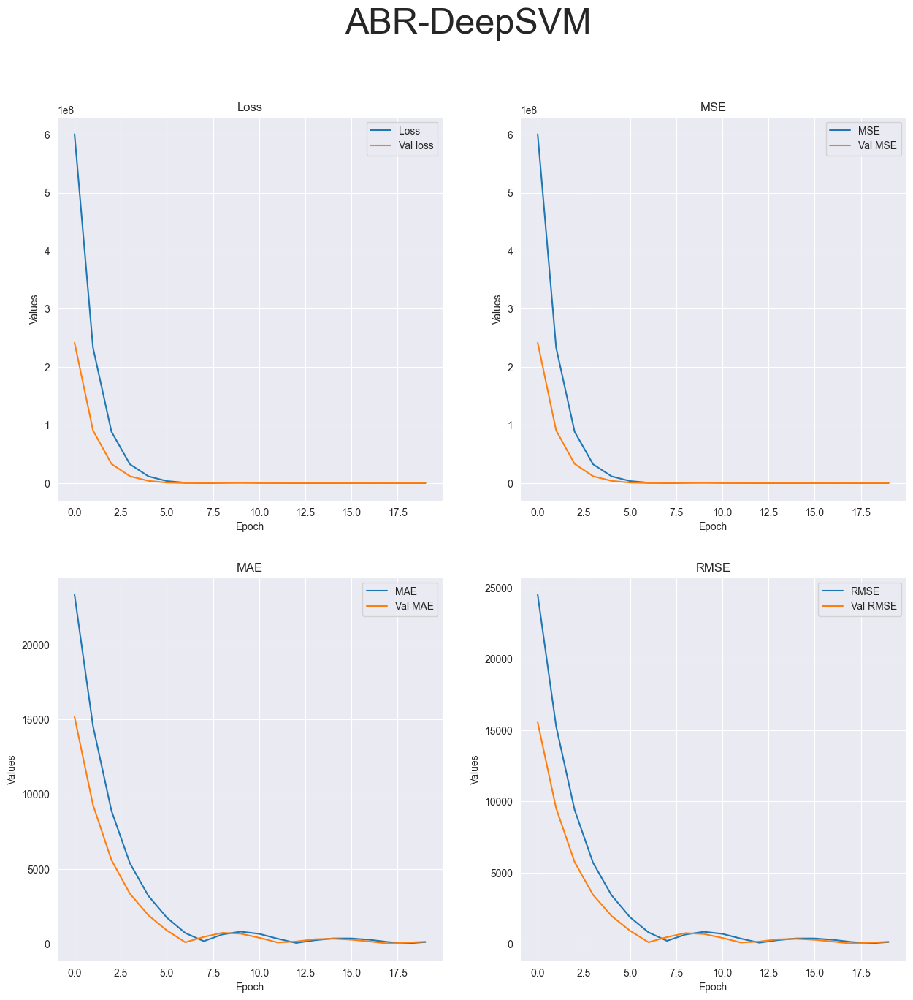

R-squared value: -80776.8957


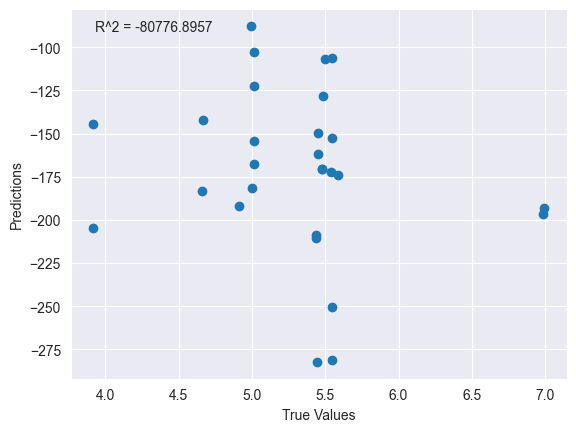

Running MachineLearning tests...
Running tests on CGBR.csv dataset...
Running Linear model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Running SVR model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
plotting linear


ValueError: x and y must be the same size

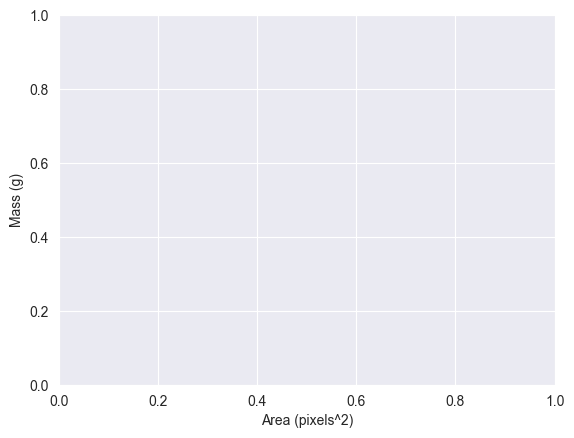

In [20]:
for experiment_name, experiment_data in RawExperiments.items():
    print(f"Running experiments for {experiment_name}...")
    for test_name, test_data in experiment_data["Tests"].items():
        print(f"Running {test_name} tests...")
        for dataset in test_data["Datasets"]:
            print(f"Running tests on {dataset + test_data['Extention']} dataset...")
            for model in test_data["Models"]:
                print(f"Running {model} model tests...")
                if "Epochs" in test_data:
                    for epochs in test_data["Epochs"]:
                        print(f"Running tests with {epochs} epochs...")

                        # Call the function that runs the test with the given dataset, model, and epoch

                        dataframe = None
                        if(test_data["Extention"] == '.pkl'):
                            dataframe = pd.read_pickle(dataset + test_data['Extention'])
                        else:
                            dataframe = pd.read_csv(dataset + test_data['Extention'])
                        test = AutomaticLearning(dataframe, dataset + "-" + model, model)
                        test.buildData()
                        test.buildModel()
                        test.train(epochs)
                        test.plot()


   ID  AverageMass                                                img
0   1       4.8566  [[[133, 177, 201], [134, 178, 202], [139, 184,...
1   2       4.8568  [[[120, 164, 188], [124, 167, 191], [123, 167,...
entrando
Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 146, 146, 3)  0           ['input_15[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 70, 70, 64)   9472        ['con

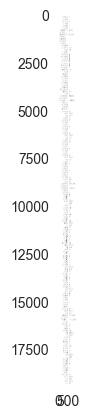

Epoch 1/40


2023-05-01 20:18:08.205275: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4.2779 - mse: 4.2779 - mae: 1.6941 - root_mean_squared_error: 2.0683

2023-05-01 20:18:14.967594: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 12s 574ms/step - loss: 4.2779 - mse: 4.2779 - mae: 1.6941 - root_mean_squared_error: 2.0683 - val_loss: 1.0162 - val_mse: 1.0162 - val_mae: 0.8718 - val_root_mean_squared_error: 1.0081
Epoch 2/40
16/16 [==============================] - 4s 252ms/step - loss: 0.9555 - mse: 0.9555 - mae: 0.7945 - root_mean_squared_error: 0.9775 - val_loss: 0.7004 - val_mse: 0.7004 - val_mae: 0.6979 - val_root_mean_squared_error: 0.8369
Epoch 3/40
16/16 [==============================] - 3s 206ms/step - loss: 0.7577 - mse: 0.7577 - mae: 0.7117 - root_mean_squared_error: 0.8704 - val_loss: 0.6010 - val_mse: 0.6010 - val_mae: 0.6195 - val_root_mean_squared_error: 0.7753
Epoch 4/40
16/16 [==============================] - 3s 223ms/step - loss: 0.6938 - mse: 0.6938 - mae: 0.6687 - root_mean_squared_error: 0.8330 - val_loss: 0.6008 - val_mse: 0.6008 - val_mae: 0.6200 - val_root_mean_squared_error: 0.7751
Epoch 5/40
16/16 [==============================] - 3s 191ms/step 

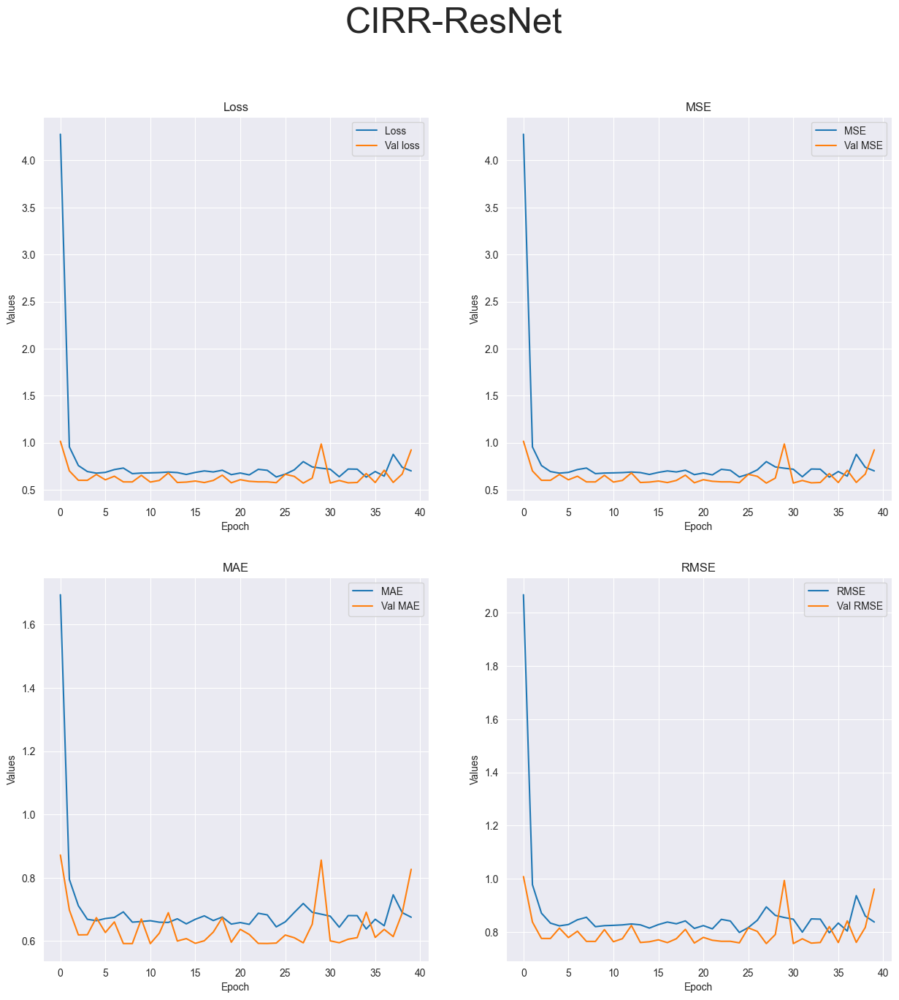

R-squared value: -0.3738


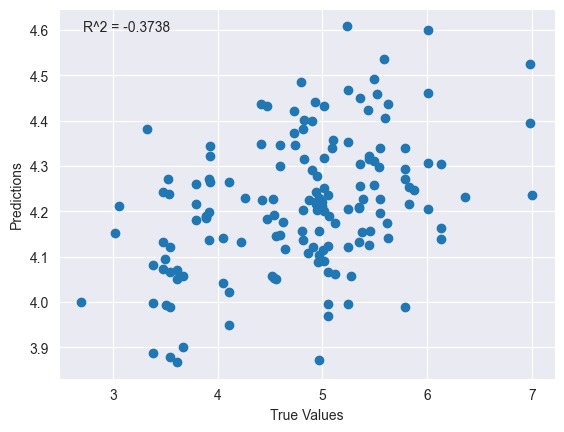

In [51]:
testdf = pd.read_pickle("croppedimagesRaspberriesRaw.pkl")
testcnn = AutomaticLearning(pd.read_pickle("croppedimagesRaspberriesRaw.pkl"), "CIRR-ResNet", "ResNet")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(40)
testcnn.plot()


plotting linear


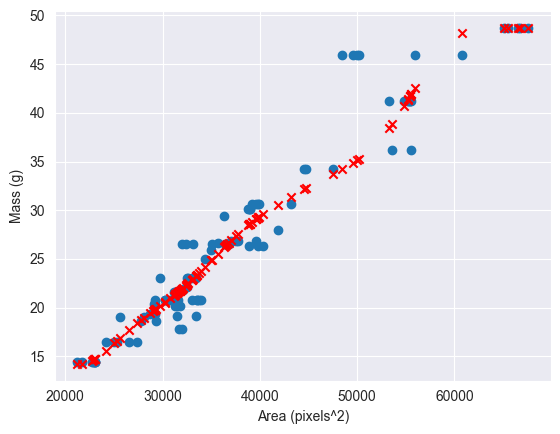

R-squared value: 0.9178


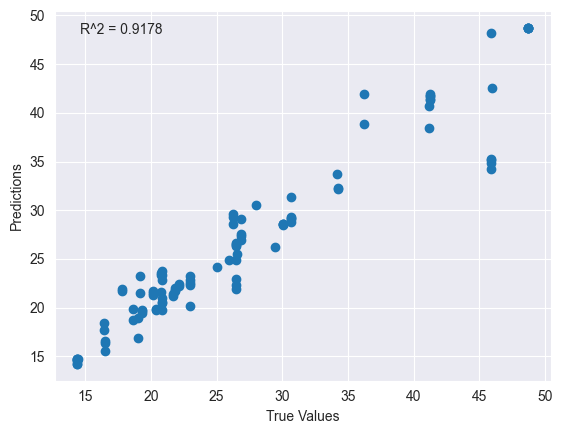

In [8]:

testsvr = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaSVR")
testsvr.buildData()
testsvr.buildModel("SVR")
testsvr.train(2200)
testsvr.plot()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 64)                832       
                                                                 
 dense_9 (Dense)             (None, 32)                2080      
                                                                 
 dense_10 (Dense)            (None, 16)                528       
                                                                 
 dense_11 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,457
Trainable params: 3,457
Non-trainable params: 0
_________________________________________________________________
None


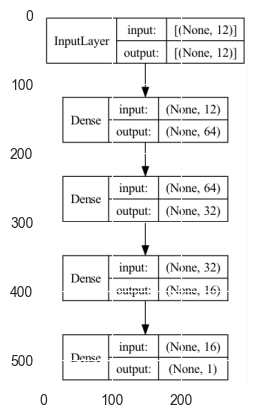

Epoch 1/10
 1/11 [=>............................] - ETA: 5s - loss: 377022.3750 - mse: 377022.3750 - mae: 587.8816 - root_mean_squared_error: 614.0215

2023-04-29 04:02:14.868265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 31ms/step - loss: 15895854.0000 - mse: 15895854.0000 - mae: 2913.8459 - root_mean_squared_error: 3986.9604 - val_loss: 101860.9062 - val_mse: 101860.9062 - val_mae: 307.9383 - val_root_mean_squared_error: 319.1566
Epoch 2/10
 8/11 [====================>.........] - ETA: 0s - loss: 976481.5000 - mse: 976481.5000 - mae: 914.2033 - root_mean_squared_error: 988.1708

2023-04-29 04:02:15.240663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 0s 11ms/step - loss: 946390.3125 - mse: 946390.3125 - mae: 904.1191 - root_mean_squared_error: 972.8259 - val_loss: 377234.4062 - val_mse: 377234.4062 - val_mae: 592.2183 - val_root_mean_squared_error: 614.1941
Epoch 3/10
11/11 [==============================] - 0s 11ms/step - loss: 122046.0703 - mse: 122046.0703 - mae: 296.6097 - root_mean_squared_error: 349.3509 - val_loss: 3624.8376 - val_mse: 3624.8376 - val_mae: 57.6960 - val_root_mean_squared_error: 60.2066
Epoch 4/10
11/11 [==============================] - 0s 11ms/step - loss: 737.0602 - mse: 737.0602 - mae: 19.2511 - root_mean_squared_error: 27.1489 - val_loss: 249.6129 - val_mse: 249.6129 - val_mae: 15.3938 - val_root_mean_squared_error: 15.7991
Epoch 5/10
11/11 [==============================] - 0s 10ms/step - loss: 384.6152 - mse: 384.6152 - mae: 18.9756 - root_mean_squared_error: 19.6116 - val_loss: 388.4864 - val_mse: 388.4864 - val_mae: 19.1997 - val_root_mean_squared_error: 19.71

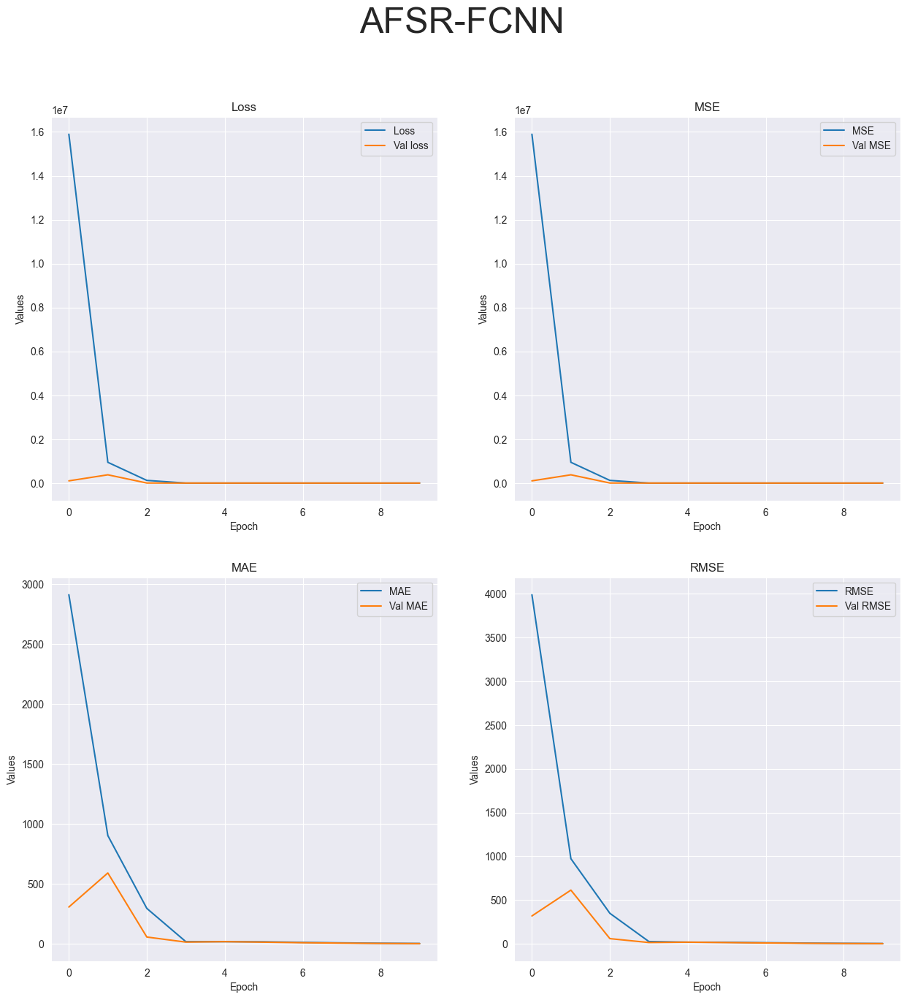

R-squared value: 0.8525


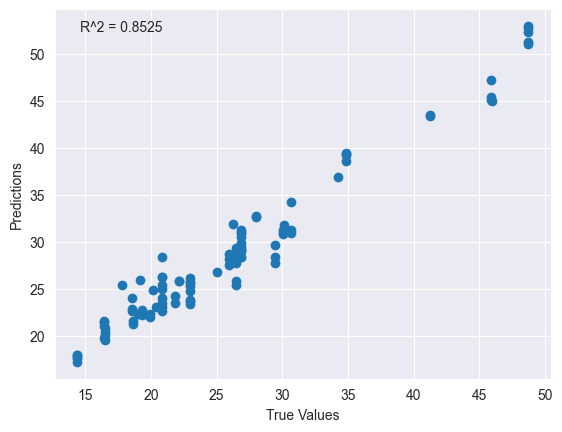

In [13]:

muchas = AutomaticLearning(pd.read_csv("allfeaturesStrawberriesRaw.csv"), "AFSR-FCNN")
muchas.buildData()
muchas.buildModel("FCNN")
muchas.train(10)
muchas.plot()

plotting linear


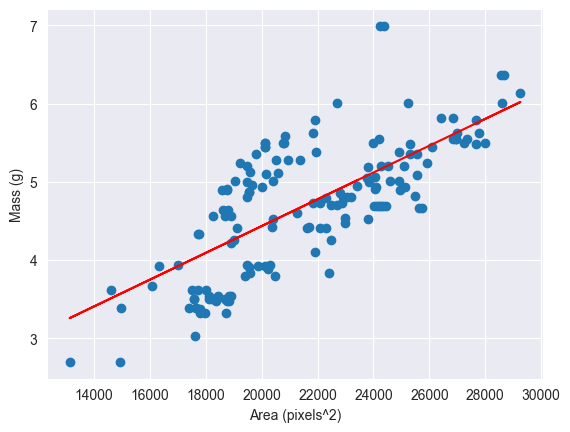

R-squared value: 0.5422


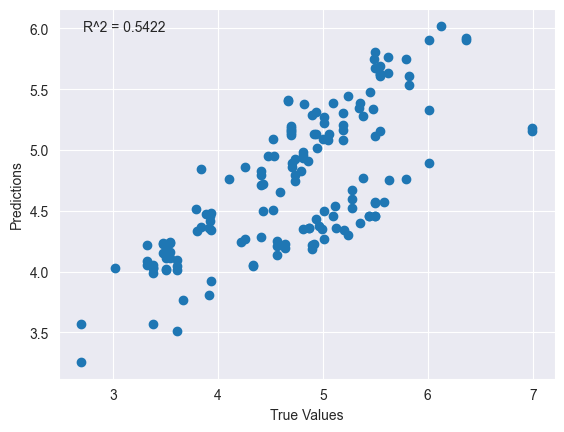

plotting linear


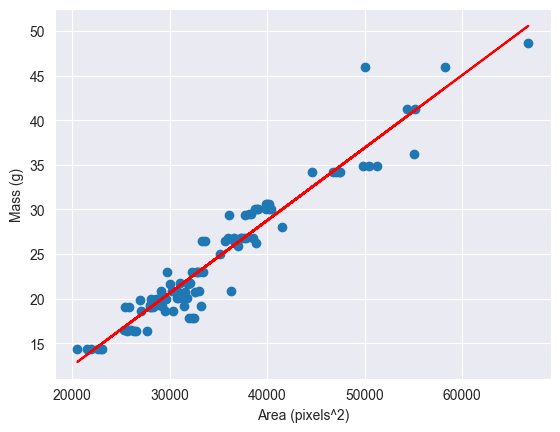

R-squared value: 0.9251


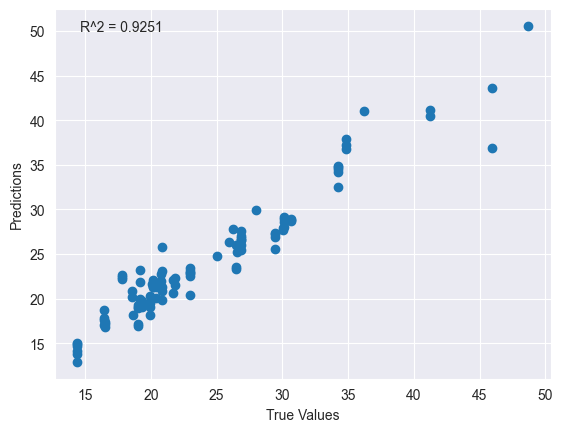

plotting linear


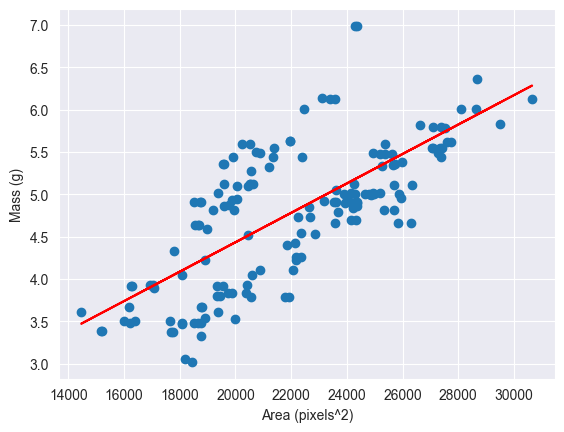

R-squared value: 0.5080


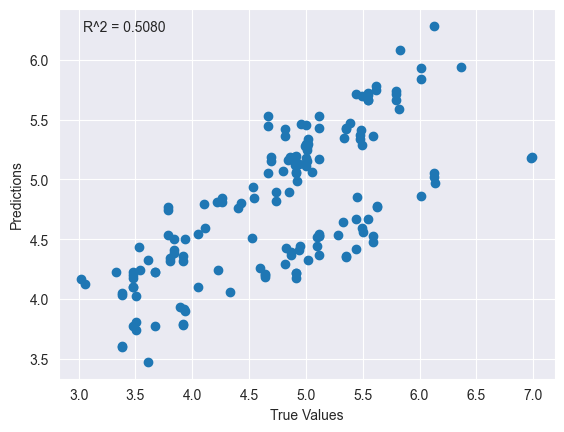

plotting linear


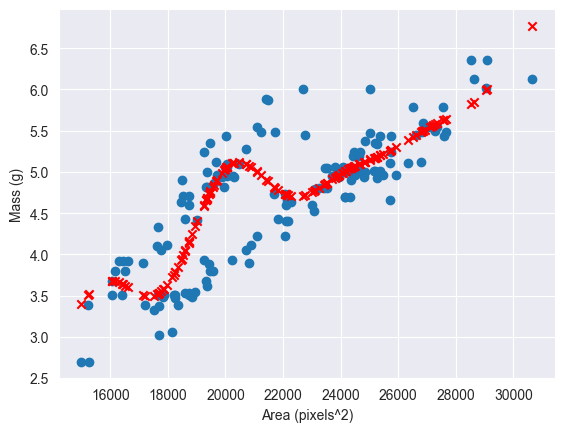

R-squared value: 0.6757


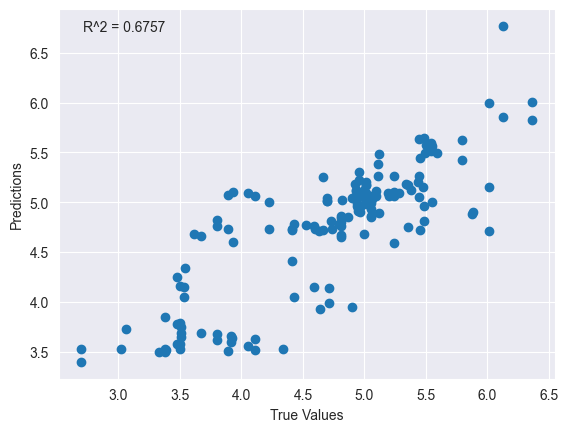

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_369 (Dense)           (None, 64)                192       
                                                                 
 dropout_112 (Dropout)       (None, 64)                0         
                                                                 
 dense_370 (Dense)           (None, 32)                2080      
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_371 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:10.454677: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664

2023-04-29 03:39:11.773911: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 64ms/step - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664 - val_loss: 57952.4336 - val_mse: 57952.4336 - val_mae: 237.5029 - val_root_mean_squared_error: 240.7331
Epoch 2/5
16/16 [==============================] - 0s 16ms/step - loss: 50696.3398 - mse: 50696.3398 - mae: 166.3529 - root_mean_squared_error: 225.1585 - val_loss: 920.8993 - val_mse: 920.8993 - val_mae: 29.9157 - val_root_mean_squared_error: 30.3463
Epoch 3/5
16/16 [==============================] - 0s 18ms/step - loss: 4578.2466 - mse: 4578.2466 - mae: 48.7814 - root_mean_squared_error: 67.6627 - val_loss: 107.3159 - val_mse: 107.3159 - val_mae: 10.2257 - val_root_mean_squared_error: 10.3593
Epoch 4/5
16/16 [==============================] - 0s 14ms/step - loss: 2107.4727 - mse: 2107.4727 - mae: 35.8980 - root_mean_squared_error: 45.9072 - val_loss: 133.2910 - val_mse: 133.2910 - val_mae: 11.3972 - val_root_mean_squared_error: 11.5452

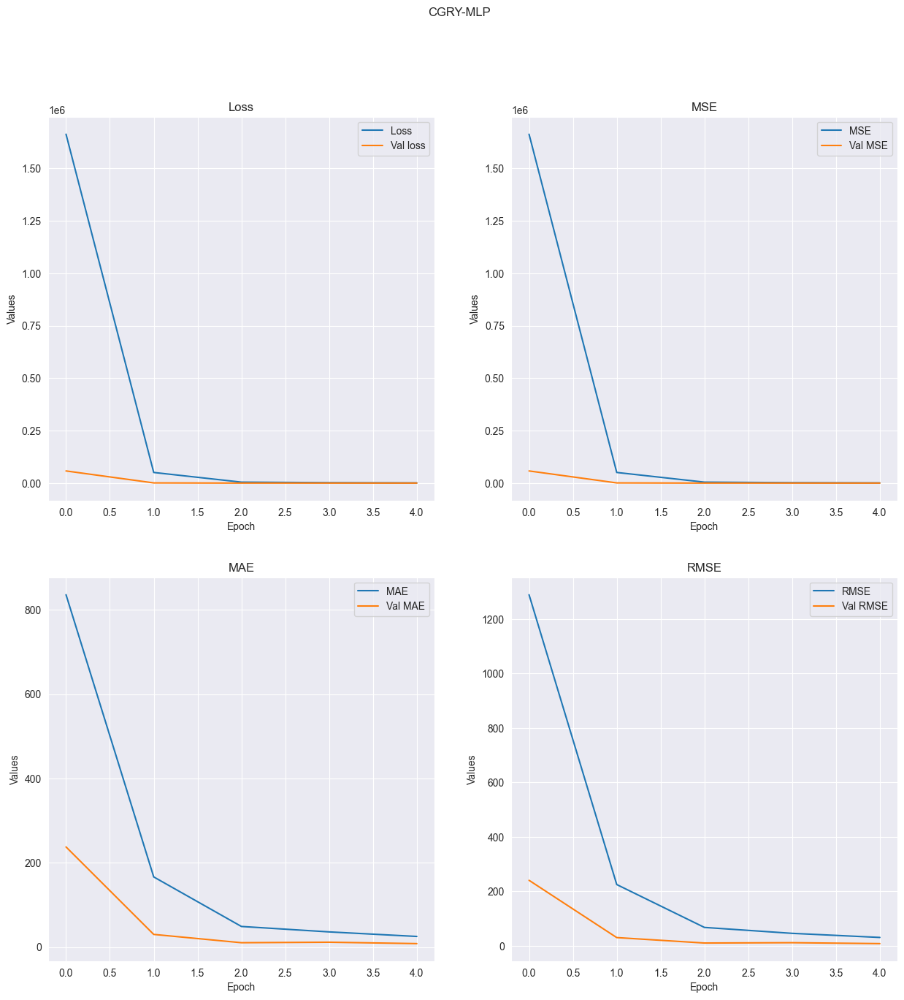

R-squared value: -122.9209


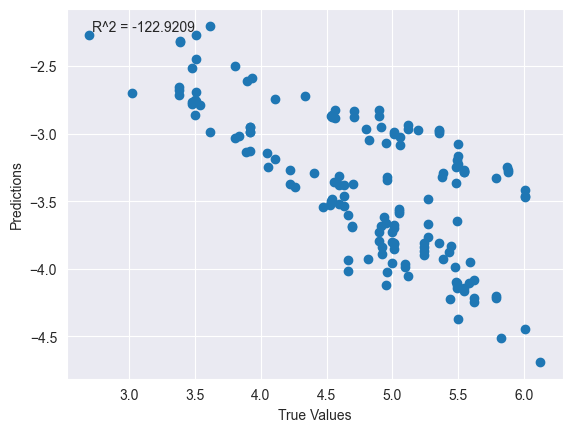

Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_372 (Dense)           (None, 64)                192       
                                                                 
 dropout_114 (Dropout)       (None, 64)                0         
                                                                 
 dense_373 (Dense)           (None, 32)                2080      
                                                                 
 dropout_115 (Dropout)       (None, 32)                0         
                                                                 
 dense_374 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:20.399078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 

2023-04-29 03:39:21.810632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 91ms/step - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 - val_loss: 166090.0469 - val_mse: 166090.0469 - val_mae: 389.9341 - val_root_mean_squared_error: 407.5415
Epoch 2/5
11/11 [==============================] - 0s 24ms/step - loss: 511054.8125 - mse: 511054.8125 - mae: 509.3962 - root_mean_squared_error: 714.8810 - val_loss: 57024.1289 - val_mse: 57024.1289 - val_mae: 228.5861 - val_root_mean_squared_error: 238.7973
Epoch 3/5
11/11 [==============================] - 0s 17ms/step - loss: 108829.0156 - mse: 108829.0156 - mae: 242.5318 - root_mean_squared_error: 329.8924 - val_loss: 6094.3706 - val_mse: 6094.3701 - val_mae: 74.8816 - val_root_mean_squared_error: 78.0664
Epoch 4/5
11/11 [==============================] - 0s 18ms/step - loss: 35150.0625 - mse: 35150.0625 - mae: 128.3465 - root_mean_squared_error: 187.4835 - val_loss: 115.6760 - val_mse: 115.6760 - val_mae: 10.3060 - val_root_mean

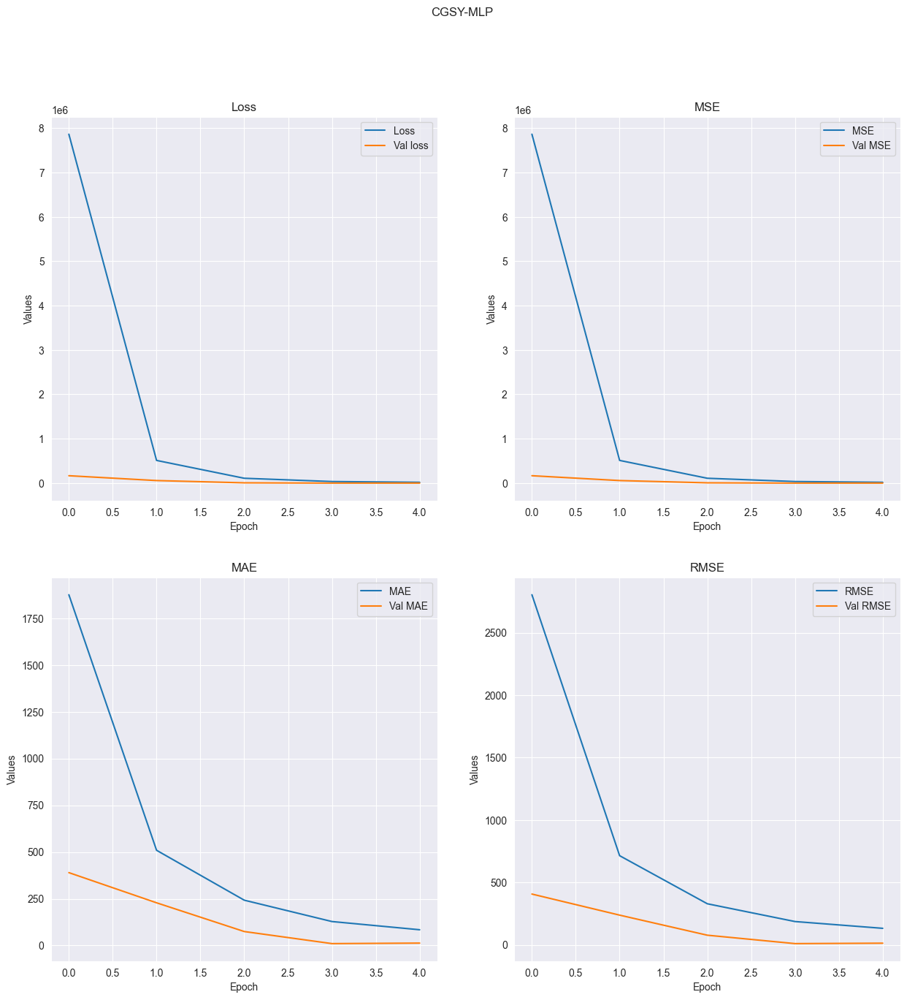

R-squared value: -0.7915


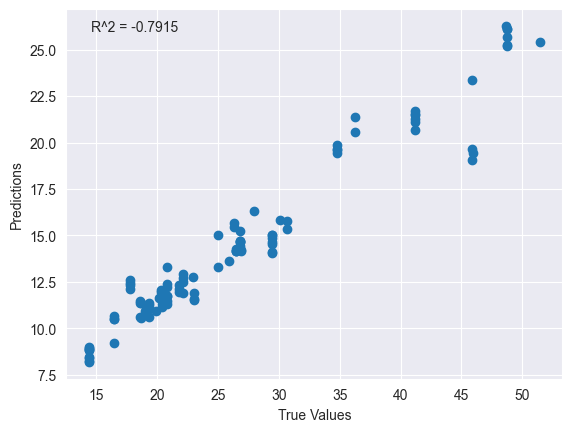

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_375 (Dense)           (None, 64)                192       
                                                                 
 dense_376 (Dense)           (None, 32)                2080      
                                                                 
 dense_377 (Dense)           (None, 16)                528       
                                                                 
 dense_378 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:23.873785: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986

2023-04-29 03:39:24.804380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 1s 56ms/step - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986 - val_loss: 555599.4375 - val_mse: 555599.4375 - val_mae: 735.9260 - val_root_mean_squared_error: 745.3854
Epoch 2/5
16/16 [==============================] - 0s 13ms/step - loss: 168030.3438 - mse: 168030.3438 - mae: 328.9428 - root_mean_squared_error: 409.9150 - val_loss: 46.6384 - val_mse: 46.6384 - val_mae: 6.6897 - val_root_mean_squared_error: 6.8292
Epoch 3/5
16/16 [==============================] - 0s 15ms/step - loss: 4408.6826 - mse: 4408.6826 - mae: 61.4353 - root_mean_squared_error: 66.3979 - val_loss: 6530.2080 - val_mse: 6530.2080 - val_mae: 79.7497 - val_root_mean_squared_error: 80.8097
Epoch 4/5
16/16 [==============================] - 0s 10ms/step - loss: 4162.0752 - mse: 4162.0752 - mae: 62.9008 - root_mean_squared_error: 64.5141 - val_loss: 1974.3805 - val_mse: 1974.3805 - val_mae: 43.8345 - val_root_mean_squared_error: 44

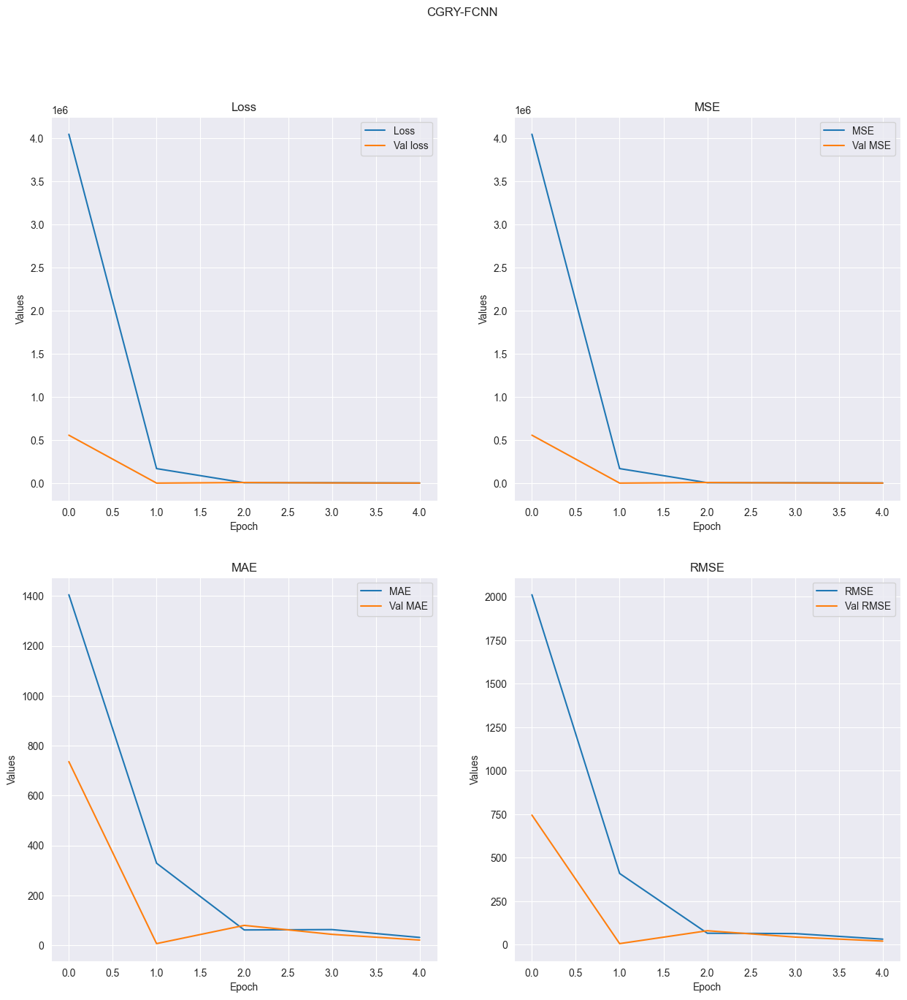

R-squared value: -738.7749


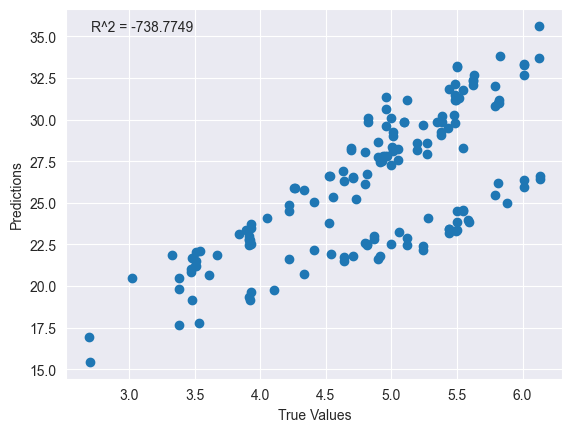

Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_379 (Dense)           (None, 64)                192       
                                                                 
 dense_380 (Dense)           (None, 32)                2080      
                                                                 
 dense_381 (Dense)           (None, 16)                528       
                                                                 
 dense_382 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:26.990116: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110

2023-04-29 03:39:28.050524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 93ms/step - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110 - val_loss: 729364.1250 - val_mse: 729364.1250 - val_mae: 819.8881 - val_root_mean_squared_error: 854.0282
Epoch 2/5
11/11 [==============================] - 0s 25ms/step - loss: 168845.9531 - mse: 168845.9531 - mae: 339.4226 - root_mean_squared_error: 410.9087 - val_loss: 94275.0938 - val_mse: 94275.0938 - val_mae: 294.4102 - val_root_mean_squared_error: 307.0425
Epoch 3/5
11/11 [==============================] - 0s 15ms/step - loss: 64092.6992 - mse: 64092.6992 - mae: 240.5644 - root_mean_squared_error: 253.1654 - val_loss: 26051.3789 - val_mse: 26051.3789 - val_mae: 154.6329 - val_root_mean_squared_error: 161.4044
Epoch 4/5
11/11 [==============================] - 0s 13ms/step - loss: 11585.3242 - mse: 11585.3242 - mae: 96.6171 - root_mean_squared_error: 107.6351 - val_loss: 786.8887 - val_mse: 786.8887 - val_mae: 26.5961 - val_root_m

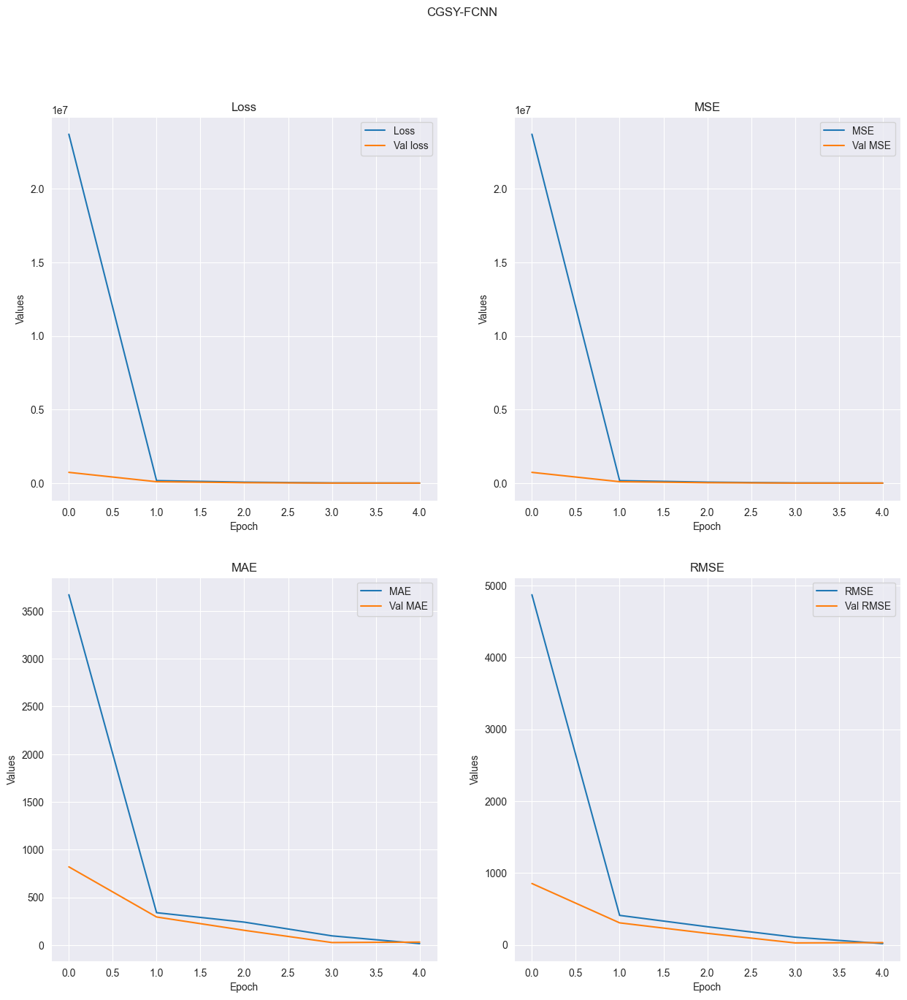

R-squared value: -14.0293


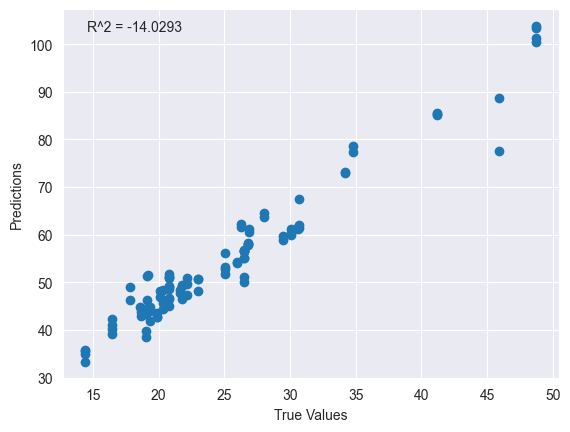

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_383 (Dense)           (None, 64)                128       
                                                                 
 dense_384 (Dense)           (None, 32)                2080      
                                                                 
 dense_385 (Dense)           (None, 16)                528       
                                                                 
 dense_386 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/50


2023-04-29 03:39:30.141956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521

2023-04-29 03:39:31.058009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 75ms/step - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521 - val_loss: 17714.7266 - val_mse: 17714.7266 - val_mae: 127.6721 - val_root_mean_squared_error: 133.0967
Epoch 2/50
11/11 [==============================] - 0s 17ms/step - loss: 932430.1250 - mse: 932430.1250 - mae: 873.2705 - root_mean_squared_error: 965.6242 - val_loss: 421392.2500 - val_mse: 421392.2500 - val_mae: 623.6829 - val_root_mean_squared_error: 649.1473
Epoch 3/50
11/11 [==============================] - 0s 18ms/step - loss: 122324.6250 - mse: 122324.6250 - mae: 275.8206 - root_mean_squared_error: 349.7494 - val_loss: 1564.3717 - val_mse: 1564.3717 - val_mae: 38.2025 - val_root_mean_squared_error: 39.5521
Epoch 4/50
11/11 [==============================] - 0s 16ms/step - loss: 17010.9688 - mse: 17010.9688 - mae: 118.5225 - root_mean_squared_error: 130.4261 - val_loss: 30145.5234 - val_mse: 30145.5234 - val_mae: 167.1085 - val

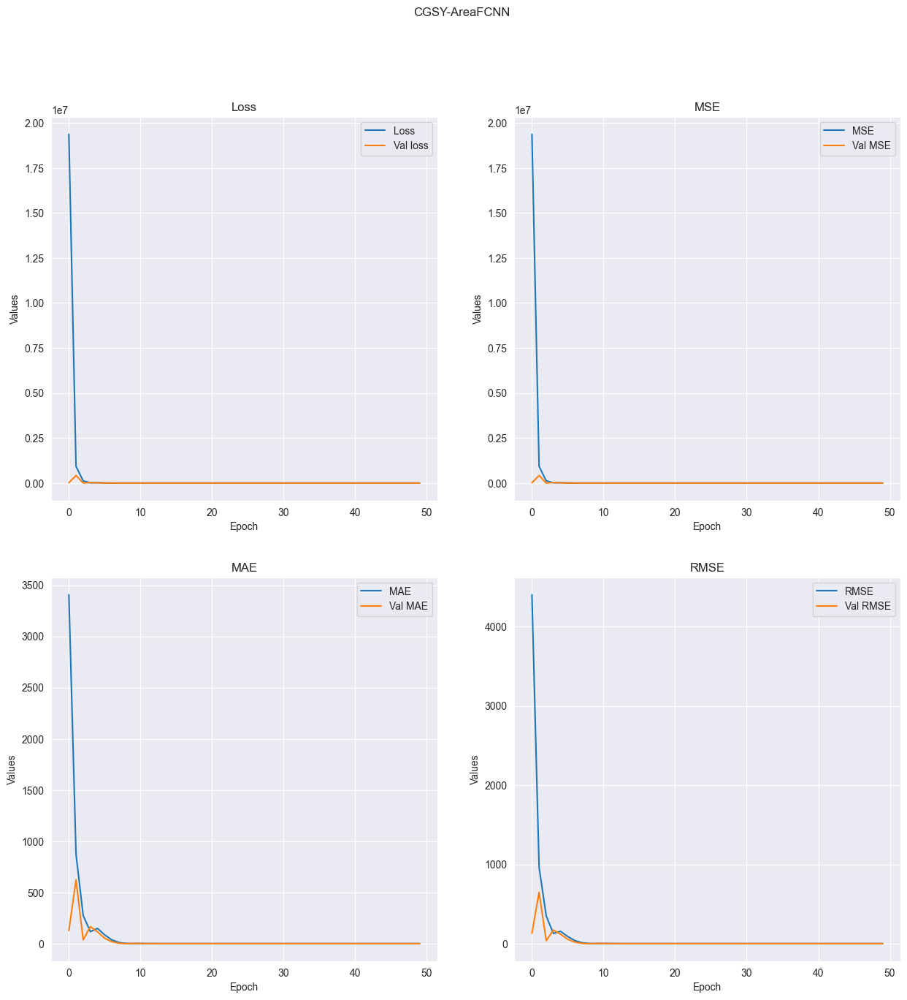

R-squared value: 0.9177


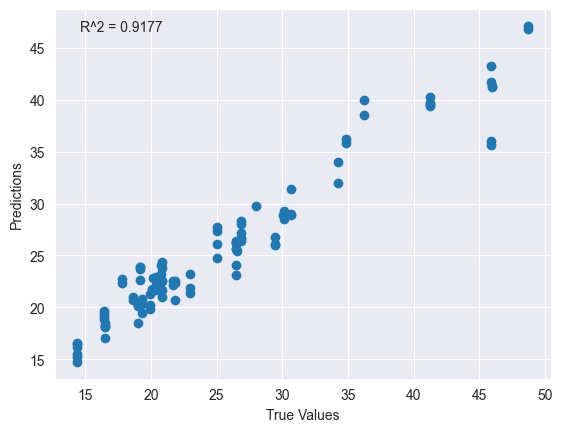

Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_387 (Dense)           (None, 64)                128       
                                                                 
 dense_388 (Dense)           (None, 32)                2080      
                                                                 
 dense_389 (Dense)           (None, 16)                528       
                                                                 
 dense_390 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/500


2023-04-29 03:39:38.776629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674

2023-04-29 03:39:39.795213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 77ms/step - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674 - val_loss: 210354.5625 - val_mse: 210354.5625 - val_mae: 439.0882 - val_root_mean_squared_error: 458.6443
Epoch 2/500
11/11 [==============================] - 0s 19ms/step - loss: 1217078.6250 - mse: 1217078.6250 - mae: 1023.1184 - root_mean_squared_error: 1103.2129 - val_loss: 458335.7188 - val_mse: 458335.7188 - val_mae: 648.2742 - val_root_mean_squared_error: 677.0049
Epoch 3/500
11/11 [==============================] - 0s 11ms/step - loss: 112703.7422 - mse: 112703.7422 - mae: 262.1600 - root_mean_squared_error: 335.7138 - val_loss: 812.6620 - val_mse: 812.6620 - val_mae: 27.4941 - val_root_mean_squared_error: 28.5072
Epoch 4/500
11/11 [==============================] - 0s 28ms/step - loss: 9231.3857 - mse: 9231.3857 - mae: 87.2979 - root_mean_squared_error: 96.0801 - val_loss: 18772.8359 - val_mse: 18772.8359 - val_mae: 131.5238 - 

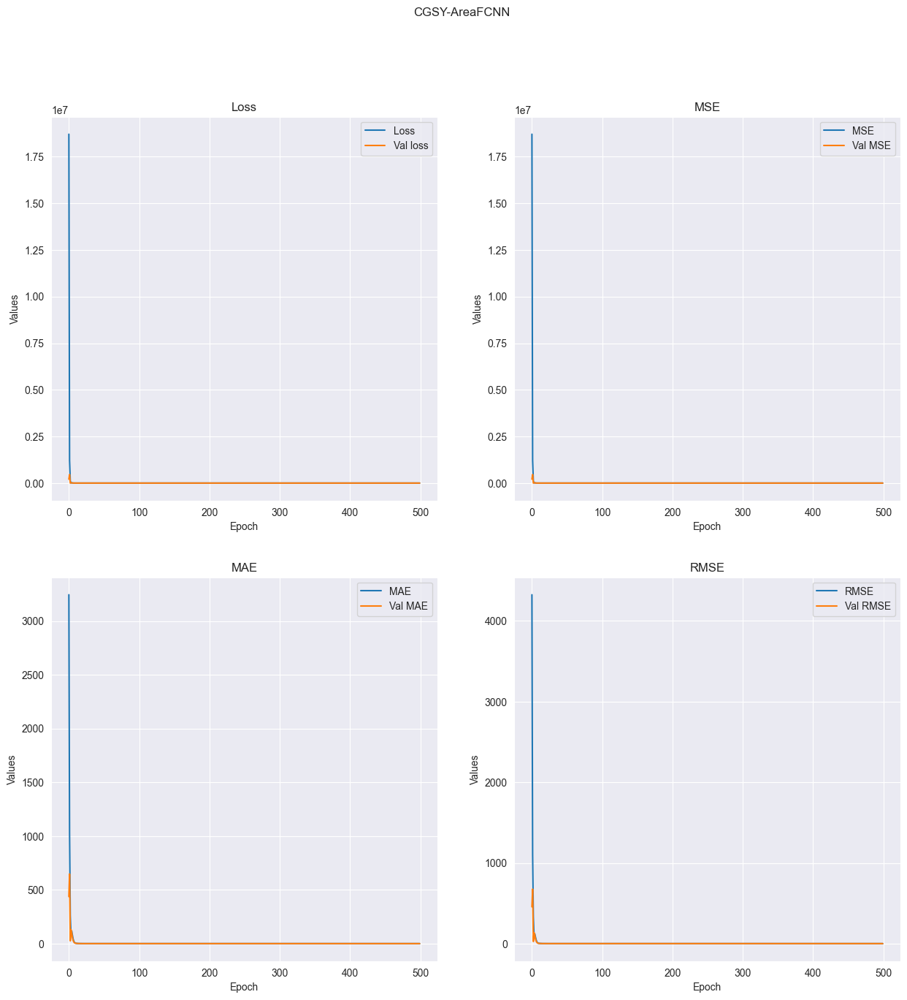

R-squared value: 0.8874


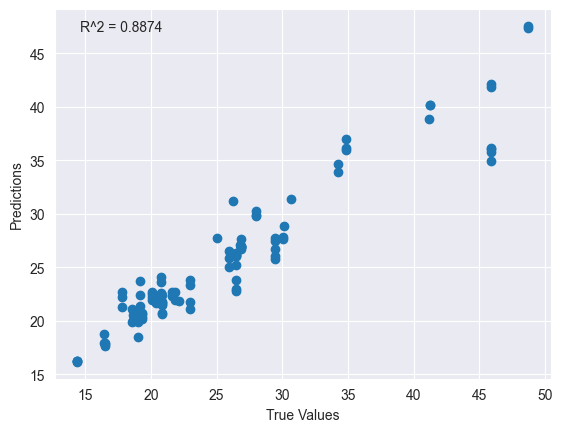

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_391 (Dense)           (None, 64)                128       
                                                                 
 dense_392 (Dense)           (None, 32)                2080      
                                                                 
 dense_393 (Dense)           (None, 16)                528       
                                                                 
 dense_394 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/2200


2023-04-29 03:40:37.817394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076

2023-04-29 03:40:38.868347: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 81ms/step - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076 - val_loss: 664391.3125 - val_mse: 664391.3125 - val_mae: 789.2724 - val_root_mean_squared_error: 815.1021
Epoch 2/2200
11/11 [==============================] - 0s 15ms/step - loss: 147479.4062 - mse: 147479.4062 - mae: 324.7747 - root_mean_squared_error: 384.0305 - val_loss: 90890.5234 - val_mse: 90890.5234 - val_mae: 291.6838 - val_root_mean_squared_error: 301.4806
Epoch 3/2200
11/11 [==============================] - 0s 15ms/step - loss: 62459.0117 - mse: 62459.0117 - mae: 238.3114 - root_mean_squared_error: 249.9180 - val_loss: 26080.6699 - val_mse: 26080.6699 - val_mae: 156.1575 - val_root_mean_squared_error: 161.4951
Epoch 4/2200
11/11 [==============================] - 0s 12ms/step - loss: 11361.0537 - mse: 11361.0537 - mae: 94.6271 - root_mean_squared_error: 106.5882 - val_loss: 620.5366 - val_mse: 620.5366 - val_mae: 23.8500 - v

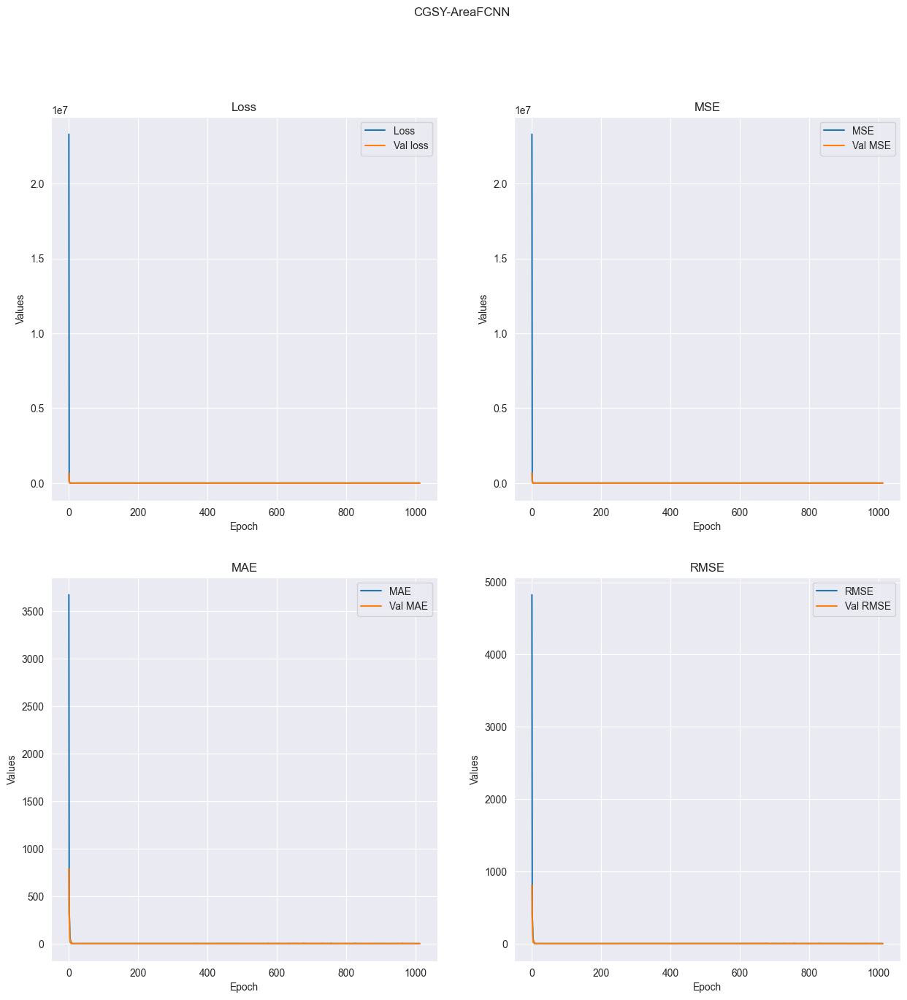

R-squared value: 0.9428


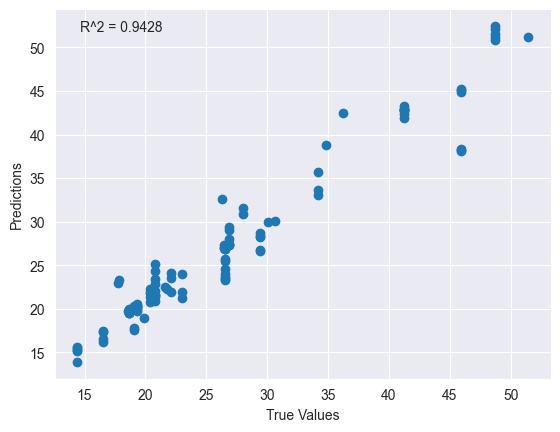

In [123]:

p3 = AutomaticLearning(pd.read_csv("classicgeometryRaspberriesRaw.csv").drop(["Roundness"], axis = 1), "CGRR-AreaLinear")
p3.buildData()
p3.buildModel("linear")
p3.train(2200)
p3.plot()

p1 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaLinear")
p1.buildData()
p1.buildModel("linear")
p1.train(2200)
p1.plot()

p2 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaLinear")
p2.buildData()
p2.buildModel("linear")
p2.train(2200)
p2.plot()


p4 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaSVR")
p4.buildData()
p4.buildModel("SVR")
p4.train(2200)
p4.plot()


p5 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-MLP")
p5.buildData()
p5.buildModel("MLP")
p5.train(5)
p5.plot()

p6 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-MLP")
p6.buildData()
p6.buildModel("MLP")
p6.train(5)
p6.plot()


p7 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-FCNN")
p7.buildData()
p7.buildModel("FCNN")
p7.train(5)
p7.plot()

p8 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-FCNN")
p8.buildData()
p8.buildModel("FCNN")
p8.train(5)
p8.plot()



p9 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p9.buildData()
p9.buildModel("FCNN")
p9.train(50)
p9.plot()


p10 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p10.buildData()
p10.buildModel("FCNN")
p10.train(500)
p10.plot()

p11 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p11.buildData()
p11.buildModel("FCNN")
p11.train(2200)
p11.plot()


